<a href="https://colab.research.google.com/github/DH-davidhuang/Generative-Adversarial-182-Networks-Research/blob/main/GAN_finetuning_pynb.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install torch torchvision


In [ ]:
!git clone https://github.com/NVlabs/stylegan2-ada-pytorch.git
%cd stylegan2-ada-pytorch


Cloning into 'stylegan2-ada-pytorch'...
remote: Enumerating objects: 131, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 131 (delta 0), reused 1 (delta 0), pack-reused 128
Receiving objects: 100% (131/131), 1.13 MiB | 3.31 MiB/s, done.
Resolving deltas: 100% (57/57), done.
/content/stylegan2-ada-pytorch


In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import torch
!pip install --upgrade torch torchvision


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 670.2/670.2 MB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 95.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 64.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 64.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 87.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 3.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 12.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 29.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 7.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 3.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 209.8/209.8 MB 4.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━

In [ ]:
!

In [ ]:
!git clone https://github.com/huggingface/pytorch-pretrained-BigGAN.git


Cloning into 'pytorch-pretrained-BigGAN'...
remote: Enumerating objects: 71, done.
remote: Total 71 (delta 0), reused 0 (delta 0), pack-reused 71
Receiving objects: 100% (71/71), 334.66 KiB | 1.75 MiB/s, done.
Resolving deltas: 100% (33/33), done.


In [ ]:
%cd pytorch-pretrained-BigGAN
!pip install -r full_requirements.txt

/content/stylegan2-ada-pytorch/pytorch-pretrained-BigGAN
  Preparing metadata (setup.py) ... done
  Created wheel for libsixel-python: filename=libsixel_python-0.5.0-py3-none-any.whl size=12264 sha256=a4c00990484ca496533af453d9dd24f07baeddf54d35fd4010357f83f987832d
  Stored in directory: /root/.cache/pip/wheels/ad/6c/7b/db813d9aa0922435dcf04438be690eb1363b354e3f83a8aa36
Successfully built libsixel-python


In [ ]:
!pip install nltk
import nltk


In [ ]:
nltk.download('wordnet')


[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [ ]:
!pip install libsixel-python
!pip install boto3


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.3/139.3 kB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 78.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.0/82.0 kB 11.8 MB/s eta 0:00:00


100%|██████████| 630/630 [00:00<00:00, 2311821.10B/s]


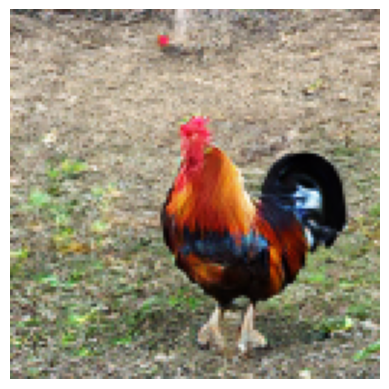

In [ ]:
import torch
from pytorch_pretrained_biggan import (BigGAN, one_hot_from_names, truncated_noise_sample,
                                       save_as_images, display_in_terminal)
import matplotlib.pyplot as plt
from PIL import Image

import logging
logging.basicConfig(level=logging.INFO)

model = BigGAN.from_pretrained('biggan-deep-128')


class_vector = one_hot_from_names(['bird'], batch_size=1)
noise_vector = truncated_noise_sample(truncation=0.4, batch_size=1)

noise_vector = torch.from_numpy(noise_vector)
class_vector = torch.from_numpy(class_vector)
output = model(noise_vector, class_vector, 0.4)

with torch.no_grad():
    output = model(noise_vector, class_vector, 0.4)

output = (output.cpu().squeeze(0) + 1) / 2
output = output.permute(1, 2, 0).numpy()

plt.imshow(output)
plt.axis('off')  # Turn off the axis
plt.show()


In [ ]:
model

BigGAN(
  (embeddings): Linear(in_features=1000, out_features=128, bias=False)
  (generator): Generator(
    (gen_z): Linear(in_features=256, out_features=32768, bias=True)
    (layers): ModuleList(
      (0-2): 3 x GenBlock(
        (bn_0): BigGANBatchNorm(
          (scale): Linear(in_features=256, out_features=2048, bias=False)
          (offset): Linear(in_features=256, out_features=2048, bias=False)
        )
        (conv_0): Conv2d(2048, 512, kernel_size=(1, 1), stride=(1, 1))
        (bn_1): BigGANBatchNorm(
          (scale): Linear(in_features=256, out_features=512, bias=False)
          (offset): Linear(in_features=256, out_features=512, bias=False)
        )
        (conv_1): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (bn_2): BigGANBatchNorm(
          (scale): Linear(in_features=256, out_features=512, bias=False)
          (offset): Linear(in_features=256, out_features=512, bias=False)
        )
        (conv_2): Conv2d(512, 512, kernel_siz

In [ ]:
model.generator()

TypeError: ignored

In [ ]:
model = BigGAN.from_pretrained('biggan-deep-128')


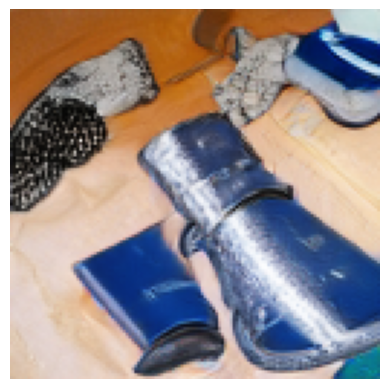

In [ ]:
import torch
import torch.nn as nn

class ModifiedBigGAN(nn.Module):
    def __init__(self, original_model, new_classes=1):
        super(ModifiedBigGAN, self).__init__()
        self.generator = original_model.generator

        # Expand the embeddings layer for new classes (e.g., "anime")
        self.embeddings = nn.Linear(1000 + new_classes, 128, bias=False)

        # Initialize weights for existing classes
        self.embeddings.weight.data[:, :1000] = original_model.embeddings.weight.data

        # Initialize weights for new classes (e.g., "anime")
        nn.init.normal_(self.embeddings.weight.data[:, 1000:], mean=0.0, std=0.02)

    def forward(self, noise, class_vector, truncation=1.0):
        class_embedding = self.embeddings(class_vector)
        noise = noise[:, :128]

        combined_input = torch.cat([noise, class_embedding], dim=1)

        return self.generator(combined_input, truncation)

original_model = model # Load your pre-trained BigGAN model
modified_model = ModifiedBigGAN(original_model)

# Generate noise
noise_dim = 256
noise = torch.randn(1, noise_dim)

# Create class vector for "anime" class
anime_class_index = 1000
class_vector = torch.zeros(1, 1001)
class_vector[0, anime_class_index] = 1

truncation = 0.4
with torch.no_grad():
  fake_images = modified_model(noise, class_vector, truncation)
fake_images = (fake_images.cpu().squeeze(0) + 1) / 2
fake_images = fake_images.permute(1, 2, 0).numpy()

plt.imshow(fake_images)
plt.axis('off')
plt.show()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

%cd /content/drive/MyDrive/CS182-Research/

!kaggle datasets download -d splcher/animefacedataset


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/MyDrive/CS182-Research
Traceback (most recent call last):
  File "/usr/local/bin/kaggle", line 5, in <module>
    from kaggle.cli import main
  File "/usr/local/lib/python3.10/dist-packages/kaggle/__init__.py", line 23, in <module>
    api.authenticate()
  File "/usr/local/lib/python3.10/dist-packages/kaggle/api/kaggle_api_extended.py", line 403, in authenticate
    raise IOError('Could not find {}. Make sure it\'s located in'
OSError: Could not find kaggle.json. Make sure it's located in /root/.kaggle. Or use the environment method.


In [ ]:
!unzip animefacedataset.zip


Archive:  animefacedataset.zip
replace images/0_2000.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os

directory = '/content/drive/MyDrive/CS182-Research/images'
if not os.path.exists(directory):
    print(f"The directory '{directory}' does not exist.")


In [ ]:
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import os

class AnimeFaceTestDataset(Dataset):
    def __init__(self, directory, num_images=None, transform=None):
        self.directory = directory
        self.transform = transform
        self.images = os.listdir(directory)
        if num_images is not None:
            self.images = self.images[:num_images]

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_name = os.path.join(self.directory, self.images[idx])
        image = Image.open(img_name)
        if self.transform:
            image = self.transform(image)
        return image

test_transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor(),
])

num_test_images = 200
test_dataset = AnimeFaceTestDataset(directory='/content/drive/MyDrive/CS182-Research/images', num_images=num_test_images, transform=test_transform)

test_dataloader = DataLoader(test_dataset, batch_size=16, shuffle=False)  # No need to shuffle for testing


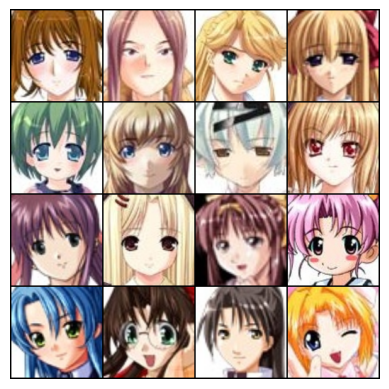

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import torchvision


batch = next(iter(dataloader))

def imshow(img):
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.axis('off')
    plt.show()

imshow(torchvision.utils.make_grid(batch, nrow=4))


In [ ]:
import torch
import torch.nn as nn

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(3, 64, 4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 256, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(256, 512, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(512, 1024, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.2, inplace=True),
        )
        self.fc = nn.Sequential(
            nn.Linear(4 * 4 * 1024, 1),
            nn.Sigmoid()
        )

    def forward(self, input):
        x = self.main(input)
        x = x.view(x.size(0), -1)  # Flatten the output
        x = self.fc(x)
        return x

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
discriminator = Discriminator().to(device)


In [ ]:
discriminator.to(device)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): BatchNorm2d(1024, eps=1e-05

In [ ]:
modified_model = modified_model.to(device)

In [ ]:

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


In [ ]:
import torch
torch.cuda.empty_cache()

In [ ]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision.utils import save_image
import matplotlib.pyplot as plt
import numpy as np
import os
import torchvision.utils as vutils

def save_generated_images(generator, epoch, batch_size, z_dim, device, save_dir):
    noise = torch.randn(batch_size, z_dim, device=device)
    class_vector = torch.zeros(batch_size, 1001, device=device)
    class_vector[:, anime_class_index] = 1  # Set "anime" class to 1

    fake_images = generator(noise, class_vector, truncation)

    fake_images_grid = vutils.make_grid(fake_images, nrow=8, padding=2, normalize=True)

    save_path = os.path.join(save_dir, f'generated_images_epoch_{epoch}.png')
    vutils.save_image(fake_images_grid, save_path)

save_dir = '/content/drive/MyDrive/CS182-Research/bigGAN/generated-images'
os.makedirs(save_dir, exist_ok=True)



Pretrain [0/3][0/63] Loss_D: 0.0000 D(x): 1.0000 D(G(z)): 0.0000


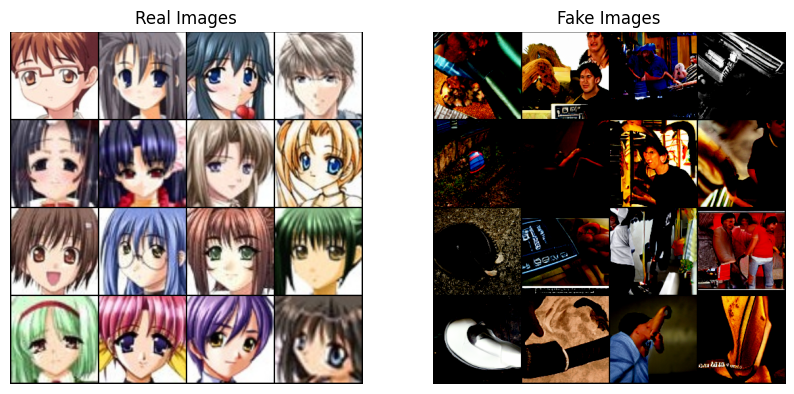

Pretrain [0/3][50/63] Loss_D: 0.0000 D(x): 1.0000 D(G(z)): 0.0000


Pretrain [1/3][0/63] Loss_D: 0.0000 D(x): 1.0000 D(G(z)): 0.0000


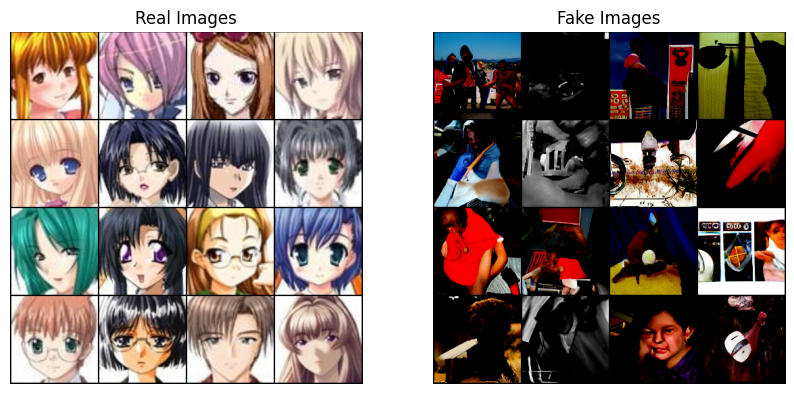

Pretrain [1/3][50/63] Loss_D: 0.0000 D(x): 1.0000 D(G(z)): 0.0000


Pretrain [2/3][0/63] Loss_D: 0.0000 D(x): 1.0000 D(G(z)): 0.0000


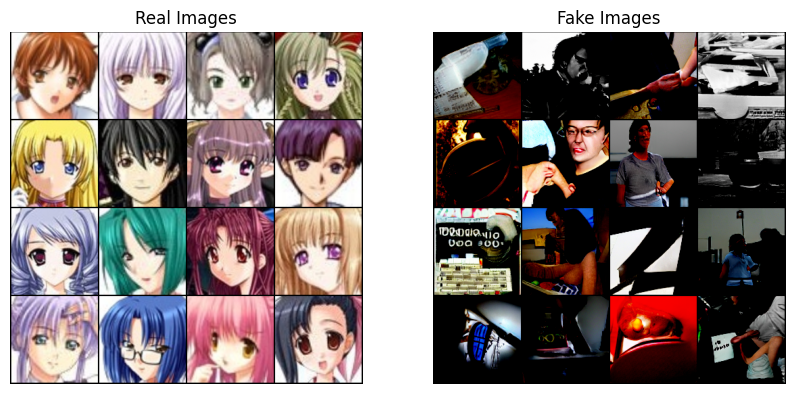

Pretrain [2/3][50/63] Loss_D: 0.0000 D(x): 1.0000 D(G(z)): 0.0000
torch.Size([16, 256])
torch.Size([16, 3, 128, 128])
[0/5][0/63] Loss_D: 0.0000 Loss_G: 30.0218 D(x): 1.0000 D(G(z)): 0.0000/0.0000
[0/5] Loss_D: 0.0000 Loss_G: 30.0218
torch.Size([16, 256])
torch.Size([16, 3, 128, 128])
[0/5] Loss_D: 0.0000 Loss_G: 31.4528
torch.Size([16, 256])
torch.Size([16, 3, 128, 128])
[0/5] Loss_D: 0.0000 Loss_G: 29.9629
torch.Size([16, 256])
torch.Size([16, 3, 128, 128])
[0/5] Loss_D: 0.0000 Loss_G: 29.2339
torch.Size([16, 256])
torch.Size([16, 3, 128, 128])
[0/5] Loss_D: 0.0000 Loss_G: 29.8235
torch.Size([16, 256])
torch.Size([16, 3, 128, 128])
[0/5] Loss_D: 0.0000 Loss_G: 30.8307
torch.Size([16, 256])
torch.Size([16, 3, 128, 128])
[0/5] Loss_D: 0.0000 Loss_G: 28.2113
torch.Size([16, 256])
torch.Size([16, 3, 128, 128])
[0/5] Loss_D: 0.0000 Loss_G: 30.0121
torch.Size([16, 256])
torch.Size([16, 3, 128, 128])
[0/5] Loss_D: 0.0000 Loss_G: 29.4363
torch.Size([16, 256])
torch.Size([16, 3, 128, 128])
[0

In [ ]:
from torch.optim import lr_scheduler

import torch
torch.cuda.empty_cache()
# Freeze all layers in the generator except for the first embedding layer
for param in modified_model.generator.parameters():
    param.requires_grad = False


for layer in modified_model.generator.layers[-3:]:
    for param in layer.parameters():
        param.requires_grad = True


d_losses = []
g_losses = []
# Loss function
criterion = nn.BCELoss()

optimizer_g = torch.optim.Adam(filter(lambda p: p.requires_grad, modified_model.parameters()), lr=0.0002, betas=(0.5, 0.999))
optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
# Define the learning rate scheduler for the generator and discriminator optimizers
#scheduler_g = lr_scheduler.StepLR(optimizer_g, step_size=1, gamma=0.5)
#scheduler_d = lr_scheduler.StepLR(optimizer_d, step_size=1, gamma=0.5)

real_label = 1
fake_label = 0

# Initial Training of Discriminator
num_pretrain_epochs = 3

for pretrain_epoch in range(num_pretrain_epochs):
    for i, real_images in enumerate(dataloader):
        discriminator.zero_grad()

        real_images = real_images.to(device)
        b_size = real_images.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)

        output = discriminator(real_images).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        noise = torch.randn(b_size, noise_dim, device=device)
        class_vector = torch.zeros(b_size, 1001, device=device)
        class_vector[:, anime_class_index] = 1
        fake_images = modified_model(noise, class_vector, truncation).detach()
        label.fill_(fake_label)

        output = discriminator(fake_images).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()

        errD = errD_real + errD_fake
        optimizer_d.step()

        if i % 50 == 0:
            print(f'Pretrain [{pretrain_epoch}/{num_pretrain_epochs}][{i}/{len(dataloader)}] '
                  f'Loss_D: {errD.item():.4f} D(x): {D_x:.4f} D(G(z)): {D_G_z1:.4f}')

        if i % 500 == 0:
            real_images_grid = torchvision.utils.make_grid(real_images, nrow=4)
            fake_images_grid = torchvision.utils.make_grid(fake_images, nrow=4)

            # Plot real images
            plt.figure(figsize=(10, 5))
            plt.subplot(1, 2, 1)
            plt.title("Real Images")
            plt.imshow(np.transpose(real_images_grid.cpu().numpy(), (1, 2, 0)))
            plt.axis('off')

            # Plot fake images
            plt.subplot(1, 2, 2)
            plt.title("Fake Images")
            plt.imshow(np.transpose(fake_images_grid.cpu().numpy(), (1, 2, 0)))
            plt.axis('off')

            plt.show()


num_epochs = 5  # Adjust as needed

for epoch in range(num_epochs):
    for i, real_images in enumerate(dataloader):
        # ---------------------
        # Train Discriminator
        # ---------------------
        discriminator.zero_grad()

        # Train with real images
        real_images = real_images.to(device)
        b_size = real_images.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)


        output = discriminator(real_images).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        # Train with fake images
        noise = torch.randn(b_size, noise_dim, device=device)
        print(noise.shape)
        class_vector = torch.zeros(b_size, 1001, device=device)
        class_vector[:, anime_class_index] = 1
        fake_images = modified_model(noise, class_vector, truncation).detach()
        label.fill_(fake_label)
        print(fake_images.shape)

        output = discriminator(fake_images).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()

        errD = errD_real + errD_fake
        optimizer_d.step()

        # ---------------------
        # Train Generator
        # ---------------------
        modified_model.zero_grad()
        label.fill_(real_label)  # Fake labels are real for generator cost

        output = discriminator(fake_images).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()

        optimizer_g.step()

        # Print statistics
        if i % 50 == 0:
            print(f'[{epoch}/{num_epochs}][{i}/{len(dataloader)}] '
                  f'Loss_D: {errD.item():.4f} Loss_G: {errG.item():.4f} '
                  f'D(x): {D_x:.4f} D(G(z)): {D_G_z1:.4f}/{D_G_z2:.4f}')
        if i == len(dataloader) - 1:
            save_generated_images(modified_model, epoch, 16, noise_dim, device, save_dir)

        d_losses.append(errD.item())
        g_losses.append(errG.item())

        if epoch % 1 == 0:
            print(f'[{epoch}/{num_epochs}] Loss_D: {errD.item():.4f} Loss_G: {errG.item():.4f}')
            np.savez(os.path.join(save_dir, 'losses.npz'), d_losses=d_losses, g_losses=g_losses)

torch.save(modified_model.state_dict(), '/content/drive/MyDrive/CS182-Research/modified_biggan.pth')
torch.save(discriminator.state_dict(), '/content/drive/MyDrive/CS182-Research/discriminator.pth')



In [ ]:
import torch
import os
import torchvision.utils
import numpy as np
import matplotlib.pyplot as plt
import torch.nn as nn

class Discriminator(nn.Module):
    def __init__(self,inchannels):
        super(Discriminator,self).__init__()
        """
        Initialize the Discriminator Module
        :param inchannels: The depth of the first convolutional layer
        """
        self.conv_block1 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace = True),
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace = True),
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace = True),
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace = True),
            nn.Conv2d(in_channels=512, out_channels=1, kernel_size=4, stride=2, padding=0),
            nn.Flatten(),
            nn.Sigmoid()
        )

    def forward(self,x):
        """
        Forward propagation of the neural network
        :param x: The input to the neural network
        :return: Discriminator logits; the output of the neural network
        """
        x = self.conv_block1(x)
        return x

In [ ]:
if torch.cuda.is_available():
    device=torch.device('cuda')
else:
    device=torch.device('cpu')

In [ ]:
import torch

discriminator = Discriminator(3).to(device)

weights_path = '/content/drive/MyDrive/CS182-Research/Good Models/toy-models/discriminator-toy-naive.pth'

checkpoint = torch.load(weights_path, map_location='cuda' if torch.cuda.is_available() else 'cpu')
discriminator.load_state_dict(checkpoint)


discriminator.train()


Discriminator(
  (conv_block1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2, inplace=True)
    (12): Conv2d(512, 1, kernel_size=(4, 4), stride=(2, 2))
    (13): Flatten(s

In [ ]:
discriminator.to(device)

Discriminator(
  (conv_block1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2, inplace=True)
    (12): Conv2d(512, 1, kernel_size=(4, 4), stride=(2, 2))
    (13): Flatten(s

In [ ]:
import torch

generator_weights_path = '/content/drive/MyDrive/CS182-Research/bigGAN/modified_biggan.pth'

generator = modified_model

checkpoint = torch.load(generator_weights_path, map_location='cuda' if torch.cuda.is_available() else 'cpu')
generator.load_state_dict(checkpoint)

generator.train()



ModifiedBigGAN(
  (generator): Generator(
    (gen_z): Linear(in_features=256, out_features=32768, bias=True)
    (layers): ModuleList(
      (0-2): 3 x GenBlock(
        (bn_0): BigGANBatchNorm(
          (scale): Linear(in_features=256, out_features=2048, bias=False)
          (offset): Linear(in_features=256, out_features=2048, bias=False)
        )
        (conv_0): Conv2d(2048, 512, kernel_size=(1, 1), stride=(1, 1))
        (bn_1): BigGANBatchNorm(
          (scale): Linear(in_features=256, out_features=512, bias=False)
          (offset): Linear(in_features=256, out_features=512, bias=False)
        )
        (conv_1): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (bn_2): BigGANBatchNorm(
          (scale): Linear(in_features=256, out_features=512, bias=False)
          (offset): Linear(in_features=256, out_features=512, bias=False)
        )
        (conv_2): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (bn_3): BigGAN

In [ ]:
generator.to(device)

ModifiedBigGAN(
  (generator): Generator(
    (gen_z): Linear(in_features=256, out_features=32768, bias=True)
    (layers): ModuleList(
      (0-2): 3 x GenBlock(
        (bn_0): BigGANBatchNorm(
          (scale): Linear(in_features=256, out_features=2048, bias=False)
          (offset): Linear(in_features=256, out_features=2048, bias=False)
        )
        (conv_0): Conv2d(2048, 512, kernel_size=(1, 1), stride=(1, 1))
        (bn_1): BigGANBatchNorm(
          (scale): Linear(in_features=256, out_features=512, bias=False)
          (offset): Linear(in_features=256, out_features=512, bias=False)
        )
        (conv_1): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (bn_2): BigGANBatchNorm(
          (scale): Linear(in_features=256, out_features=512, bias=False)
          (offset): Linear(in_features=256, out_features=512, bias=False)
        )
        (conv_2): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (bn_3): BigGAN

In [ ]:
import torch
import os
import torchvision.utils
import numpy as np
import matplotlib.pyplot as plt

# Freeze all layers in the generator except for the first embedding layer
for param in generator.parameters():
    param.requires_grad = False

# Unfreeze the last three layers of the generator
for layer in generator.generator.layers[-3:]:
    for param in layer.parameters():
        param.requires_grad = True

d_losses = []
g_losses = []
criterion = nn.BCELoss()

optimizer_g = torch.optim.Adam(filter(lambda p: p.requires_grad, generator.parameters()), lr=0.02, betas=(0.5, 0.999))
optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=0.02, betas=(0.5, 0.999))

num_epochs = 30
real_label = 1
fake_label = 0


save_dir = '/content/drive/MyDrive/CS182-Research/bigGAN'
os.makedirs(save_dir, exist_ok=True)

for epoch in range(num_epochs):
    for i, real_images in enumerate(dataloader):
        # ---------------------
        # Train Discriminator
        # ---------------------
        discriminator.zero_grad()

        real_images = real_images.to(device)
        b_size = real_images.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)

        output = torch.mean(discriminator(real_images), dim=1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        noise = torch.randn(b_size, noise_dim, device=device)
        class_vector = torch.zeros(b_size, 1001, device=device)
        class_vector[:, anime_class_index] = 1
        fake_images = generator(noise, class_vector, truncation).detach()
        label.fill_(fake_label)

        output = torch.mean(discriminator(fake_images), dim=1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()

        errD = errD_real + errD_fake
        optimizer_d.step()

        # ---------------------
        # Train Generator
        # ---------------------
        generator.zero_grad()
        label.fill_(real_label)

        output = torch.mean(discriminator(fake_images), dim=1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()

        optimizer_g.step()

        if i % 50 == 0:
            print(f'[{epoch}/{num_epochs}][{i}/{len(dataloader)}] '
                  f'Loss_D: {errD.item():.4f} Loss_G: {errG.item():.4f} '
                  f'D(x): {D_x:.4f} D(G(z)): {D_G_z1:.4f}/{D_G_z2:.4f}')
        if i == len(dataloader) - 1:
            save_generated_images(generator, epoch, 16, noise_dim, device, save_dir)

        d_losses.append(errD.item())
        g_losses.append(errG.item())

        if epoch % 1 == 0:
            print(f'[{epoch}/{num_epochs}] Loss_D: {errD.item():.4f} Loss_G: {errG.item():.4f}')
            np.savez(os.path.join(save_dir, 'losses.npz'), d_losses=d_losses, g_losses=g_losses)

torch.save(discriminator.state_dict(), '/content/drive/MyDrive/CS182-Research/biggan-toy-discriminator.pth')
torch.save(generator.state_dict(), '/content/drive/MyDrive/CS182-Research/biggan-toy-generator.pth')


[0/30][0/63] Loss_D: 1.4461 Loss_G: 16.2828 D(x): 0.6783 D(G(z)): 0.6365/0.0000
[0/30] Loss_D: 1.4461 Loss_G: 16.2828
[0/30] Loss_D: 18.6565 Loss_G: 5.7421
[0/30] Loss_D: 3.0280 Loss_G: 0.6122
[0/30] Loss_D: 1.9417 Loss_G: 0.7677
[0/30] Loss_D: 2.1571 Loss_G: 1.6644
[0/30] Loss_D: 1.2642 Loss_G: 1.1662
[0/30] Loss_D: 1.1377 Loss_G: 2.0303
[0/30] Loss_D: 1.1415 Loss_G: 1.6756
[0/30] Loss_D: 7.8516 Loss_G: 1.1149
[0/30] Loss_D: 1.0866 Loss_G: 0.9902
[0/30] Loss_D: 1.3552 Loss_G: 0.9061
[0/30] Loss_D: 1.3118 Loss_G: 1.0234
[0/30] Loss_D: 1.2828 Loss_G: 0.7965
[0/30] Loss_D: 1.2571 Loss_G: 0.8699
[0/30] Loss_D: 1.3193 Loss_G: 0.9709
[0/30] Loss_D: 1.2313 Loss_G: 1.0961
[0/30] Loss_D: 1.3206 Loss_G: 1.0440
[0/30] Loss_D: 1.1216 Loss_G: 1.2122
[0/30] Loss_D: 1.2157 Loss_G: 1.7480
[0/30] Loss_D: 1.1892 Loss_G: 1.7703
[0/30] Loss_D: 1.1799 Loss_G: 1.6897
[0/30] Loss_D: 0.9148 Loss_G: 2.5488
[0/30] Loss_D: 1.1764 Loss_G: 1.4164
[0/30] Loss_D: 1.0765 Loss_G: 1.8776
[0/30] Loss_D: 0.9154 Loss_G: 

In [ ]:
import torch
import torch.nn as nn
from torchvision import transforms
from torch.utils.data import DataLoader
from PIL import Image
import torch

generator_weights_path = '/content/drive/MyDrive/CS182-Research/biggan-toy-generator.pth'

generator = modified_model

checkpoint = torch.load(generator_weights_path, map_location='cuda' if torch.cuda.is_available() else 'cpu')
generator.load_state_dict(checkpoint)

generator.eval()

import torch

discriminator_weights_path = '/content/drive/MyDrive/CS182-Research/bigGAN/frozen-discriminator-weights/biggan-toy-discriminator.pth'

discriminator = Discriminator(3).to(device)

checkpoint = torch.load(discriminator_weights_path, map_location='cuda' if torch.cuda.is_available() else 'cpu')
discriminator.load_state_dict(checkpoint)

discriminator.eval()


test_transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor(),
])

criterion = nn.BCELoss()

correct_predictions = 0
total_predictions = 0

for batch_real in test_dataloader:
    batch_real = batch_real.to(device)

    with torch.no_grad():
        outputs_real = torch.mean(discriminator(batch_real), dim=1)

    predicted_labels_real = (outputs_real > 0.5).float()
    true_labels_real = torch.ones_like(predicted_labels_real)
    correct_predictions += (predicted_labels_real == true_labels_real).sum().item()
    total_predictions += batch_real.size(0)

    noise = torch.randn(batch_real.size(0), noise_dim, device=device)
    class_vector = torch.zeros(batch_real.size(0), 1001, device=device)
    class_vector[:, anime_class_index] = 1
    batch_fake = generator(noise, class_vector, truncation)

    with torch.no_grad():
        outputs_fake = torch.mean(discriminator(batch_fake), dim=1)

    predicted_labels_fake = (outputs_fake <= 0.5).float()
    true_labels_fake = torch.zeros_like(predicted_labels_fake)
    correct_predictions += (predicted_labels_fake == true_labels_fake).sum().item()
    total_predictions += batch_fake.size(0)

accuracy = correct_predictions / total_predictions
print(f"Accuracy: {accuracy * 100:.2f}%")


Accuracy: 72.00%


In [ ]:
import torch
import torch.nn as nn
from torchvision import transforms
from torch.utils.data import DataLoader
from PIL import Image
import torch

generator_weights_path = '/content/drive/MyDrive/CS182-Research/biggan-toy-generator.pth'

generator = modified_model

checkpoint = torch.load(generator_weights_path, map_location='cuda' if torch.cuda.is_available() else 'cpu')
generator.load_state_dict(checkpoint)

generator.eval()

import torch

discriminator_weights_path = '/content/drive/MyDrive/CS182-Research/biggan-toy-discriminator.pth'

discriminator = Discriminator(3).to(device) # Replace with the actual class of your generator model

checkpoint = torch.load(discriminator_weights_path, map_location='cuda' if torch.cuda.is_available() else 'cpu')
discriminator.load_state_dict(checkpoint)

discriminator.eval()


test_transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor(),
])

criterion = nn.BCELoss()

correct_predictions = 0
total_predictions = 0

for batch_real in test_dataloader:
    batch_real = batch_real.to(device)

    with torch.no_grad():
        outputs_real = torch.mean(discriminator(batch_real), dim=1)

    # Calculate the accuracy for real images
    predicted_labels_real = (outputs_real > 0.5).float()
    true_labels_real = torch.ones_like(predicted_labels_real)
    correct_predictions += (predicted_labels_real == true_labels_real).sum().item()
    total_predictions += batch_real.size(0)

    # Generate fake images using the generator
    noise = torch.randn(batch_real.size(0), noise_dim, device=device)
    class_vector = torch.zeros(batch_real.size(0), 1001, device=device)
    class_vector[:, anime_class_index] = 1
    batch_fake = generator(noise, class_vector, truncation)

    # Forward pass through the discriminator for generated (fake) images
    with torch.no_grad():
        outputs_fake = torch.mean(discriminator(batch_fake), dim=1)

    # Calculate the accuracy for fake images
    predicted_labels_fake = (outputs_fake <= 0.5).float()
    true_labels_fake = torch.zeros_like(predicted_labels_fake)
    correct_predictions += (predicted_labels_fake == true_labels_fake).sum().item()
    total_predictions += batch_fake.size(0)

accuracy = correct_predictions / total_predictions
print(f"Accuracy: {accuracy * 100:.2f}%")


Accuracy: 7.25%


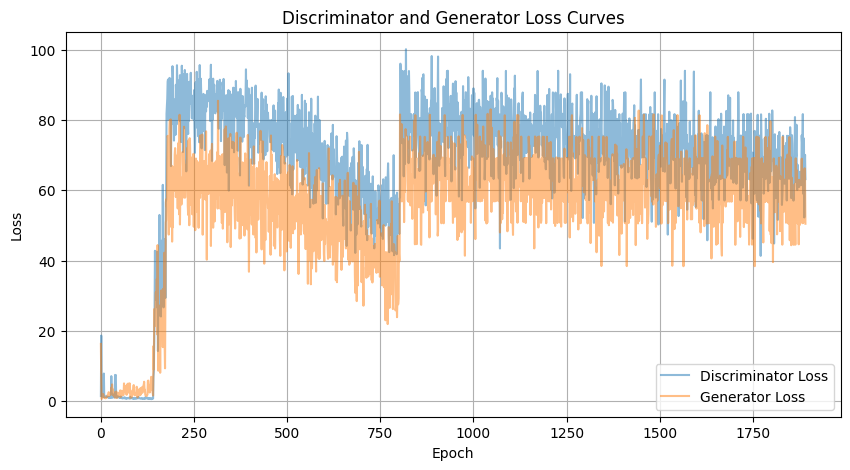

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Load the saved losses
losses = np.load('/content/drive/MyDrive/CS182-Research/bigGAN/generated-images/losses.npz')
d_losses = losses['d_losses']
g_losses = losses['g_losses']

epochs = range(1, len(d_losses) + 1)

plt.figure(figsize=(10, 5))
plt.plot(epochs, d_losses, label='Discriminator Loss', alpha=0.5)
plt.plot(epochs, g_losses, label='Generator Loss', alpha=0.5)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Discriminator and Generator Loss Curves')
plt.legend()
plt.grid(True)

plt.savefig('/content/drive/MyDrive/CS182-Research/bigGAN/generated-images/loss_curves.png')
plt.show()


In [ ]:
torch.mean(discriminator(fake_images), dim=1).shape

torch.Size([8])

In [ ]:
import torch
import os
import torchvision.utils
import numpy as np
import matplotlib.pyplot as plt

for param in generator.parameters():
    param.requires_grad = True

for param in discriminator.parameters():
    param.requires_grad = False

for param in discriminator.parameters():
    param.requires_grad = False

d_losses = []
g_losses = []

criterion = nn.BCELoss()

optimizer_g = torch.optim.Adam(filter(lambda p: p.requires_grad, generator.parameters()), lr=0.0002, betas=(0.5, 0.999))
optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

num_epochs = 30  # Adjust as needed
real_label = 1
fake_label = 0

save_dir = '/content/drive/MyDrive/CS182-Research/bigGAN/generated-images'
os.makedirs(save_dir, exist_ok=True)

for epoch in range(num_epochs):
    for i, real_images in enumerate(dataloader):
        # ---------------------
        # Train Discriminator
        # ---------------------
        discriminator.zero_grad()

        real_images = real_images.to(device)
        b_size = real_images.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)

        output = torch.mean(discriminator(real_images), dim=1)
        errD_real = criterion(output, label)
        D_x = output.mean().item()

        noise = torch.randn(b_size, noise_dim, device=device)
        class_vector = torch.zeros(b_size, 1001, device=device)
        class_vector[:, anime_class_index] = 1
        fake_images = generator(noise, class_vector, truncation).detach()
        label.fill_(fake_label)

        output = torch.mean(discriminator(fake_images), dim=1)
        errD_fake = criterion(output, label)
        D_G_z1 = output.mean().item()

        errD = errD_real + errD_fake

        # ---------------------
        # Train Generator
        # ---------------------
        generator.zero_grad()
        label.fill_(real_label)  # Fake labels are real for generator cost

        output = torch.mean(discriminator(fake_images), dim=1)
        errG = criterion(output, label)
        D_G_z2 = output.mean().item()

        optimizer_g.step()

        if i % 50 == 0:
            print(f'[{epoch}/{num_epochs}][{i}/{len(dataloader)}] '
                  f'Loss_D: {errD.item():.4f} Loss_G: {errG.item():.4f} '
                  f'D(x): {D_x:.4f} D(G(z)): {D_G_z1:.4f}/{D_G_z2:.4f}')
        if i == len(dataloader) - 1:
            save_generated_images(generator, epoch, 16, noise_dim, device, save_dir)

        # Calculate and store losses
        d_losses.append(errD.item())
        g_losses.append(errG.item())

        # Print statistics and save losses
        if epoch % 1 == 0:
            print(f'[{epoch}/{num_epochs}] Loss_D: {errD.item():.4f} Loss_G: {errG.item():.4f}')
            # Save the losses for plotting
            np.savez(os.path.join(save_dir, 'losses.npz'), d_losses=d_losses, g_losses=g_losses)

torch.save(discriminator.state_dict(), '/content/drive/MyDrive/CS182-Research/biggan-toy-discriminator.pth')
torch.save(generator.state_dict(), '/content/drive/MyDrive/CS182-Research/biggan-toy-generator.pth')

[0/5][0/63] Loss_D: 1.4781 Loss_G: 0.4571 D(x): 0.6804 D(G(z)): 0.6434/0.6434
[0/5] Loss_D: 1.4781 Loss_G: 0.4571
[0/5] Loss_D: 1.4782 Loss_G: 0.4529
[0/5] Loss_D: 1.5215 Loss_G: 0.4379
[0/5] Loss_D: 1.4713 Loss_G: 0.4673
[0/5] Loss_D: 1.4438 Loss_G: 0.4802
[0/5] Loss_D: 1.5096 Loss_G: 0.4407
[0/5] Loss_D: 1.4508 Loss_G: 0.4711
[0/5] Loss_D: 1.5069 Loss_G: 0.4368
[0/5] Loss_D: 1.4967 Loss_G: 0.4499
[0/5] Loss_D: 1.5141 Loss_G: 0.4767
[0/5] Loss_D: 1.5381 Loss_G: 0.4326
[0/5] Loss_D: 1.4932 Loss_G: 0.4623
[0/5] Loss_D: 1.4899 Loss_G: 0.4636
[0/5] Loss_D: 1.4886 Loss_G: 0.4668
[0/5] Loss_D: 1.4077 Loss_G: 0.5197
[0/5] Loss_D: 1.4353 Loss_G: 0.4812
[0/5] Loss_D: 1.5643 Loss_G: 0.4273
[0/5] Loss_D: 1.5300 Loss_G: 0.4405
[0/5] Loss_D: 1.4709 Loss_G: 0.4557
[0/5] Loss_D: 1.4693 Loss_G: 0.4759
[0/5] Loss_D: 1.5990 Loss_G: 0.4465
[0/5] Loss_D: 1.5281 Loss_G: 0.4481
[0/5] Loss_D: 1.5915 Loss_G: 0.4035
[0/5] Loss_D: 1.5316 Loss_G: 0.4722
[0/5] Loss_D: 1.5295 Loss_G: 0.4353
[0/5] Loss_D: 1.4901 L

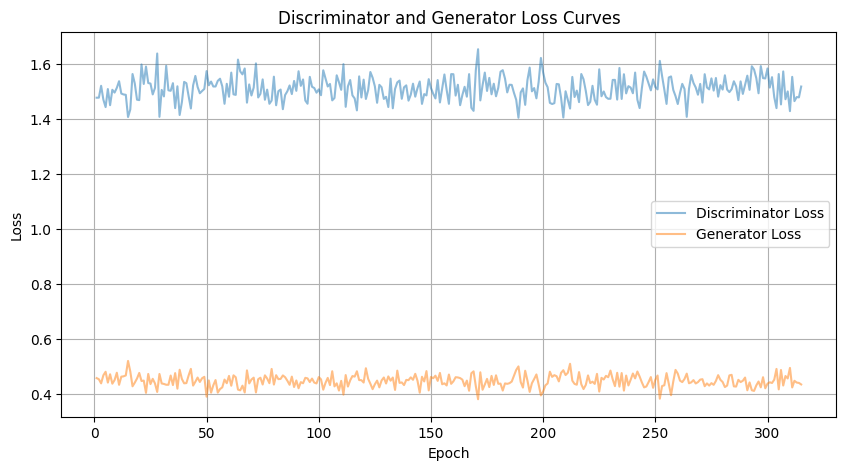

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Load the saved losses
losses = np.load('/content/drive/MyDrive/CS182-Research/bigGAN/generated-images/losses.npz')
d_losses = losses['d_losses']
g_losses = losses['g_losses']

epochs = range(1, len(d_losses) + 1)

plt.figure(figsize=(10, 5))
plt.plot(epochs, d_losses, label='Discriminator Loss', alpha=0.5)
plt.plot(epochs, g_losses, label='Generator Loss', alpha=0.5)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Discriminator and Generator Loss Curves')
plt.legend()
plt.grid(True)

plt.savefig('/content/drive/MyDrive/CS182-Research/bigGAN/generated-images/loss_curves.png')
plt.show()


In [ ]:
import torch
import os
import torchvision.utils
import numpy as np
import matplotlib.pyplot as plt

# Freeze all layers in the generator except for the first embedding layer
for param in generator.parameters():
    param.requires_grad = True

for param in discriminator.parameters():
    param.requires_grad = False

# Unfreeze the last three layers of the discriminator
for param in discriminator.conv_block1[-3:].parameters():
    param.requires_grad = True


# Initialize lists to store losses for plotting
d_losses = []
g_losses = []

# Loss function
criterion = nn.BCELoss()

# Optimizers
optimizer_g = torch.optim.Adam(filter(lambda p: p.requires_grad, generator.parameters()), lr=0.02, betas=(0.5, 0.999))
optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=0.02, betas=(0.5, 0.999))

# Training Loop
num_epochs = 30  # Adjust as needed
real_label = 1
fake_label = 0

# Create directory for saving generated images
save_dir = '/content/drive/MyDrive/CS182-Research/bigGAN/generated-images'
os.makedirs(save_dir, exist_ok=True)

for epoch in range(num_epochs):
    for i, real_images in enumerate(dataloader):
        # ---------------------
        # Train Discriminator
        # ---------------------
        discriminator.zero_grad()

        real_images = real_images.to(device)
        b_size = real_images.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)

        output = torch.mean(discriminator(real_images), dim=1)
        errD_real = criterion(output, label)
        D_x = output.mean().item()

        noise = torch.randn(b_size, noise_dim, device=device)
        class_vector = torch.zeros(b_size, 1001, device=device)
        class_vector[:, anime_class_index] = 1
        fake_images = generator(noise, class_vector, truncation).detach()
        label.fill_(fake_label)

        output = torch.mean(discriminator(fake_images), dim=1)
        errD_fake = criterion(output, label)
        D_G_z1 = output.mean().item()

        errD = errD_real + errD_fake

        # Do not update the discriminator's weights
        # optimizer_d.step()  # Comment out this line to freeze the discriminator

        # ---------------------
        # Train Generator
        # ---------------------
        generator.zero_grad()
        label.fill_(real_label)  # Fake labels are real for generator cost

        output = torch.mean(discriminator(fake_images), dim=1)
        errG = criterion(output, label)
        D_G_z2 = output.mean().item()

        optimizer_g.step()

        # Print statistics
        if i % 50 == 0:
            print(f'[{epoch}/{num_epochs}][{i}/{len(dataloader)}] '
                  f'Loss_D: {errD.item():.4f} Loss_G: {errG.item():.4f} '
                  f'D(x): {D_x:.4f} D(G(z)): {D_G_z1:.4f}/{D_G_z2:.4f}')
        # Save generated images every epoch
        if i == len(dataloader) - 1:
            save_generated_images(generator, epoch, 16, noise_dim, device, save_dir)

        # Calculate and store losses
        d_losses.append(errD.item())
        g_losses.append(errG.item())

        # Print statistics and save losses
        if epoch % 1 == 0:
            print(f'[{epoch}/{num_epochs}] Loss_D: {errD.item():.4f} Loss_G: {errG.item():.4f}')
            # Save the losses for plotting
            np.savez(os.path.join(save_dir, 'losses.npz'), d_losses=d_losses, g_losses=g_losses)

torch.save(discriminator.state_dict(), '/content/drive/MyDrive/CS182-Research/biggan-toy-discriminator.pth')
torch.save(generator.state_dict(), '/content/drive/MyDrive/CS182-Research/biggan-toy-generator.pth')

[0/30][0/63] Loss_D: 1.4976 Loss_G: 0.4570 D(x): 0.6688 D(G(z)): 0.6446/0.6446
[0/30] Loss_D: 1.4976 Loss_G: 0.4570
[0/30] Loss_D: 1.5443 Loss_G: 0.4080
[0/30] Loss_D: 1.5213 Loss_G: 0.4499
[0/30] Loss_D: 1.5573 Loss_G: 0.4369
[0/30] Loss_D: 1.4710 Loss_G: 0.4410
[0/30] Loss_D: 1.5840 Loss_G: 0.3991
[0/30] Loss_D: 1.5388 Loss_G: 0.4217
[0/30] Loss_D: 1.4918 Loss_G: 0.4365
[0/30] Loss_D: 1.4925 Loss_G: 0.4578
[0/30] Loss_D: 1.5162 Loss_G: 0.4235
[0/30] Loss_D: 1.4600 Loss_G: 0.4631
[0/30] Loss_D: 1.5903 Loss_G: 0.4076
[0/30] Loss_D: 1.5195 Loss_G: 0.4424
[0/30] Loss_D: 1.4584 Loss_G: 0.4607
[0/30] Loss_D: 1.5510 Loss_G: 0.4604
[0/30] Loss_D: 1.5150 Loss_G: 0.4614
[0/30] Loss_D: 1.4348 Loss_G: 0.4908
[0/30] Loss_D: 1.5980 Loss_G: 0.4178
[0/30] Loss_D: 1.4632 Loss_G: 0.4696
[0/30] Loss_D: 1.5317 Loss_G: 0.4220
[0/30] Loss_D: 1.5274 Loss_G: 0.4248
[0/30] Loss_D: 1.5282 Loss_G: 0.4140
[0/30] Loss_D: 1.5516 Loss_G: 0.4220
[0/30] Loss_D: 1.5354 Loss_G: 0.4319
[0/30] Loss_D: 1.4789 Loss_G: 0.4

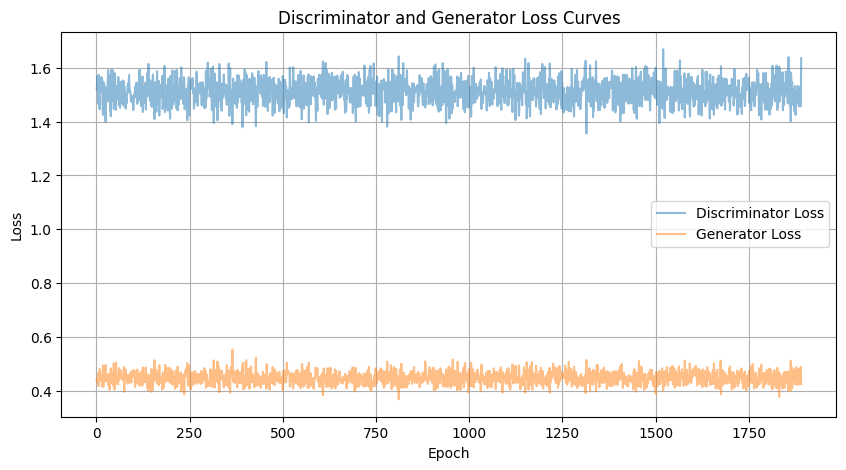

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

losses = np.load('/content/drive/MyDrive/CS182-Research/bigGAN/generated-images/losses.npz')
d_losses = losses['d_losses']
g_losses = losses['g_losses']

epochs = range(1, len(d_losses) + 1)

plt.figure(figsize=(10, 5))
plt.plot(epochs, d_losses, label='Discriminator Loss', alpha=0.5)
plt.plot(epochs, g_losses, label='Generator Loss', alpha=0.5)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Discriminator and Generator Loss Curves')
plt.legend()
plt.grid(True)

plt.savefig('/content/drive/MyDrive/CS182-Research/bigGAN/generated-images/loss_curves.png')
plt.show()


In [ ]:
import torch
import os
import torchvision.utils
import numpy as np
import matplotlib.pyplot as plt

for param in generator.parameters():
    param.requires_grad = False

for layer in generator.generator.layers[-6:]:
    for param in layer.parameters():
        param.requires_grad = True

d_losses = []
g_losses = []
criterion = nn.BCELoss()

optimizer_g = torch.optim.Adam(filter(lambda p: p.requires_grad, generator.parameters()), lr=0.02, betas=(0.5, 0.999))
optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=0.02, betas=(0.5, 0.999))

num_epochs = 20  # Adjust as needed
real_label = 1
fake_label = 0


save_dir = '/content/drive/MyDrive/CS182-Research/bigGAN'
os.makedirs(save_dir, exist_ok=True)

for epoch in range(num_epochs):
    for i, real_images in enumerate(dataloader):
        print(i)
        # ---------------------
        # Train Discriminator
        # ---------------------
        discriminator.zero_grad()

        real_images = real_images.to(device)
        b_size = real_images.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)

        output = torch.mean(discriminator(real_images), dim=1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        noise = torch.randn(b_size, noise_dim, device=device)
        class_vector = torch.zeros(b_size, 1001, device=device)
        class_vector[:, anime_class_index] = 1
        fake_images = generator(noise, class_vector, truncation).detach()
        label.fill_(fake_label)

        output = torch.mean(discriminator(fake_images), dim=1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()

        errD = errD_real + errD_fake
        optimizer_d.step()

        # ---------------------
        # Train Generator
        # ---------------------
        generator.zero_grad()
        label.fill_(real_label)  # Fake labels are real for generator cost

        output = torch.mean(discriminator(fake_images), dim=1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()

        optimizer_g.step()

        # Print statistics
        if i % 50 == 0:
            print(f'[{epoch}/{num_epochs}][{i}/{len(dataloader)}] '
                  f'Loss_D: {errD.item():.4f} Loss_G: {errG.item():.4f} '
                  f'D(x): {D_x:.4f} D(G(z)): {D_G_z1:.4f}/{D_G_z2:.4f}')
        if i == len(dataloader) - 1:
            save_generated_images(generator, epoch, 16, noise_dim, device, save_dir)

        d_losses.append(errD.item())
        g_losses.append(errG.item())

        if epoch % 1 == 0:
            print(f'[{epoch}/{num_epochs}] Loss_D: {errD.item():.4f} Loss_G: {errG.item():.4f}')
            np.savez(os.path.join(save_dir, 'losses.npz'), d_losses=d_losses, g_losses=g_losses)

torch.save(discriminator.state_dict(), '/content/drive/MyDrive/CS182-Research/biggan-toy-discriminator.pth')
torch.save(generator.state_dict(), '/content/drive/MyDrive/CS182-Research/biggan-toy-generator.pth')


0


OutOfMemoryError: ignored

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

losses = np.load('/content/drive/MyDrive/CS182-Research/bigGAN/generated-images/losses.npz')
d_losses = losses['d_losses']
g_losses = losses['g_losses']

epochs = range(1, len(d_losses) + 1)

plt.figure(figsize=(10, 5))
plt.plot(epochs, d_losses, label='Discriminator Loss', alpha=0.5)
plt.plot(epochs, g_losses, label='Generator Loss', alpha=0.5)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Discriminator and Generator Loss Curves')
plt.legend()
plt.grid(True)

plt.savefig('/content/drive/MyDrive/CS182-Research/bigGAN/generated-images/loss_curves.png')
plt.show()


LORA Approach on bigGAN


In [ ]:
import torch

discriminator_weights_path = '/content/drive/MyDrive/CS182-Research/bigGAN/frozen-discriminator-weights/biggan-toy-discriminator.pth'

discriminator = Discriminator(3).to(device)

checkpoint = torch.load(discriminator_weights_path, map_location='cuda' if torch.cuda.is_available() else 'cpu')
discriminator.load_state_dict(checkpoint)

discriminator.train()

Discriminator(
  (conv_block1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2, inplace=True)
    (12): Conv2d(512, 1, kernel_size=(4, 4), stride=(2, 2))
    (13): Flatten(s

In [ ]:
generator

ModifiedBigGAN(
  (generator): Generator(
    (gen_z): Linear(in_features=256, out_features=32768, bias=True)
    (layers): ModuleList(
      (0-2): 3 x GenBlock(
        (bn_0): BigGANBatchNorm(
          (scale): Linear(in_features=256, out_features=2048, bias=False)
          (offset): Linear(in_features=256, out_features=2048, bias=False)
        )
        (conv_0): Conv2d(2048, 512, kernel_size=(1, 1), stride=(1, 1))
        (bn_1): BigGANBatchNorm(
          (scale): Linear(in_features=256, out_features=512, bias=False)
          (offset): Linear(in_features=256, out_features=512, bias=False)
        )
        (conv_1): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (bn_2): BigGANBatchNorm(
          (scale): Linear(in_features=256, out_features=512, bias=False)
          (offset): Linear(in_features=256, out_features=512, bias=False)
        )
        (conv_2): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (bn_3): BigGAN

In [ ]:
import torch
import torch.nn as nn

# Load your ModifiedBigGAN model
model = generator
model.eval()

# Freeze all the weights in the model
for param in model.parameters():
    param.requires_grad = False

# Define the A and B matrices
A_matrix = torch.randn((1001, 100), requires_grad=True).to(device)
B_matrix = torch.randn((100, 1), requires_grad=True).to(device)

def apply_lora_projection(embeddings):
    reduced_embeddings = torch.matmul(embeddings, A_matrix)

    adapted_embeddings = torch.matmul(reduced_embeddings, B_matrix)

    return adapted_embeddings

adapted_state_dict = model.state_dict()
for key in adapted_state_dict:
    if key == 'embeddings.weight':
        embeddings = adapted_state_dict[key]
        adapted_embeddings = apply_lora_projection(embeddings)
        adapted_state_dict[key] = embeddings + adapted_embeddings

model.load_state_dict(adapted_state_dict)



<All keys matched successfully>

In [ ]:
import torch
import os
import torchvision.utils
import numpy as np
import matplotlib.pyplot as plt


d_losses = []
g_losses = []

criterion = nn.BCELoss()

model = generator
model.eval()

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

for param in model.parameters():
    param.requires_grad = False

r = 300  # Low-rank

in_channels = 128  # This should be adjusted based on your actual layer's input channels
kernel_size = 3

A_matrix = torch.randn((in_channels * kernel_size * kernel_size, r), requires_grad=True, device="cuda:0")
B_matrix = torch.randn((r, 1152), requires_grad=True, device="cuda:0")

def apply_lora_to_conv(conv_weights, A_matrix, B_matrix):
    original_shape = conv_weights.shape
    out_channels, in_channels, kernel_height, kernel_width = original_shape

    adapted_weights = torch.zeros_like(conv_weights)

    for i in range(out_channels):  # Iterate over each output channel
        filter_weights = conv_weights[i, :, :, :].view(-1)  # Flatten the filter weights

        # Apply LoRA projection
        reduced_weights = torch.matmul(filter_weights, A_matrix)
        adapted_filter_weights = torch.matmul(reduced_weights, B_matrix)

        # Reshape back to the filter shape and store in adapted_weights
        adapted_weights[i, :, :, :] = adapted_filter_weights.view(in_channels, kernel_height, kernel_width)

    return adapted_weights


adapted_state_dict = model.state_dict()
conv_layer_key = 'generator.conv_to_rgb.weight_orig'
conv_weights = adapted_state_dict[conv_layer_key]
adapted_conv_weights = apply_lora_to_conv(conv_weights, A_matrix, B_matrix)
adapted_state_dict[conv_layer_key] = conv_weights + adapted_conv_weights

model.load_state_dict(adapted_state_dict)

optimizer = torch.optim.Adam([A_matrix, B_matrix], lr=0.02, betas=(0.5, 0.999))


# Training Loop
num_epochs = 30  # Adjust as needed
real_label = 1
fake_label = 0

save_dir = '/content/drive/MyDrive/CS182-Research/bigGAN'
os.makedirs(save_dir, exist_ok=True)

for epoch in range(num_epochs):
    for i, real_images in enumerate(dataloader):
        # ---------------------
        # Train Discriminator
        # ---------------------
        discriminator.zero_grad()

        real_images = real_images.to(device)
        b_size = real_images.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)

        output = torch.mean(discriminator(real_images), dim=1)
        errD_real = criterion(output, label)
        D_x = output.mean().item()

        noise = torch.randn(b_size, noise_dim, device=device)
        class_vector = torch.zeros(b_size, 1001, device=device)
        class_vector[:, anime_class_index] = 1
        fake_images = model(noise, class_vector, truncation).detach()
        label.fill_(fake_label)

        output = torch.mean(discriminator(fake_images), dim=1)
        errD_fake = criterion(output, label)
        D_G_z1 = output.mean().item()

        errD = errD_real + errD_fake


        # ---------------------
        # Train Generator
        # ---------------------
        model.zero_grad()
        label.fill_(real_label)  # Fake labels are real for generator cost

        output = torch.mean(discriminator(fake_images), dim=1)
        errG = criterion(output, label)
        D_G_z2 = output.mean().item()

        optimizer_g.step()

        # Print statistics
        if i % 50 == 0:
            print(f'[{epoch}/{num_epochs}][{i}/{len(dataloader)}] '
                  f'Loss_D: {errD.item():.4f} Loss_G: {errG.item():.4f} '
                  f'D(x): {D_x:.4f} D(G(z)): {D_G_z1:.4f}/{D_G_z2:.4f}')
        if i == len(dataloader) - 1:
            save_generated_images(model, epoch, 16, noise_dim, device, save_dir)

        d_losses.append(errD.item())
        g_losses.append(errG.item())

        if epoch % 1 == 0:
            print(f'[{epoch}/{num_epochs}] Loss_D: {errD.item():.4f} Loss_G: {errG.item():.4f}')
            # Save the losses for plotting
            np.savez(os.path.join(save_dir, 'losses.npz'), d_losses=d_losses, g_losses=g_losses)

# Save final models (optional)
torch.save(discriminator.state_dict(), '/content/drive/MyDrive/CS182-Research/LORA-bigGAN-discriminator.pth')
torch.save(model.state_dict(), '/content/drive/MyDrive/CS182-Research/LORA-bigGAN-generator.pth')

KeyboardInterrupt: ignored

In [ ]:
for key in model.state_dict():
    print(key)

generator.gen_z.bias
generator.gen_z.weight_orig
generator.gen_z.weight_u
generator.gen_z.weight_v
generator.layers.0.bn_0.running_means
generator.layers.0.bn_0.running_vars
generator.layers.0.bn_0.scale.weight_orig
generator.layers.0.bn_0.scale.weight_u
generator.layers.0.bn_0.scale.weight_v
generator.layers.0.bn_0.offset.weight_orig
generator.layers.0.bn_0.offset.weight_u
generator.layers.0.bn_0.offset.weight_v
generator.layers.0.conv_0.bias
generator.layers.0.conv_0.weight_orig
generator.layers.0.conv_0.weight_u
generator.layers.0.conv_0.weight_v
generator.layers.0.bn_1.running_means
generator.layers.0.bn_1.running_vars
generator.layers.0.bn_1.scale.weight_orig
generator.layers.0.bn_1.scale.weight_u
generator.layers.0.bn_1.scale.weight_v
generator.layers.0.bn_1.offset.weight_orig
generator.layers.0.bn_1.offset.weight_u
generator.layers.0.bn_1.offset.weight_v
generator.layers.0.conv_1.bias
generator.layers.0.conv_1.weight_orig
generator.layers.0.conv_1.weight_u
generator.layers.0.con

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


Inducing Diversity on Toy Model

In [ ]:
import torch
import torch.nn as nn

class Discriminator(nn.Module):
    def __init__(self,inchannels):
        super(Discriminator,self).__init__()
        """
        Initialize the Discriminator Module
        :param inchannels: The depth of the first convolutional layer
        """
        self.conv_block1 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace = True),
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace = True),
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace = True),
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace = True),
            nn.Conv2d(in_channels=512, out_channels=1, kernel_size=4, stride=2, padding=0),
            nn.Flatten(),
            nn.Sigmoid()
        )

    def forward(self,x):
        """
        Forward propagation of the neural network
        :param x: The input to the neural network
        :return: Discriminator logits; the output of the neural network
        """
        x = self.conv_block1(x)
        return x

discriminator=Discriminator(3).to(device)

In [ ]:
latent_size = 128
class Generator(nn.Module):
    def __init__(self,latent_size):
        super(Generator,self).__init__()
        """
        Initialize the Generator Module
        :param latent_size: The length of the input latent vector
        """
        self.conv_block1 = nn.Sequential(
            nn.ConvTranspose2d(in_channels=latent_size, out_channels=512, kernel_size=4, stride=1, padding=0),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=64, out_channels=3, kernel_size=4, stride=2, padding=1),
            nn.Tanh()
        )

    def forward(self,x):
        """
        Forward propagation of the neural network
        :param x: The input to the neural network
        :return: A 3x64x64 Tensor image as output
        """
        x = self.conv_block1(x)
        return x


pretrained_generator=Generator(latent_size).to(device)


In [ ]:
import os
os.environ['CUDA_LAUNCH_BLOCKING'] = "1"


In [ ]:
import torch

weights_path = '/content/drive/MyDrive/CS182-Research/Good Models/toy-models/discriminator-toy-naive.pth'

checkpoint = torch.load(weights_path, map_location='cuda' if torch.cuda.is_available() else 'cpu')
discriminator.load_state_dict(checkpoint)


discriminator.train()


Discriminator(
  (conv_block1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2, inplace=True)
    (12): Conv2d(512, 1, kernel_size=(4, 4), stride=(2, 2))
    (13): Flatten(s

In [ ]:
import torch

generator_weights_path = '/content/drive/MyDrive/CS182-Research/Good Models/toy-models/generator-toy-naive.pth'

checkpoint = torch.load(generator_weights_path, map_location='cuda' if torch.cuda.is_available() else 'cpu')
pretrained_generator.load_state_dict(checkpoint)

pretrained_generator.train()



Generator(
  (conv_block1): Sequential(
    (0): ConvTranspose2d(128, 512, kernel_size=(4, 4), stride=(1, 1))
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU()
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (13): Tanh()
  )
)

In [ ]:
%matplotlib inline
from torchvision.utils import make_grid
def denorm(img_tensors):
    return img_tensors * stats[1][0] + stats[0][0]

def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.cpu().detach()[:nmax]), nrow=8).permute(1, 2, 0))


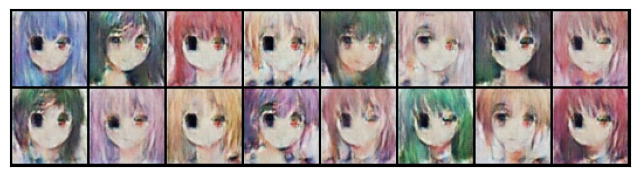

In [ ]:

noise = torch.randn(16, latent_size, 1, 1).to(device)
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)

# Generate an image
with torch.no_grad():
  fake_images_pre_training = generator(noise)

fake_images_pre_training.to(device)

show_images(fake_images_pre_training)

In [ ]:
discriminator(fake_images_pre_training)

tensor([[0.1673],
        [0.1161],
        [0.1601],
        [0.1317],
        [0.1198],
        [0.1090],
        [0.0947],
        [0.1170],
        [0.0868],
        [0.1207],
        [0.1091],
        [0.1178],
        [0.1287],
        [0.1539],
        [0.0981],
        [0.1390]], device='cuda:0')

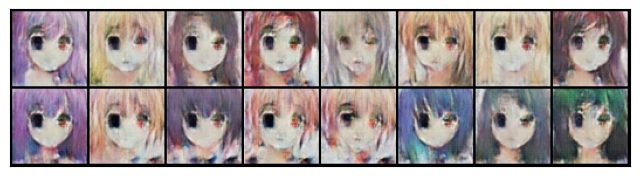

In [ ]:

noise = torch.randn(16, latent_size, 1, 1).to(device)
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)

# Generate an image
with torch.no_grad():
  fake_images_pre_training = generator(noise)

fake_images_pre_training.to(device)

show_images(fake_images_pre_training)

In [ ]:
# inducing males anime pictures:
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import os

class AnimeFaceDataset(Dataset):
    def __init__(self, directory, num_images=None, transform=None):
        self.directory = directory
        self.transform = transform
        self.images = os.listdir(directory)
        if num_images is not None:
            self.images = self.images[:num_images]

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_name = os.path.join(self.directory, self.images[idx])
        image = Image.open(img_name)
        if self.transform:
            image = self.transform(image)
        return image

transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor(),
])

num_images_to_load = 50
dataset = AnimeFaceDataset(directory='/content/drive/MyDrive/CS182-Research/MaleCharacterDALLE', num_images=num_images_to_load, transform=transform)
dataloader = DataLoader(dataset, batch_size=16, shuffle=True)


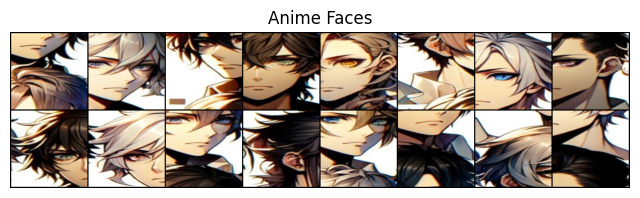

In [ ]:
import matplotlib.pyplot as plt
import torchvision.utils as vutils

def show_images(dataloader):
    # Get a batch of images
    images = next(iter(dataloader))

    plt.figure(figsize=(8,8))
    plt.axis("off")
    plt.title("Anime Faces")
    grid = vutils.make_grid(images, padding=2, normalize=True)
    plt.imshow(grid.permute(1, 2, 0).cpu().numpy())

# Show images
show_images(dataloader)


In [ ]:
# inducing males anime pictures:
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import os

class AnimeFaceDataset(Dataset):
    def __init__(self, directory, num_images=None, transform=None):
        self.directory = directory
        self.transform = transform
        self.images = os.listdir(directory)
        if num_images is not None:
            self.images = self.images[:num_images]

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_name = os.path.join(self.directory, self.images[idx])
        image = Image.open(img_name)
        if self.transform:
            image = self.transform(image)
        return image

transform = transforms.Compose([
                                transforms.CenterCrop(64),
                                transforms.Resize(64, interpolation=2),
                                transforms.ToTensor(),
                                transforms.Normalize(*stats)])

num_images_to_load = 50
dataset = AnimeFaceDataset(directory='/content/drive/MyDrive/CS182-Research/MaleCharacterDALLE', num_images=num_images_to_load, transform=transform)
dataloader = DataLoader(dataset, batch_size=16, shuffle=True)


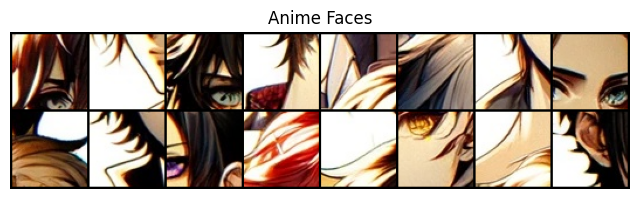

In [ ]:
import matplotlib.pyplot as plt
import torchvision.utils as vutils

def show_images(dataloader):
    images = next(iter(dataloader))

    plt.figure(figsize=(8,8))
    plt.axis("off")
    plt.title("Anime Faces")
    grid = vutils.make_grid(images, padding=2, normalize=True)
    plt.imshow(grid.permute(1, 2, 0).cpu().numpy())

show_images(dataloader)


In [ ]:
import torch
import torch.nn as nn

class GeneratorWithLoRA(nn.Module):
    def __init__(self, latent_size, lora_rank=20):
        super(GeneratorWithLoRA, self).__init__()
        self.latent_size = latent_size
        self.lora_rank = lora_rank

        self.conv_block1 = nn.Sequential(
            nn.ConvTranspose2d(in_channels=latent_size, out_channels=512, kernel_size=4, stride=1, padding=0),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=64, out_channels=3, kernel_size=4, stride=2, padding=1),
            nn.Tanh()
        )

        # LoRA matrices for the first convolutional layer
        self.A_matrix = nn.Parameter(torch.randn((128*4*4, lora_rank)))
        self.B_matrix = nn.Parameter(torch.randn((lora_rank, 512*4)))

    def apply_lora_projection(self, layer, A_matrix, B_matrix):
        original_weight = layer.weight.data.view(layer.out_channels, -1)
        adapted_weight = torch.matmul(torch.matmul(original_weight, A_matrix), B_matrix)
        return adapted_weight.view_as(layer.weight)

    def forward(self, x):
        with torch.no_grad():
            self.conv_block1[0].weight.copy_(self.apply_lora_projection(self.conv_block1[0], self.A_matrix, self.B_matrix))

        x = self.conv_block1(x)
        print(x.shape)
        return x


In [ ]:
class GeneratorWithLoRA(nn.Module):
    def __init__(self, latent_size, lora_rank=100):
        super(GeneratorWithLoRA, self).__init__()
        self.latent_size = latent_size

        self.conv_block1 = nn.Sequential(
            nn.ConvTranspose2d(in_channels=latent_size, out_channels=512, kernel_size=4, stride=1, padding=0),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=64, out_channels=3, kernel_size=4, stride=2, padding=1),
            nn.Tanh()
        )
        # LoRA matrices
        self.A_matrix = nn.Parameter(torch.randn((128, lora_rank)))
        self.B_matrix = nn.Parameter(torch.randn((lora_rank, 512 * 4 * 4)))

    def apply_lora_projection(self, input, A_matrix, B_matrix):
        flattened_input = input.view(input.size(0), -1)
        lora_transformed = torch.matmul(torch.matmul(flattened_input, A_matrix), B_matrix)
        return lora_transformed

    def forward(self, x):
        conv_output = self.conv_block1[0](x)
        flattened_conv_output = conv_output.view(conv_output.size(0), -1)

        lora_output = self.apply_lora_projection(x, self.A_matrix, self.B_matrix)
        combined_output = flattened_conv_output + lora_output

        combined_output_reshaped = combined_output.view_as(conv_output)

        x = combined_output_reshaped
        for layer in self.conv_block1[1:]:
            x = layer(x)


        return x
generator_with_lora = GeneratorWithLoRA(latent_size=128)


In [ ]:
generator_with_lora = GeneratorWithLoRA(latent_size=128)

current_state_dict = generator_with_lora.state_dict()
for name, param in checkpoint.items():
    if name in current_state_dict:
        current_state_dict[name].copy_(param)
generator_with_lora.load_state_dict(current_state_dict)


<All keys matched successfully>

In [ ]:
loss_fn = torch.nn.MSELoss()
def Real_loss(preds,targets):
    '''
       Calculates how close discriminator outputs are to being real.
       param, D_out: discriminator logits
       return: real loss
    '''
    beta_distr = torch.distributions.beta.Beta(1,5,validate_args=None)
    label_noise = beta_distr.sample(sample_shape=targets.shape).to(torch.device(device))
    loss= loss_fn(targets,preds-label_noise)
    return loss.requires_grad_(True)
def Fake_loss(preds,targets):
    '''
       Calculates how close discriminator outputs are to being fake.
       param, D_out: discriminator logits
       return: fake loss
    '''
    beta_distr = torch.distributions.beta.Beta(1,5,validate_args=None)
    label_noise = beta_distr.sample(sample_shape=targets.shape).to(torch.device(device))
    loss= loss_fn(targets,preds+label_noise)
    return loss.requires_grad_(True)

In [ ]:
generator = GeneratorWithLoRA(latent_size=128)

for param in generator.parameters():
    param.requires_grad = False
for param in discriminator.parameters():
    param.requires_grad = False

generator.A_matrix.requires_grad = True
generator.B_matrix.requires_grad = True

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)

optimizer_g = torch.optim.Adam(filter(lambda p: p.requires_grad, generator.parameters()), lr=0.02, betas=(0.5, 0.999))
optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
import torch
import numpy as np
import os
from tqdm import tqdm
from torch.nn import BCELoss

import torchvision.utils as vutils
import os

def save_generated_images(generator, epoch, noise_dim, device, save_dir):
    with torch.no_grad():
        noise = torch.randn(16, noise_dim, 1, 1, device=device)
        fake_images = generator(noise)

        os.makedirs(save_dir, exist_ok=True)

        # Save images
        filename = f"{save_dir}/epoch_{epoch}.png"
        vutils.save_image(fake_images, filename, normalize=True)

save_dir = '/content/drive/MyDrive/CS182-Research/'


# Training Loop
num_epochs = 20  # Adjust as needed
real_label = 1.0
fake_label = 0.0
criterion = BCELoss()

# Arrays to keep track of progress
d_losses = []
g_losses = []
real_scores = []
fake_scores = []

for epoch in tqdm(range(num_epochs), desc='Epochs'):
    for i, real_images in enumerate(dataloader, start=1):
        ############################
        # Train Discriminator
        ############################
        discriminator.zero_grad()

        # Train with real images
        real_images = real_images.to(device)
        b_size = real_images.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)

        errD_real = criterion(torch.mean(discriminator(real_images), dim=1), label)
        D_x = output.mean().item()

        # Train with fake images
        noise = torch.randn(b_size, 128, 1, 1, device=device)  # Adjust the size (128) to your latent vector size
        print(noise.shape)
        fake_images = generator(noise)
        label.fill_(fake_label)
        output = discriminator(fake_images.detach()).view(-1)
        errD_fake = criterion(output, label)
        D_G_z1 = output.mean().item()

        errD = errD_real + errD_fake
        optimizer_d.step()

        ############################
        # Train Generator
        ############################
        generator.zero_grad()
        label.fill_(real_label)  # Fake labels are real for generator cost
        output = discriminator(fake_images).view(-1)
        errG = criterion(output, label)
        D_G_z2 = output.mean().item()
        optimizer_g.step()

        ############################
        # Output Training Stats
        ############################
        if i % 50 == 0:
            print(f'[{epoch+1}/{num_epochs}][{i}/{len(dataloader)}] '
                  f'Loss_D: {errD.item():.4f} Loss_G: {errG.item():.4f} '
                  f'D(x): {D_x:.4f} D(G(z)): {D_G_z1:.4f}/{D_G_z2:.4f}')

        # Save Losses for plotting later
        d_losses.append(errD.item())
        g_losses.append(errG.item())

    save_generated_images(generator, epoch, 128, device, save_dir)

# Save the final model
torch.save(discriminator.state_dict(), '/content/drive/MyDrive/CS182-Research/toy-male-diversity-discriminator.pth')
torch.save(generator.state_dict(), '/content/drive/MyDrive/CS182-Research/toy-male-diversity-generator.pth')

np.savez(os.path.join(save_dir, 'losses.npz'), d_losses=d_losses, g_losses=g_losses)



Epochs:   5%|▌         | 1/20 [00:00<00:03,  4.76it/s]

torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([2, 128, 1, 1])


Epochs:  10%|█         | 2/20 [00:00<00:03,  4.81it/s]

torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([2, 128, 1, 1])
torch.Size([16, 128, 1, 1])


Epochs:  15%|█▌        | 3/20 [00:00<00:03,  4.83it/s]

torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([2, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])


Epochs:  20%|██        | 4/20 [00:00<00:03,  4.90it/s]

torch.Size([16, 128, 1, 1])
torch.Size([2, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])


Epochs:  25%|██▌       | 5/20 [00:01<00:03,  4.90it/s]

torch.Size([16, 128, 1, 1])
torch.Size([2, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])


Epochs:  30%|███       | 6/20 [00:01<00:02,  4.94it/s]

torch.Size([2, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([2, 128, 1, 1])


Epochs:  40%|████      | 8/20 [00:01<00:02,  4.96it/s]

torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([2, 128, 1, 1])


Epochs:  45%|████▌     | 9/20 [00:01<00:02,  4.97it/s]

torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([2, 128, 1, 1])
torch.Size([16, 128, 1, 1])


Epochs:  50%|█████     | 10/20 [00:02<00:02,  4.96it/s]

torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([2, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])


Epochs:  55%|█████▌    | 11/20 [00:02<00:01,  4.99it/s]

torch.Size([16, 128, 1, 1])
torch.Size([2, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])


Epochs:  60%|██████    | 12/20 [00:02<00:01,  4.96it/s]

torch.Size([16, 128, 1, 1])
torch.Size([2, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])


Epochs:  65%|██████▌   | 13/20 [00:02<00:01,  4.96it/s]

torch.Size([16, 128, 1, 1])
torch.Size([2, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])


Epochs:  70%|███████   | 14/20 [00:02<00:01,  4.81it/s]

torch.Size([16, 128, 1, 1])
torch.Size([2, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])


Epochs:  75%|███████▌  | 15/20 [00:03<00:01,  4.80it/s]

torch.Size([16, 128, 1, 1])
torch.Size([2, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])


Epochs:  80%|████████  | 16/20 [00:03<00:00,  4.84it/s]

torch.Size([16, 128, 1, 1])
torch.Size([2, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])


Epochs:  85%|████████▌ | 17/20 [00:03<00:00,  4.82it/s]

torch.Size([16, 128, 1, 1])
torch.Size([2, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])


Epochs:  90%|█████████ | 18/20 [00:03<00:00,  4.81it/s]

torch.Size([16, 128, 1, 1])
torch.Size([2, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])


Epochs:  95%|█████████▌| 19/20 [00:03<00:00,  4.86it/s]

torch.Size([2, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])
torch.Size([16, 128, 1, 1])


Epochs: 100%|██████████| 20/20 [00:04<00:00,  4.89it/s]

torch.Size([2, 128, 1, 1])


In [ ]:
#creation of adversarial images after fine-tuning

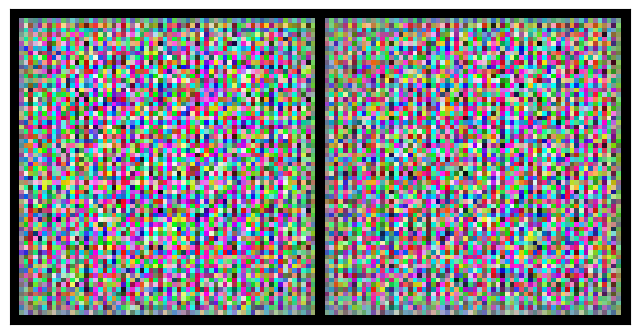

In [ ]:
with torch.no_grad():
  fake_images_after_lora = generator(noise)

fake_images_after_lora.to(device)

show_images(fake_images_after_lora)

In [ ]:
discriminator(fake_images_after_lora)

tensor([[0.6034],
        [0.5645]], device='cuda:0')

In [ ]:
%matplotlib inline

def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1, 2, 0))

In [ ]:
sample_dir = '/content/drive/MyDrive/CS182-Research/bigGAN'
os.makedirs(sample_dir, exist_ok=True)
def save_samples(index, latent_tensors, generator, show=True):
    fake_images = generator(latent_tensors)
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    save_image(denorm(fake_images), os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(fake_images.cpu().detach(), nrow=8).permute(1, 2, 0))
        plt.show()
fixed_latent = torch.randn(64, latent_size, 1, 1, device=device)

In [ ]:
generator.conv_block1[1]

BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)

In [ ]:
for param in generator.conv_block1[1].parameters():
    param.requires_grad = True


In [ ]:
generator = generator_with_lora

100%|██████████| 7/7 [00:00<00:00, 18.70it/s]


Epoch [1/100], loss_g: 0.0182, loss_d: 0.5822, real_score: 0.6602, fake_score: 0.8531
Saving generated-images-0001.png


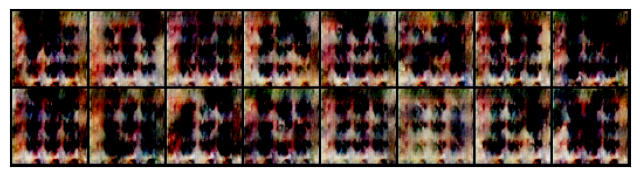

100%|██████████| 7/7 [00:00<00:00, 22.08it/s]


Epoch [2/100], loss_g: 0.0089, loss_d: 0.5986, real_score: 0.6675, fake_score: 0.8639


100%|██████████| 7/7 [00:00<00:00, 24.58it/s]


Epoch [3/100], loss_g: 0.0202, loss_d: 0.6231, real_score: 0.6702, fake_score: 0.9093


100%|██████████| 7/7 [00:00<00:00, 24.20it/s]


Epoch [4/100], loss_g: 0.0164, loss_d: 0.5236, real_score: 0.6766, fake_score: 0.8362


100%|██████████| 7/7 [00:00<00:00, 24.73it/s]


Epoch [5/100], loss_g: 0.0188, loss_d: 0.6694, real_score: 0.6792, fake_score: 0.8991


100%|██████████| 7/7 [00:00<00:00, 24.56it/s]


Epoch [6/100], loss_g: 0.0487, loss_d: 0.5830, real_score: 0.6714, fake_score: 0.8278


100%|██████████| 7/7 [00:00<00:00, 24.05it/s]


Epoch [7/100], loss_g: 0.0285, loss_d: 0.5658, real_score: 0.6489, fake_score: 0.8701


100%|██████████| 7/7 [00:00<00:00, 23.97it/s]


Epoch [8/100], loss_g: 0.0408, loss_d: 0.5031, real_score: 0.6542, fake_score: 0.8388


100%|██████████| 7/7 [00:00<00:00, 25.02it/s]


Epoch [9/100], loss_g: 0.0075, loss_d: 0.5598, real_score: 0.6661, fake_score: 0.8465


100%|██████████| 7/7 [00:00<00:00, 23.21it/s]


Epoch [10/100], loss_g: 0.0283, loss_d: 0.4844, real_score: 0.6676, fake_score: 0.8204


100%|██████████| 7/7 [00:00<00:00, 22.31it/s]


Epoch [11/100], loss_g: 0.0147, loss_d: 0.5623, real_score: 0.6787, fake_score: 0.8550
Saving generated-images-0011.png


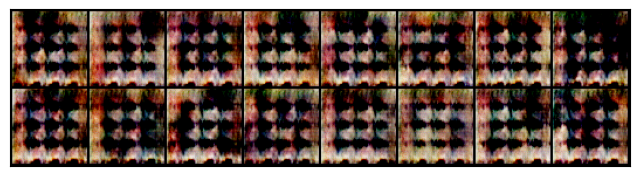

100%|██████████| 7/7 [00:00<00:00, 23.06it/s]


Epoch [12/100], loss_g: 0.0348, loss_d: 0.5057, real_score: 0.6543, fake_score: 0.8321


100%|██████████| 7/7 [00:00<00:00, 22.62it/s]


Epoch [13/100], loss_g: 0.0410, loss_d: 0.6993, real_score: 0.6387, fake_score: 0.8668


100%|██████████| 7/7 [00:00<00:00, 22.61it/s]


Epoch [14/100], loss_g: 0.0423, loss_d: 0.6176, real_score: 0.6457, fake_score: 0.8687


100%|██████████| 7/7 [00:00<00:00, 22.12it/s]


Epoch [15/100], loss_g: 0.0187, loss_d: 0.5483, real_score: 0.6684, fake_score: 0.8477


100%|██████████| 7/7 [00:00<00:00, 22.97it/s]


Epoch [16/100], loss_g: 0.0227, loss_d: 0.5488, real_score: 0.6498, fake_score: 0.8355


100%|██████████| 7/7 [00:00<00:00, 22.87it/s]


Epoch [17/100], loss_g: 0.0140, loss_d: 0.5146, real_score: 0.6256, fake_score: 0.8483


100%|██████████| 7/7 [00:00<00:00, 18.54it/s]


Epoch [18/100], loss_g: 0.0358, loss_d: 0.5331, real_score: 0.6846, fake_score: 0.8408


100%|██████████| 7/7 [00:00<00:00, 21.59it/s]


Epoch [19/100], loss_g: 0.0233, loss_d: 0.5878, real_score: 0.6695, fake_score: 0.8261


100%|██████████| 7/7 [00:00<00:00, 23.41it/s]


Epoch [20/100], loss_g: 0.0140, loss_d: 0.5258, real_score: 0.6216, fake_score: 0.8468


100%|██████████| 7/7 [00:00<00:00, 24.63it/s]


Epoch [21/100], loss_g: 0.0216, loss_d: 0.5949, real_score: 0.6673, fake_score: 0.8373
Saving generated-images-0021.png


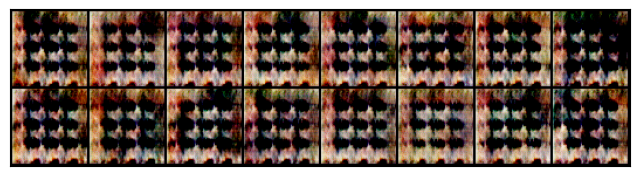

100%|██████████| 7/7 [00:00<00:00, 24.04it/s]


Epoch [22/100], loss_g: 0.0131, loss_d: 0.5490, real_score: 0.6635, fake_score: 0.8257


100%|██████████| 7/7 [00:00<00:00, 24.72it/s]


Epoch [23/100], loss_g: 0.0240, loss_d: 0.5733, real_score: 0.6920, fake_score: 0.8576


100%|██████████| 7/7 [00:00<00:00, 24.27it/s]


Epoch [24/100], loss_g: 0.0257, loss_d: 0.5448, real_score: 0.6090, fake_score: 0.8496


100%|██████████| 7/7 [00:00<00:00, 23.76it/s]


Epoch [25/100], loss_g: 0.0092, loss_d: 0.5671, real_score: 0.6804, fake_score: 0.8432


100%|██████████| 7/7 [00:00<00:00, 23.97it/s]


Epoch [26/100], loss_g: 0.0160, loss_d: 0.5759, real_score: 0.6441, fake_score: 0.8383


100%|██████████| 7/7 [00:00<00:00, 20.46it/s]


Epoch [27/100], loss_g: 0.0484, loss_d: 0.5889, real_score: 0.6309, fake_score: 0.8619


100%|██████████| 7/7 [00:00<00:00, 21.03it/s]


Epoch [28/100], loss_g: 0.0059, loss_d: 0.5292, real_score: 0.6479, fake_score: 0.8538


100%|██████████| 7/7 [00:00<00:00, 22.55it/s]


Epoch [29/100], loss_g: 0.0114, loss_d: 0.5299, real_score: 0.6728, fake_score: 0.8252


100%|██████████| 7/7 [00:00<00:00, 24.26it/s]


Epoch [30/100], loss_g: 0.0130, loss_d: 0.5318, real_score: 0.6585, fake_score: 0.8254


100%|██████████| 7/7 [00:00<00:00, 20.63it/s]


Epoch [31/100], loss_g: 0.0309, loss_d: 0.4843, real_score: 0.6518, fake_score: 0.8308
Saving generated-images-0031.png


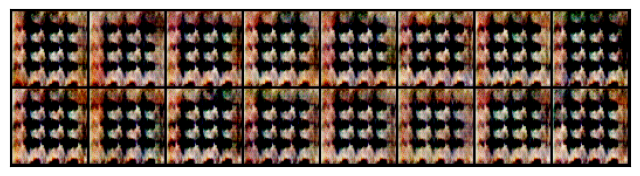

100%|██████████| 7/7 [00:00<00:00, 23.08it/s]


Epoch [32/100], loss_g: 0.0199, loss_d: 0.5419, real_score: 0.6603, fake_score: 0.8027


100%|██████████| 7/7 [00:00<00:00, 25.22it/s]


Epoch [33/100], loss_g: 0.0126, loss_d: 0.5404, real_score: 0.6711, fake_score: 0.8458


100%|██████████| 7/7 [00:00<00:00, 25.32it/s]


Epoch [34/100], loss_g: 0.0206, loss_d: 0.5211, real_score: 0.6485, fake_score: 0.8033


100%|██████████| 7/7 [00:00<00:00, 22.41it/s]


Epoch [35/100], loss_g: 0.0432, loss_d: 0.5488, real_score: 0.6622, fake_score: 0.8376


100%|██████████| 7/7 [00:00<00:00, 23.41it/s]


Epoch [36/100], loss_g: 0.0210, loss_d: 0.5435, real_score: 0.6567, fake_score: 0.8016


100%|██████████| 7/7 [00:00<00:00, 22.96it/s]


Epoch [37/100], loss_g: 0.0098, loss_d: 0.6214, real_score: 0.6698, fake_score: 0.8536


100%|██████████| 7/7 [00:00<00:00, 23.25it/s]


Epoch [38/100], loss_g: 0.0126, loss_d: 0.5696, real_score: 0.6005, fake_score: 0.8561


100%|██████████| 7/7 [00:00<00:00, 20.87it/s]


Epoch [39/100], loss_g: 0.0206, loss_d: 0.5708, real_score: 0.6501, fake_score: 0.8331


100%|██████████| 7/7 [00:00<00:00, 22.06it/s]


Epoch [40/100], loss_g: 0.0339, loss_d: 0.5159, real_score: 0.6820, fake_score: 0.8325


100%|██████████| 7/7 [00:00<00:00, 21.45it/s]


Epoch [41/100], loss_g: 0.0140, loss_d: 0.4623, real_score: 0.6494, fake_score: 0.8062
Saving generated-images-0041.png


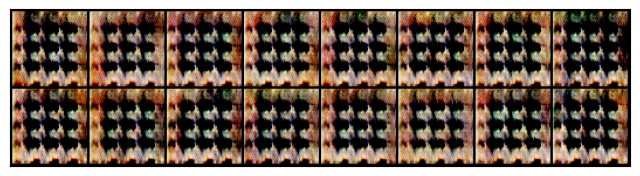

100%|██████████| 7/7 [00:00<00:00, 22.85it/s]


Epoch [42/100], loss_g: 0.0170, loss_d: 0.5144, real_score: 0.6932, fake_score: 0.8490


100%|██████████| 7/7 [00:00<00:00, 23.06it/s]


Epoch [43/100], loss_g: 0.0312, loss_d: 0.5487, real_score: 0.6491, fake_score: 0.8581


100%|██████████| 7/7 [00:00<00:00, 22.34it/s]


Epoch [44/100], loss_g: 0.0240, loss_d: 0.6018, real_score: 0.6722, fake_score: 0.8395


100%|██████████| 7/7 [00:00<00:00, 22.64it/s]


Epoch [45/100], loss_g: 0.0231, loss_d: 0.5584, real_score: 0.6664, fake_score: 0.8236


100%|██████████| 7/7 [00:00<00:00, 21.03it/s]


Epoch [46/100], loss_g: 0.0098, loss_d: 0.5045, real_score: 0.6768, fake_score: 0.8344


100%|██████████| 7/7 [00:00<00:00, 19.67it/s]


Epoch [47/100], loss_g: 0.0160, loss_d: 0.4745, real_score: 0.7009, fake_score: 0.8136


100%|██████████| 7/7 [00:00<00:00, 13.93it/s]


Epoch [48/100], loss_g: 0.0318, loss_d: 0.6136, real_score: 0.6114, fake_score: 0.8353


100%|██████████| 7/7 [00:00<00:00, 10.94it/s]


Epoch [49/100], loss_g: 0.0091, loss_d: 0.5716, real_score: 0.6772, fake_score: 0.8442


100%|██████████| 7/7 [00:00<00:00, 19.35it/s]


Epoch [50/100], loss_g: 0.0229, loss_d: 0.5023, real_score: 0.6711, fake_score: 0.8419


100%|██████████| 7/7 [00:00<00:00, 18.47it/s]


Epoch [51/100], loss_g: 0.0312, loss_d: 0.5423, real_score: 0.6615, fake_score: 0.8342
Saving generated-images-0051.png


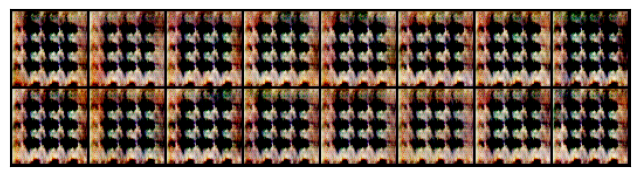

100%|██████████| 7/7 [00:00<00:00, 20.87it/s]


Epoch [52/100], loss_g: 0.0309, loss_d: 0.6692, real_score: 0.6314, fake_score: 0.8487


100%|██████████| 7/7 [00:00<00:00, 22.38it/s]


Epoch [53/100], loss_g: 0.0134, loss_d: 0.5662, real_score: 0.6594, fake_score: 0.8462


100%|██████████| 7/7 [00:00<00:00, 22.48it/s]


Epoch [54/100], loss_g: 0.0166, loss_d: 0.5458, real_score: 0.6334, fake_score: 0.8361


100%|██████████| 7/7 [00:00<00:00, 22.94it/s]


Epoch [55/100], loss_g: 0.0133, loss_d: 0.6199, real_score: 0.6239, fake_score: 0.8384


100%|██████████| 7/7 [00:00<00:00, 24.05it/s]


Epoch [56/100], loss_g: 0.0262, loss_d: 0.5470, real_score: 0.6410, fake_score: 0.8294


100%|██████████| 7/7 [00:00<00:00, 21.49it/s]


Epoch [57/100], loss_g: 0.0125, loss_d: 0.5683, real_score: 0.6681, fake_score: 0.8446


100%|██████████| 7/7 [00:00<00:00, 23.74it/s]


Epoch [58/100], loss_g: 0.0172, loss_d: 0.5655, real_score: 0.6817, fake_score: 0.8318


100%|██████████| 7/7 [00:00<00:00, 25.00it/s]


Epoch [59/100], loss_g: 0.0125, loss_d: 0.5873, real_score: 0.7024, fake_score: 0.8350


100%|██████████| 7/7 [00:00<00:00, 24.24it/s]


Epoch [60/100], loss_g: 0.0193, loss_d: 0.5866, real_score: 0.6347, fake_score: 0.8378


100%|██████████| 7/7 [00:00<00:00, 20.06it/s]


Epoch [61/100], loss_g: 0.0117, loss_d: 0.5757, real_score: 0.6318, fake_score: 0.8481
Saving generated-images-0061.png


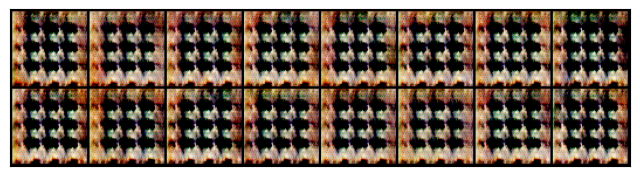

100%|██████████| 7/7 [00:00<00:00, 21.21it/s]


Epoch [62/100], loss_g: 0.0254, loss_d: 0.5018, real_score: 0.6975, fake_score: 0.8317


100%|██████████| 7/7 [00:00<00:00, 23.52it/s]


Epoch [63/100], loss_g: 0.0222, loss_d: 0.5812, real_score: 0.6973, fake_score: 0.8390


100%|██████████| 7/7 [00:00<00:00, 24.67it/s]


Epoch [64/100], loss_g: 0.0263, loss_d: 0.5781, real_score: 0.6304, fake_score: 0.8364


100%|██████████| 7/7 [00:00<00:00, 24.12it/s]


Epoch [65/100], loss_g: 0.0315, loss_d: 0.5729, real_score: 0.6748, fake_score: 0.8426


100%|██████████| 7/7 [00:00<00:00, 24.29it/s]


Epoch [66/100], loss_g: 0.0215, loss_d: 0.5872, real_score: 0.6485, fake_score: 0.8357


100%|██████████| 7/7 [00:00<00:00, 24.58it/s]


Epoch [67/100], loss_g: 0.0130, loss_d: 0.5605, real_score: 0.6727, fake_score: 0.8195


100%|██████████| 7/7 [00:00<00:00, 24.17it/s]


Epoch [68/100], loss_g: 0.0192, loss_d: 0.6036, real_score: 0.6400, fake_score: 0.8530


100%|██████████| 7/7 [00:00<00:00, 23.24it/s]


Epoch [69/100], loss_g: 0.0111, loss_d: 0.6106, real_score: 0.6681, fake_score: 0.8513


100%|██████████| 7/7 [00:00<00:00, 20.84it/s]


Epoch [70/100], loss_g: 0.0187, loss_d: 0.6116, real_score: 0.6702, fake_score: 0.8416


100%|██████████| 7/7 [00:00<00:00, 22.74it/s]


Epoch [71/100], loss_g: 0.0137, loss_d: 0.4982, real_score: 0.6903, fake_score: 0.8147
Saving generated-images-0071.png


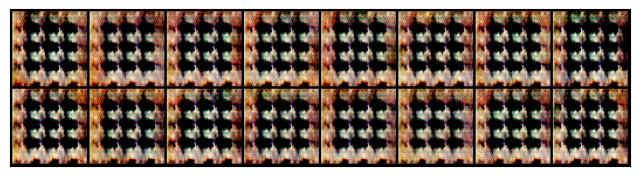

100%|██████████| 7/7 [00:00<00:00, 11.71it/s]


Epoch [72/100], loss_g: 0.0081, loss_d: 0.5255, real_score: 0.6635, fake_score: 0.8397


100%|██████████| 7/7 [00:00<00:00, 22.72it/s]


Epoch [73/100], loss_g: 0.0151, loss_d: 0.5926, real_score: 0.6501, fake_score: 0.8231


100%|██████████| 7/7 [00:00<00:00, 20.78it/s]


Epoch [74/100], loss_g: 0.0356, loss_d: 0.4955, real_score: 0.6800, fake_score: 0.8266


100%|██████████| 7/7 [00:00<00:00, 22.53it/s]


Epoch [75/100], loss_g: 0.0195, loss_d: 0.5539, real_score: 0.7071, fake_score: 0.8150


100%|██████████| 7/7 [00:00<00:00, 22.71it/s]


Epoch [76/100], loss_g: 0.0071, loss_d: 0.5785, real_score: 0.6644, fake_score: 0.8630


100%|██████████| 7/7 [00:00<00:00, 20.37it/s]


Epoch [77/100], loss_g: 0.0148, loss_d: 0.5899, real_score: 0.6567, fake_score: 0.8571


100%|██████████| 7/7 [00:00<00:00, 22.70it/s]


Epoch [78/100], loss_g: 0.0104, loss_d: 0.6332, real_score: 0.6579, fake_score: 0.8297


100%|██████████| 7/7 [00:00<00:00, 21.80it/s]


Epoch [79/100], loss_g: 0.0236, loss_d: 0.5641, real_score: 0.6025, fake_score: 0.8251


100%|██████████| 7/7 [00:00<00:00, 20.74it/s]


Epoch [80/100], loss_g: 0.0214, loss_d: 0.4890, real_score: 0.7002, fake_score: 0.8420


100%|██████████| 7/7 [00:00<00:00, 20.27it/s]


Epoch [81/100], loss_g: 0.0241, loss_d: 0.4704, real_score: 0.6661, fake_score: 0.8401
Saving generated-images-0081.png


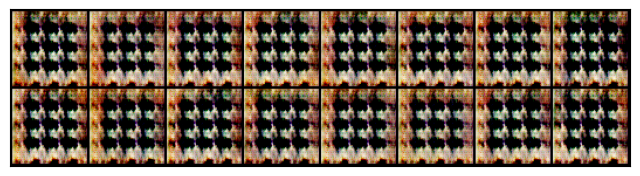

100%|██████████| 7/7 [00:00<00:00, 22.75it/s]


Epoch [82/100], loss_g: 0.0304, loss_d: 0.5396, real_score: 0.6553, fake_score: 0.8452


100%|██████████| 7/7 [00:00<00:00, 22.49it/s]


Epoch [83/100], loss_g: 0.0120, loss_d: 0.5368, real_score: 0.6839, fake_score: 0.8504


100%|██████████| 7/7 [00:00<00:00, 19.94it/s]


Epoch [84/100], loss_g: 0.0255, loss_d: 0.5630, real_score: 0.6628, fake_score: 0.8418


100%|██████████| 7/7 [00:00<00:00, 13.83it/s]


Epoch [85/100], loss_g: 0.0109, loss_d: 0.5690, real_score: 0.6519, fake_score: 0.8257


100%|██████████| 7/7 [00:00<00:00, 22.42it/s]


Epoch [86/100], loss_g: 0.0106, loss_d: 0.5477, real_score: 0.6811, fake_score: 0.8442


100%|██████████| 7/7 [00:00<00:00, 23.78it/s]


Epoch [87/100], loss_g: 0.0082, loss_d: 0.5593, real_score: 0.6849, fake_score: 0.8415


100%|██████████| 7/7 [00:00<00:00, 23.03it/s]


Epoch [88/100], loss_g: 0.0107, loss_d: 0.6031, real_score: 0.6689, fake_score: 0.8523


100%|██████████| 7/7 [00:00<00:00, 23.52it/s]


Epoch [89/100], loss_g: 0.0202, loss_d: 0.5597, real_score: 0.6376, fake_score: 0.8319


100%|██████████| 7/7 [00:00<00:00, 23.54it/s]


Epoch [90/100], loss_g: 0.0129, loss_d: 0.4858, real_score: 0.6604, fake_score: 0.8202


100%|██████████| 7/7 [00:00<00:00, 23.80it/s]


Epoch [91/100], loss_g: 0.0162, loss_d: 0.5298, real_score: 0.7100, fake_score: 0.8263
Saving generated-images-0091.png


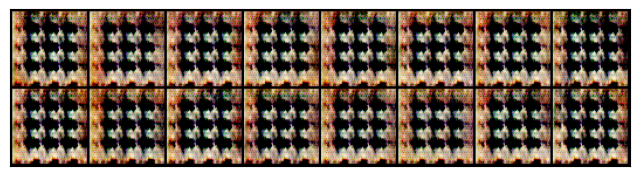

100%|██████████| 7/7 [00:00<00:00, 13.84it/s]


Epoch [92/100], loss_g: 0.0241, loss_d: 0.4681, real_score: 0.6546, fake_score: 0.8073


100%|██████████| 7/7 [00:00<00:00, 16.21it/s]


Epoch [93/100], loss_g: 0.0085, loss_d: 0.5191, real_score: 0.6912, fake_score: 0.8194


100%|██████████| 7/7 [00:00<00:00, 17.89it/s]


Epoch [94/100], loss_g: 0.0236, loss_d: 0.6172, real_score: 0.6316, fake_score: 0.8409


100%|██████████| 7/7 [00:00<00:00, 18.86it/s]


Epoch [95/100], loss_g: 0.0200, loss_d: 0.4869, real_score: 0.6502, fake_score: 0.8342


100%|██████████| 7/7 [00:00<00:00, 20.30it/s]


Epoch [96/100], loss_g: 0.0235, loss_d: 0.5673, real_score: 0.6362, fake_score: 0.8315


100%|██████████| 7/7 [00:00<00:00, 21.22it/s]


Epoch [97/100], loss_g: 0.0217, loss_d: 0.5960, real_score: 0.6518, fake_score: 0.8439


100%|██████████| 7/7 [00:00<00:00, 22.66it/s]


Epoch [98/100], loss_g: 0.0317, loss_d: 0.5001, real_score: 0.6787, fake_score: 0.8268


100%|██████████| 7/7 [00:00<00:00, 21.84it/s]


Epoch [99/100], loss_g: 0.0140, loss_d: 0.4716, real_score: 0.6678, fake_score: 0.8205


100%|██████████| 7/7 [00:00<00:00, 21.35it/s]

Epoch [100/100], loss_g: 0.0126, loss_d: 0.6221, real_score: 0.6246, fake_score: 0.8393


In [ ]:
# Complete the training function

losses_g = []
losses_d = []
real_scores = []
fake_scores = []
# Freeze all parameters in the models
for param in generator.parameters():
    param.requires_grad = True
for param in discriminator.parameters():
    param.requires_grad = False


# Unfreeze LoRA parameters in the generator
generator.A_matrix.requires_grad = True
generator.B_matrix.requires_grad = True
fixed_latent = torch.randn(16, 128, 1, 1, device=device)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)

optimizer_g = torch.optim.Adam(filter(lambda p: p.requires_grad, generator.parameters()), lr=0.0002, betas=(0.5, 0.999))
# optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
def train(D, G, d_optimizer, g_optimizer, epochs=1):
    iter_count = 0
    start_idx=1
    for epoch in range(epochs):
        for real_images in tqdm(dataloader):
            real_images=real_images.to(device)
            # Pass real images through discriminator
            D_out_real = D(real_images)
            label_real = torch.full(D_out_real.shape, 1.0).to(torch.device(device))
            real_loss = Real_loss(label_real,D_out_real)
            real_score = torch.mean(D_out_real).item()

            # Generate fake images
            noise = torch.randn(16, latent_size, 1, 1).to(torch.device(device))
            fake_images =  G(noise)

            # Pass fake images through discriminator
            D_out_fake = D(fake_images)
            label_fake =  torch.full(D_out_fake.shape, 0).to(torch.device(device))
            fake_loss = Fake_loss(label_fake, D_out_fake)
            fake_score = torch.mean(D_out_fake).item()

            # Update discriminator weights
            loss_d = real_loss + fake_loss

            d_optimizer.zero_grad()
            # loss_d.backward(retain_graph = True)
            d_optimizer.step()

            # Generate fake images
            noise2 = torch.randn(16, latent_size, 1, 1).to(torch.device(device))
            fake_images2 =  G(noise2)

            gen_steps = 1
            for i in range(0, gen_steps ):
            # Try to fool the discriminator
                D_out_fake2 = D(fake_images2)

                # The label is set to 1(real-like) to fool the discriminator
                label_real1 = torch.full(D_out_fake2.shape, 1.0).to(torch.device(device))
                loss_g = Real_loss(label_real1, D_out_fake2)

                # Update generator weights
                g_optimizer.zero_grad()
                loss_g.backward(retain_graph = (i<gen_steps -1 ))
                g_optimizer.step()


        losses_g.append(loss_g.item())
        losses_d.append(loss_d.item())
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
        epoch+1, epochs, loss_g, loss_d, real_score, fake_score))

        # Save generated images
        if epoch % 10 == 0:
          save_samples(epoch+start_idx, fixed_latent,G, show=True)

          state_dis = {'dis_model': D.state_dict(), 'epoch': epoch}
          state_gen = {'gen_model': G.state_dict(), 'epoch': epoch}
          if not os.path.isdir('checkpoint'):
              os.mkdir('checkpoint')
          torch.save(state_dis, 'checkpoint/'+'D__'+str(epoch+1)) #each epoch
        torch.save(state_gen, 'checkpoint/'+'G__'+str(epoch+1)) #each epoch
#Train the GAN
train(discriminator,generator,optimizer_d ,optimizer_g,epochs=100)

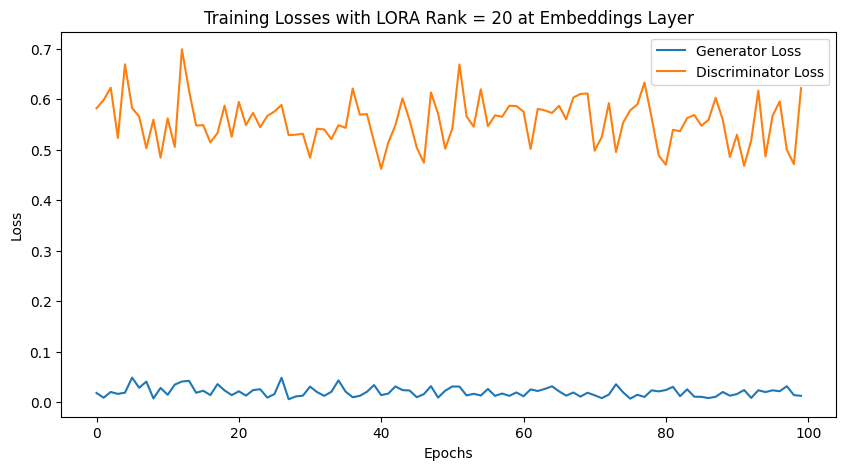

In [ ]:
import matplotlib.pyplot as plt

# Assuming losses_g and losses_d are populated with loss values from each epoch
plt.figure(figsize=(10, 5))

# Plotting Generator loss
plt.plot(losses_g, label='Generator Loss')

# Plotting Discriminator loss
plt.plot(losses_d, label='Discriminator Loss')

# Adding titles and labels
plt.title('Training Losses with LORA Rank = 20 at Embeddings Layer')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Displaying the plot
plt.show()


Inducing diversity with anime dataset

In [ ]:
generator = generator_with_lora

In [ ]:
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import os

class AnimeFaceDataset(Dataset):
    def __init__(self, directory, num_images=None, transform=None):
        self.directory = directory
        self.transform = transform
        self.images = os.listdir(directory)
        if num_images is not None:
            self.images = self.images[:num_images]

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_name = os.path.join(self.directory, self.images[idx])
        image = Image.open(img_name)
        if self.transform:
            image = self.transform(image)
        return image

transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor(),
])

# Load only 10000 images
num_images_to_load = 1000
dataset = AnimeFaceDataset(directory='/content/drive/MyDrive/CS182-Research/images', num_images=num_images_to_load, transform=transform)
dataloader = DataLoader(dataset, batch_size=128, shuffle=True)


100%|██████████| 8/8 [03:12<00:00, 24.06s/it]


Epoch [1/100], loss_g: 0.0221, loss_d: 0.5265, real_score: 0.6737, fake_score: 0.8470
Saving generated-images-0001.png


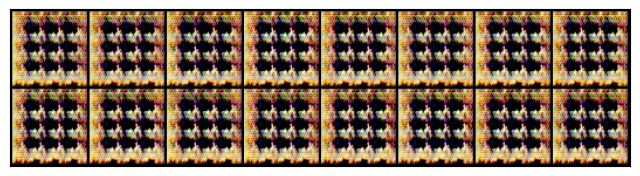

100%|██████████| 8/8 [00:02<00:00,  3.72it/s]


Epoch [2/100], loss_g: 0.0277, loss_d: 0.5286, real_score: 0.6720, fake_score: 0.8223


100%|██████████| 8/8 [00:02<00:00,  3.80it/s]


Epoch [3/100], loss_g: 0.0143, loss_d: 0.5495, real_score: 0.6667, fake_score: 0.8388


100%|██████████| 8/8 [00:02<00:00,  3.61it/s]


Epoch [4/100], loss_g: 0.0071, loss_d: 0.5310, real_score: 0.6710, fake_score: 0.8391


100%|██████████| 8/8 [00:02<00:00,  3.76it/s]


Epoch [5/100], loss_g: 0.0142, loss_d: 0.5246, real_score: 0.6637, fake_score: 0.8350


100%|██████████| 8/8 [00:02<00:00,  3.95it/s]


Epoch [6/100], loss_g: 0.0186, loss_d: 0.5291, real_score: 0.6690, fake_score: 0.8322


100%|██████████| 8/8 [00:02<00:00,  3.85it/s]


Epoch [7/100], loss_g: 0.0124, loss_d: 0.5355, real_score: 0.6668, fake_score: 0.8264


100%|██████████| 8/8 [00:02<00:00,  3.86it/s]


Epoch [8/100], loss_g: 0.0090, loss_d: 0.5421, real_score: 0.6743, fake_score: 0.8238


100%|██████████| 8/8 [00:02<00:00,  3.97it/s]


Epoch [9/100], loss_g: 0.0327, loss_d: 0.5369, real_score: 0.6734, fake_score: 0.8296


100%|██████████| 8/8 [00:02<00:00,  3.74it/s]


Epoch [10/100], loss_g: 0.0162, loss_d: 0.4572, real_score: 0.6734, fake_score: 0.8539


100%|██████████| 8/8 [00:02<00:00,  3.77it/s]


Epoch [11/100], loss_g: 0.0225, loss_d: 0.5100, real_score: 0.6764, fake_score: 0.8075
Saving generated-images-0011.png


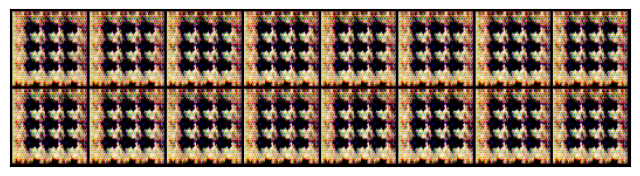

100%|██████████| 8/8 [00:02<00:00,  3.83it/s]


Epoch [12/100], loss_g: 0.0284, loss_d: 0.5495, real_score: 0.6640, fake_score: 0.8430


100%|██████████| 8/8 [00:02<00:00,  3.79it/s]


Epoch [13/100], loss_g: 0.0158, loss_d: 0.5087, real_score: 0.6724, fake_score: 0.8419


100%|██████████| 8/8 [00:02<00:00,  3.78it/s]


Epoch [14/100], loss_g: 0.0151, loss_d: 0.5818, real_score: 0.6690, fake_score: 0.8487


100%|██████████| 8/8 [00:02<00:00,  3.85it/s]


Epoch [15/100], loss_g: 0.0090, loss_d: 0.5576, real_score: 0.6702, fake_score: 0.8455


100%|██████████| 8/8 [00:02<00:00,  3.61it/s]


Epoch [16/100], loss_g: 0.0212, loss_d: 0.5159, real_score: 0.6769, fake_score: 0.8254


100%|██████████| 8/8 [00:02<00:00,  3.66it/s]


Epoch [17/100], loss_g: 0.0176, loss_d: 0.4790, real_score: 0.6662, fake_score: 0.8495


100%|██████████| 8/8 [00:02<00:00,  3.74it/s]


Epoch [18/100], loss_g: 0.0108, loss_d: 0.5480, real_score: 0.6728, fake_score: 0.8374


100%|██████████| 8/8 [00:02<00:00,  3.84it/s]


Epoch [19/100], loss_g: 0.0254, loss_d: 0.5713, real_score: 0.6657, fake_score: 0.8419


100%|██████████| 8/8 [00:02<00:00,  3.83it/s]


Epoch [20/100], loss_g: 0.0148, loss_d: 0.5490, real_score: 0.6760, fake_score: 0.8330


100%|██████████| 8/8 [00:02<00:00,  3.87it/s]


Epoch [21/100], loss_g: 0.0312, loss_d: 0.5337, real_score: 0.6688, fake_score: 0.8292
Saving generated-images-0021.png


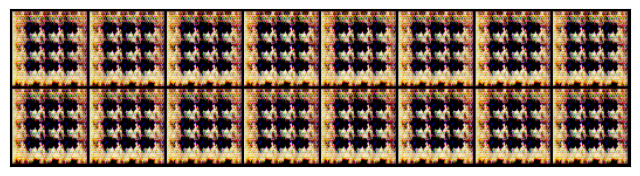

100%|██████████| 8/8 [00:02<00:00,  3.71it/s]


Epoch [22/100], loss_g: 0.0226, loss_d: 0.5290, real_score: 0.6708, fake_score: 0.8280


100%|██████████| 8/8 [00:02<00:00,  3.60it/s]


Epoch [23/100], loss_g: 0.0139, loss_d: 0.4595, real_score: 0.6709, fake_score: 0.8264


100%|██████████| 8/8 [00:02<00:00,  3.73it/s]


Epoch [24/100], loss_g: 0.0153, loss_d: 0.5666, real_score: 0.6721, fake_score: 0.8361


100%|██████████| 8/8 [00:02<00:00,  3.81it/s]


Epoch [25/100], loss_g: 0.0161, loss_d: 0.4520, real_score: 0.6696, fake_score: 0.8124


100%|██████████| 8/8 [00:02<00:00,  3.83it/s]


Epoch [26/100], loss_g: 0.0198, loss_d: 0.5943, real_score: 0.6633, fake_score: 0.8355


100%|██████████| 8/8 [00:02<00:00,  3.78it/s]


Epoch [27/100], loss_g: 0.0242, loss_d: 0.4869, real_score: 0.6746, fake_score: 0.8387


100%|██████████| 8/8 [00:02<00:00,  3.86it/s]


Epoch [28/100], loss_g: 0.0192, loss_d: 0.5353, real_score: 0.6658, fake_score: 0.8387


100%|██████████| 8/8 [00:02<00:00,  3.65it/s]


Epoch [29/100], loss_g: 0.0155, loss_d: 0.5060, real_score: 0.6718, fake_score: 0.8172


100%|██████████| 8/8 [00:02<00:00,  3.59it/s]


Epoch [30/100], loss_g: 0.0298, loss_d: 0.5798, real_score: 0.6714, fake_score: 0.8267


100%|██████████| 8/8 [00:02<00:00,  3.70it/s]


Epoch [31/100], loss_g: 0.0185, loss_d: 0.5298, real_score: 0.6587, fake_score: 0.8308
Saving generated-images-0031.png


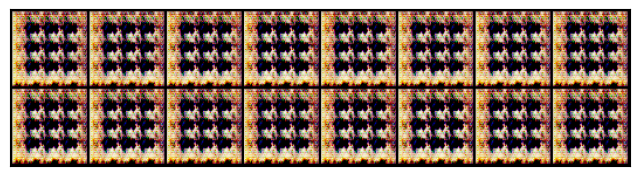

100%|██████████| 8/8 [00:02<00:00,  3.79it/s]


Epoch [32/100], loss_g: 0.0343, loss_d: 0.6368, real_score: 0.6637, fake_score: 0.8404


100%|██████████| 8/8 [00:02<00:00,  3.91it/s]


Epoch [33/100], loss_g: 0.0155, loss_d: 0.5650, real_score: 0.6736, fake_score: 0.8375


100%|██████████| 8/8 [00:02<00:00,  3.84it/s]


Epoch [34/100], loss_g: 0.0407, loss_d: 0.6085, real_score: 0.6751, fake_score: 0.8394


100%|██████████| 8/8 [00:02<00:00,  3.73it/s]


Epoch [35/100], loss_g: 0.0153, loss_d: 0.5288, real_score: 0.6686, fake_score: 0.8309


100%|██████████| 8/8 [00:02<00:00,  3.59it/s]


Epoch [36/100], loss_g: 0.0226, loss_d: 0.5390, real_score: 0.6733, fake_score: 0.8133


100%|██████████| 8/8 [00:02<00:00,  3.68it/s]


Epoch [37/100], loss_g: 0.0241, loss_d: 0.5395, real_score: 0.6651, fake_score: 0.8343


100%|██████████| 8/8 [00:02<00:00,  3.90it/s]


Epoch [38/100], loss_g: 0.0176, loss_d: 0.5607, real_score: 0.6715, fake_score: 0.8302


100%|██████████| 8/8 [00:02<00:00,  3.80it/s]


Epoch [39/100], loss_g: 0.0182, loss_d: 0.5467, real_score: 0.6638, fake_score: 0.8287


100%|██████████| 8/8 [00:02<00:00,  3.84it/s]


Epoch [40/100], loss_g: 0.0178, loss_d: 0.6213, real_score: 0.6642, fake_score: 0.8395


100%|██████████| 8/8 [00:02<00:00,  3.73it/s]


Epoch [41/100], loss_g: 0.0172, loss_d: 0.4458, real_score: 0.6706, fake_score: 0.8384
Saving generated-images-0041.png


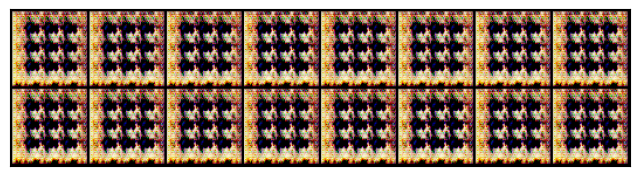

100%|██████████| 8/8 [00:02<00:00,  3.63it/s]


Epoch [42/100], loss_g: 0.0172, loss_d: 0.5724, real_score: 0.6611, fake_score: 0.8161


100%|██████████| 8/8 [00:02<00:00,  3.62it/s]


Epoch [43/100], loss_g: 0.0122, loss_d: 0.5537, real_score: 0.6668, fake_score: 0.8431


100%|██████████| 8/8 [00:02<00:00,  3.74it/s]


Epoch [44/100], loss_g: 0.0191, loss_d: 0.6024, real_score: 0.6712, fake_score: 0.8356


100%|██████████| 8/8 [00:02<00:00,  3.91it/s]


Epoch [45/100], loss_g: 0.0290, loss_d: 0.5706, real_score: 0.6752, fake_score: 0.8314


100%|██████████| 8/8 [00:02<00:00,  3.89it/s]


Epoch [46/100], loss_g: 0.0361, loss_d: 0.5113, real_score: 0.6752, fake_score: 0.8272


100%|██████████| 8/8 [00:02<00:00,  3.82it/s]


Epoch [47/100], loss_g: 0.0149, loss_d: 0.5515, real_score: 0.6687, fake_score: 0.8300


100%|██████████| 8/8 [00:02<00:00,  3.55it/s]


Epoch [48/100], loss_g: 0.0215, loss_d: 0.5476, real_score: 0.6677, fake_score: 0.8332


100%|██████████| 8/8 [00:02<00:00,  3.66it/s]


Epoch [49/100], loss_g: 0.0116, loss_d: 0.5430, real_score: 0.6680, fake_score: 0.8303


100%|██████████| 8/8 [00:02<00:00,  3.77it/s]


Epoch [50/100], loss_g: 0.0387, loss_d: 0.5453, real_score: 0.6664, fake_score: 0.8420


100%|██████████| 8/8 [00:02<00:00,  3.83it/s]


Epoch [51/100], loss_g: 0.0227, loss_d: 0.5752, real_score: 0.6773, fake_score: 0.8361
Saving generated-images-0051.png


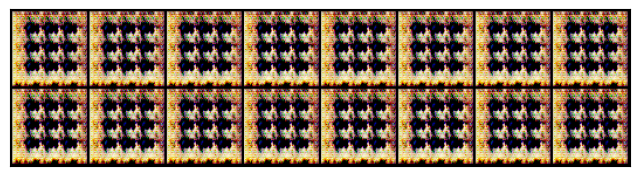

100%|██████████| 8/8 [00:02<00:00,  3.81it/s]


Epoch [52/100], loss_g: 0.0206, loss_d: 0.4957, real_score: 0.6708, fake_score: 0.8306


100%|██████████| 8/8 [00:02<00:00,  3.89it/s]


Epoch [53/100], loss_g: 0.0128, loss_d: 0.4435, real_score: 0.6728, fake_score: 0.8336


100%|██████████| 8/8 [00:02<00:00,  3.67it/s]


Epoch [54/100], loss_g: 0.0086, loss_d: 0.5399, real_score: 0.6707, fake_score: 0.8383


100%|██████████| 8/8 [00:02<00:00,  3.56it/s]


Epoch [55/100], loss_g: 0.0113, loss_d: 0.5266, real_score: 0.6704, fake_score: 0.8390


100%|██████████| 8/8 [00:02<00:00,  3.75it/s]


Epoch [56/100], loss_g: 0.0122, loss_d: 0.5323, real_score: 0.6667, fake_score: 0.8599


100%|██████████| 8/8 [00:02<00:00,  3.83it/s]


Epoch [57/100], loss_g: 0.0320, loss_d: 0.5823, real_score: 0.6696, fake_score: 0.8515


100%|██████████| 8/8 [00:02<00:00,  3.81it/s]


Epoch [58/100], loss_g: 0.0153, loss_d: 0.6105, real_score: 0.6674, fake_score: 0.8472


100%|██████████| 8/8 [00:02<00:00,  3.79it/s]


Epoch [59/100], loss_g: 0.0155, loss_d: 0.5218, real_score: 0.6600, fake_score: 0.8386


100%|██████████| 8/8 [00:02<00:00,  3.81it/s]


Epoch [60/100], loss_g: 0.0116, loss_d: 0.5943, real_score: 0.6675, fake_score: 0.8356


100%|██████████| 8/8 [00:02<00:00,  3.65it/s]


Epoch [61/100], loss_g: 0.0196, loss_d: 0.5843, real_score: 0.6659, fake_score: 0.8463
Saving generated-images-0061.png


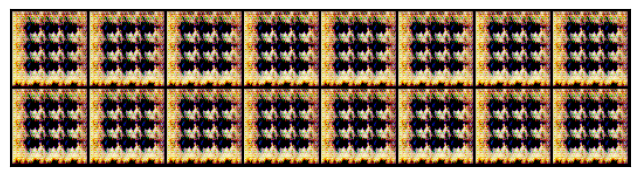

100%|██████████| 8/8 [00:02<00:00,  3.74it/s]


Epoch [62/100], loss_g: 0.0354, loss_d: 0.6054, real_score: 0.6675, fake_score: 0.8332


100%|██████████| 8/8 [00:02<00:00,  3.75it/s]


Epoch [63/100], loss_g: 0.0374, loss_d: 0.5192, real_score: 0.6742, fake_score: 0.8243


100%|██████████| 8/8 [00:02<00:00,  3.83it/s]


Epoch [64/100], loss_g: 0.0159, loss_d: 0.5979, real_score: 0.6693, fake_score: 0.8281


100%|██████████| 8/8 [00:02<00:00,  3.77it/s]


Epoch [65/100], loss_g: 0.0158, loss_d: 0.4926, real_score: 0.6742, fake_score: 0.8210


100%|██████████| 8/8 [00:02<00:00,  3.77it/s]


Epoch [66/100], loss_g: 0.0138, loss_d: 0.5530, real_score: 0.6721, fake_score: 0.8429


100%|██████████| 8/8 [00:02<00:00,  3.65it/s]


Epoch [67/100], loss_g: 0.0119, loss_d: 0.5357, real_score: 0.6654, fake_score: 0.8338


100%|██████████| 8/8 [00:02<00:00,  3.65it/s]


Epoch [68/100], loss_g: 0.0110, loss_d: 0.5201, real_score: 0.6682, fake_score: 0.8335


100%|██████████| 8/8 [00:02<00:00,  3.88it/s]


Epoch [69/100], loss_g: 0.0360, loss_d: 0.5269, real_score: 0.6675, fake_score: 0.8231


100%|██████████| 8/8 [00:02<00:00,  3.87it/s]


Epoch [70/100], loss_g: 0.0145, loss_d: 0.5200, real_score: 0.6649, fake_score: 0.8316


100%|██████████| 8/8 [00:02<00:00,  3.78it/s]


Epoch [71/100], loss_g: 0.0322, loss_d: 0.4569, real_score: 0.6640, fake_score: 0.8428
Saving generated-images-0071.png


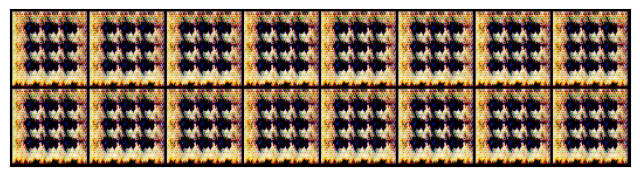

100%|██████████| 8/8 [00:02<00:00,  3.82it/s]


Epoch [72/100], loss_g: 0.0061, loss_d: 0.5160, real_score: 0.6669, fake_score: 0.8370


100%|██████████| 8/8 [00:02<00:00,  3.65it/s]


Epoch [73/100], loss_g: 0.0157, loss_d: 0.6036, real_score: 0.6631, fake_score: 0.8415


100%|██████████| 8/8 [00:02<00:00,  3.66it/s]


Epoch [74/100], loss_g: 0.0163, loss_d: 0.4813, real_score: 0.6575, fake_score: 0.8357


100%|██████████| 8/8 [00:02<00:00,  3.66it/s]


Epoch [75/100], loss_g: 0.0122, loss_d: 0.5480, real_score: 0.6688, fake_score: 0.8446


100%|██████████| 8/8 [00:02<00:00,  3.74it/s]


Epoch [76/100], loss_g: 0.0207, loss_d: 0.5896, real_score: 0.6728, fake_score: 0.8430


100%|██████████| 8/8 [00:02<00:00,  3.71it/s]


Epoch [77/100], loss_g: 0.0097, loss_d: 0.6446, real_score: 0.6666, fake_score: 0.8564


100%|██████████| 8/8 [00:02<00:00,  3.80it/s]


Epoch [78/100], loss_g: 0.0098, loss_d: 0.5402, real_score: 0.6656, fake_score: 0.8460


100%|██████████| 8/8 [00:02<00:00,  3.72it/s]


Epoch [79/100], loss_g: 0.0122, loss_d: 0.5572, real_score: 0.6643, fake_score: 0.8482


100%|██████████| 8/8 [00:02<00:00,  3.59it/s]


Epoch [80/100], loss_g: 0.0147, loss_d: 0.4753, real_score: 0.6698, fake_score: 0.8289


100%|██████████| 8/8 [00:02<00:00,  3.65it/s]


Epoch [81/100], loss_g: 0.0201, loss_d: 0.5787, real_score: 0.6745, fake_score: 0.8325
Saving generated-images-0081.png


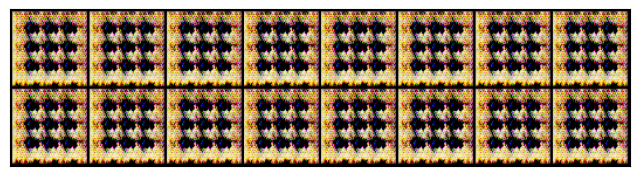

100%|██████████| 8/8 [00:02<00:00,  3.92it/s]


Epoch [82/100], loss_g: 0.0261, loss_d: 0.5645, real_score: 0.6689, fake_score: 0.8502


100%|██████████| 8/8 [00:02<00:00,  3.94it/s]


Epoch [83/100], loss_g: 0.0210, loss_d: 0.5257, real_score: 0.6731, fake_score: 0.8567


100%|██████████| 8/8 [00:02<00:00,  3.82it/s]


Epoch [84/100], loss_g: 0.0098, loss_d: 0.6234, real_score: 0.6659, fake_score: 0.8502


100%|██████████| 8/8 [00:02<00:00,  3.84it/s]


Epoch [85/100], loss_g: 0.0263, loss_d: 0.5650, real_score: 0.6704, fake_score: 0.8336


100%|██████████| 8/8 [00:02<00:00,  3.62it/s]


Epoch [86/100], loss_g: 0.0236, loss_d: 0.5225, real_score: 0.6656, fake_score: 0.8417


100%|██████████| 8/8 [00:02<00:00,  3.64it/s]


Epoch [87/100], loss_g: 0.0102, loss_d: 0.5749, real_score: 0.6705, fake_score: 0.8401


100%|██████████| 8/8 [00:02<00:00,  3.81it/s]


Epoch [88/100], loss_g: 0.0273, loss_d: 0.5700, real_score: 0.6659, fake_score: 0.8297


100%|██████████| 8/8 [00:02<00:00,  3.83it/s]


Epoch [89/100], loss_g: 0.0204, loss_d: 0.5277, real_score: 0.6686, fake_score: 0.8430


100%|██████████| 8/8 [00:02<00:00,  3.78it/s]


Epoch [90/100], loss_g: 0.0461, loss_d: 0.5703, real_score: 0.6683, fake_score: 0.8427


100%|██████████| 8/8 [00:02<00:00,  3.79it/s]


Epoch [91/100], loss_g: 0.0093, loss_d: 0.6226, real_score: 0.6668, fake_score: 0.8384
Saving generated-images-0091.png


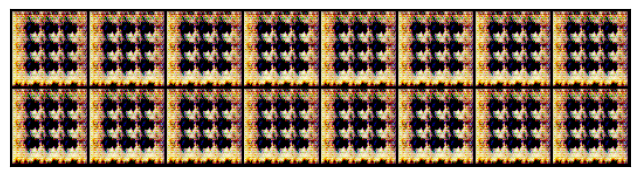

100%|██████████| 8/8 [00:02<00:00,  3.71it/s]


Epoch [92/100], loss_g: 0.0143, loss_d: 0.5556, real_score: 0.6644, fake_score: 0.8339


100%|██████████| 8/8 [00:02<00:00,  3.58it/s]


Epoch [93/100], loss_g: 0.0236, loss_d: 0.5503, real_score: 0.6619, fake_score: 0.8309


100%|██████████| 8/8 [00:02<00:00,  3.68it/s]


Epoch [94/100], loss_g: 0.0132, loss_d: 0.5087, real_score: 0.6637, fake_score: 0.8393


100%|██████████| 8/8 [00:02<00:00,  3.77it/s]


Epoch [95/100], loss_g: 0.0086, loss_d: 0.5331, real_score: 0.6693, fake_score: 0.8381


100%|██████████| 8/8 [00:02<00:00,  3.81it/s]


Epoch [96/100], loss_g: 0.0282, loss_d: 0.5004, real_score: 0.6728, fake_score: 0.8458


100%|██████████| 8/8 [00:02<00:00,  3.75it/s]


Epoch [97/100], loss_g: 0.0114, loss_d: 0.5114, real_score: 0.6654, fake_score: 0.8200


100%|██████████| 8/8 [00:02<00:00,  3.74it/s]


Epoch [98/100], loss_g: 0.0188, loss_d: 0.5824, real_score: 0.6680, fake_score: 0.8346


100%|██████████| 8/8 [00:02<00:00,  3.56it/s]


Epoch [99/100], loss_g: 0.0210, loss_d: 0.5276, real_score: 0.6726, fake_score: 0.8445


100%|██████████| 8/8 [00:02<00:00,  3.64it/s]

Epoch [100/100], loss_g: 0.0282, loss_d: 0.5273, real_score: 0.6767, fake_score: 0.8260


In [ ]:
# Complete the training function

losses_g = []
losses_d = []
real_scores = []
fake_scores = []
# Freeze all parameters in the models
for param in generator.parameters():
    param.requires_grad = True
for param in discriminator.parameters():
    param.requires_grad = False


# Unfreeze LoRA parameters in the generator
generator.A_matrix.requires_grad = True
generator.B_matrix.requires_grad = True
fixed_latent = torch.randn(16, 128, 1, 1, device=device)
# Move models to the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)

optimizer_g = torch.optim.Adam(filter(lambda p: p.requires_grad, generator.parameters()), lr=0.0002, betas=(0.5, 0.999))
# optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
def train(D, G, d_optimizer, g_optimizer, epochs=1):
    iter_count = 0
    start_idx=1
    for epoch in range(epochs):
        for real_images in tqdm(dataloader):
            real_images=real_images.to(device)
            # Pass real images through discriminator
            D_out_real = D(real_images)
            label_real = torch.full(D_out_real.shape, 1.0).to(torch.device(device))
            real_loss = Real_loss(label_real,D_out_real)
            real_score = torch.mean(D_out_real).item()

            # Generate fake images
            noise = torch.randn(16, latent_size, 1, 1).to(torch.device(device))
            fake_images =  G(noise)

            # Pass fake images through discriminator
            D_out_fake = D(fake_images)
            label_fake =  torch.full(D_out_fake.shape, 0).to(torch.device(device))
            fake_loss = Fake_loss(label_fake, D_out_fake)
            fake_score = torch.mean(D_out_fake).item()

            # Update discriminator weights
            loss_d = real_loss + fake_loss

            d_optimizer.zero_grad()
            # loss_d.backward(retain_graph = True)
            d_optimizer.step()

            # Generate fake images
            noise2 = torch.randn(16, latent_size, 1, 1).to(torch.device(device))
            fake_images2 =  G(noise2)

            gen_steps = 1
            for i in range(0, gen_steps ):
            # Try to fool the discriminator
                D_out_fake2 = D(fake_images2)

                # The label is set to 1(real-like) to fool the discriminator
                label_real1 = torch.full(D_out_fake2.shape, 1.0).to(torch.device(device))
                loss_g = Real_loss(label_real1, D_out_fake2)

                # Update generator weights
                g_optimizer.zero_grad()
                loss_g.backward(retain_graph = (i<gen_steps -1 ))
                g_optimizer.step()


        losses_g.append(loss_g.item())
        losses_d.append(loss_d.item())
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
        epoch+1, epochs, loss_g, loss_d, real_score, fake_score))

        # Save generated images
        if epoch % 10 == 0:
          save_samples(epoch+start_idx, fixed_latent,G, show=True)

          state_dis = {'dis_model': D.state_dict(), 'epoch': epoch}
          state_gen = {'gen_model': G.state_dict(), 'epoch': epoch}
          if not os.path.isdir('checkpoint'):
              os.mkdir('checkpoint')
          torch.save(state_dis, 'checkpoint/'+'D__'+str(epoch+1)) #each epoch
        torch.save(state_gen, 'checkpoint/'+'G__'+str(epoch+1)) #each epoch
#Train the GAN
train(discriminator,generator,optimizer_d ,optimizer_g,epochs=100)

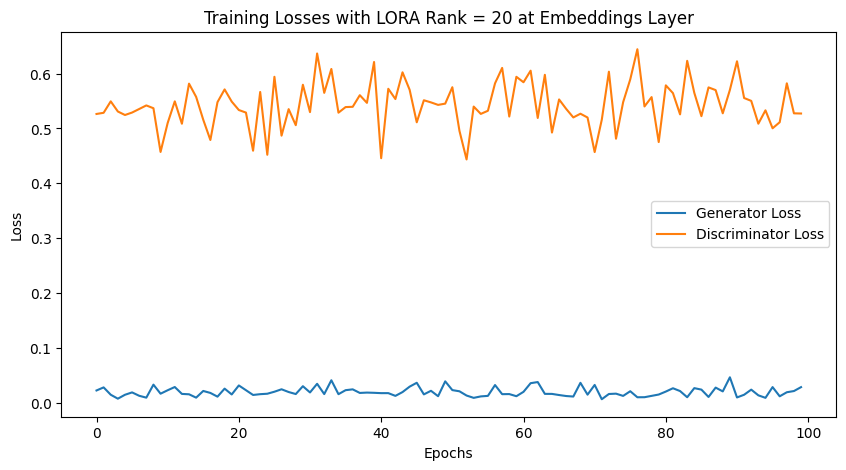

In [ ]:
import matplotlib.pyplot as plt

# Assuming losses_g and losses_d are populated with loss values from each epoch
plt.figure(figsize=(10, 5))

# Plotting Generator loss
plt.plot(losses_g, label='Generator Loss')

# Plotting Discriminator loss
plt.plot(losses_d, label='Discriminator Loss')

# Adding titles and labels
plt.title('Training Losses with LORA Rank = 20 at Embeddings Layer')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Displaying the plot
plt.show()


In [ ]:
generator_with_lora = GeneratorWithLoRA(latent_size=128, lora_rank=100)

current_state_dict = generator_with_lora.state_dict()
for name, param in checkpoint.items():
    if name in current_state_dict:
        current_state_dict[name].copy_(param)
generator_with_lora.load_state_dict(current_state_dict)


<All keys matched successfully>

In [ ]:
generator = generator_with_lora

100%|██████████| 8/8 [00:02<00:00,  3.55it/s]


Epoch [1/100], loss_g: 0.0285, loss_d: 0.5884, real_score: 0.6693, fake_score: 0.8707
Saving generated-images-0001.png


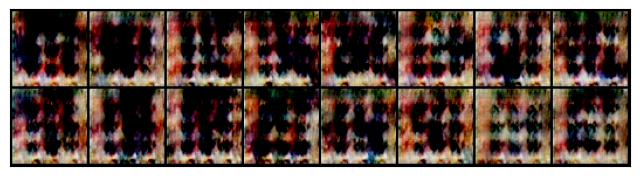

100%|██████████| 8/8 [00:02<00:00,  3.59it/s]


Epoch [2/100], loss_g: 0.0420, loss_d: 0.7087, real_score: 0.6646, fake_score: 0.8832


100%|██████████| 8/8 [00:02<00:00,  3.84it/s]


Epoch [3/100], loss_g: 0.0208, loss_d: 0.5899, real_score: 0.6707, fake_score: 0.8828


100%|██████████| 8/8 [00:02<00:00,  3.87it/s]


Epoch [4/100], loss_g: 0.0161, loss_d: 0.5694, real_score: 0.6702, fake_score: 0.8656


100%|██████████| 8/8 [00:02<00:00,  3.83it/s]


Epoch [5/100], loss_g: 0.0146, loss_d: 0.6332, real_score: 0.6704, fake_score: 0.8794


100%|██████████| 8/8 [00:02<00:00,  3.84it/s]


Epoch [6/100], loss_g: 0.0187, loss_d: 0.5300, real_score: 0.6698, fake_score: 0.8501


100%|██████████| 8/8 [00:02<00:00,  3.94it/s]


Epoch [7/100], loss_g: 0.0196, loss_d: 0.6063, real_score: 0.6754, fake_score: 0.8717


100%|██████████| 8/8 [00:02<00:00,  3.64it/s]


Epoch [8/100], loss_g: 0.0350, loss_d: 0.5616, real_score: 0.6618, fake_score: 0.8294


100%|██████████| 8/8 [00:02<00:00,  3.72it/s]


Epoch [9/100], loss_g: 0.0167, loss_d: 0.5631, real_score: 0.6759, fake_score: 0.8434


100%|██████████| 8/8 [00:02<00:00,  3.86it/s]


Epoch [10/100], loss_g: 0.0138, loss_d: 0.6189, real_score: 0.6716, fake_score: 0.8481


100%|██████████| 8/8 [00:02<00:00,  3.87it/s]


Epoch [11/100], loss_g: 0.0158, loss_d: 0.5438, real_score: 0.6603, fake_score: 0.8232
Saving generated-images-0011.png


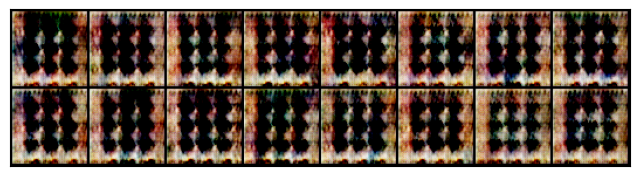

100%|██████████| 8/8 [00:02<00:00,  3.84it/s]


Epoch [12/100], loss_g: 0.0212, loss_d: 0.4876, real_score: 0.6583, fake_score: 0.7906


100%|██████████| 8/8 [00:02<00:00,  3.88it/s]


Epoch [13/100], loss_g: 0.0120, loss_d: 0.5812, real_score: 0.6697, fake_score: 0.8515


100%|██████████| 8/8 [00:02<00:00,  3.74it/s]


Epoch [14/100], loss_g: 0.0205, loss_d: 0.5205, real_score: 0.6702, fake_score: 0.8343


100%|██████████| 8/8 [00:02<00:00,  3.72it/s]


Epoch [15/100], loss_g: 0.0141, loss_d: 0.5507, real_score: 0.6636, fake_score: 0.8174


100%|██████████| 8/8 [00:02<00:00,  3.87it/s]


Epoch [16/100], loss_g: 0.0264, loss_d: 0.6179, real_score: 0.6664, fake_score: 0.8482


100%|██████████| 8/8 [00:02<00:00,  3.84it/s]


Epoch [17/100], loss_g: 0.0257, loss_d: 0.4358, real_score: 0.6713, fake_score: 0.7783


100%|██████████| 8/8 [00:02<00:00,  3.88it/s]


Epoch [18/100], loss_g: 0.0103, loss_d: 0.5464, real_score: 0.6721, fake_score: 0.8170


100%|██████████| 8/8 [00:02<00:00,  3.86it/s]


Epoch [19/100], loss_g: 0.0152, loss_d: 0.5672, real_score: 0.6643, fake_score: 0.8571


100%|██████████| 8/8 [00:02<00:00,  3.79it/s]


Epoch [20/100], loss_g: 0.0241, loss_d: 0.5687, real_score: 0.6781, fake_score: 0.8233


100%|██████████| 8/8 [00:02<00:00,  3.67it/s]


Epoch [21/100], loss_g: 0.0236, loss_d: 0.6190, real_score: 0.6713, fake_score: 0.8350
Saving generated-images-0021.png


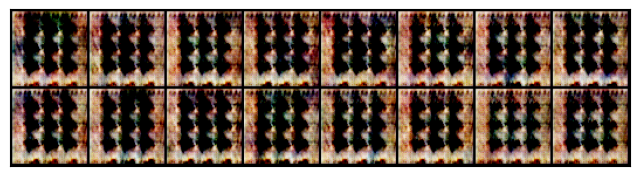

100%|██████████| 8/8 [00:02<00:00,  3.75it/s]


Epoch [22/100], loss_g: 0.0200, loss_d: 0.5258, real_score: 0.6735, fake_score: 0.8438


100%|██████████| 8/8 [00:02<00:00,  3.82it/s]


Epoch [23/100], loss_g: 0.0189, loss_d: 0.5590, real_score: 0.6701, fake_score: 0.8553


100%|██████████| 8/8 [00:02<00:00,  3.88it/s]


Epoch [24/100], loss_g: 0.0179, loss_d: 0.5000, real_score: 0.6733, fake_score: 0.8418


100%|██████████| 8/8 [00:02<00:00,  3.83it/s]


Epoch [25/100], loss_g: 0.0183, loss_d: 0.5343, real_score: 0.6654, fake_score: 0.8447


100%|██████████| 8/8 [00:02<00:00,  3.84it/s]


Epoch [26/100], loss_g: 0.0160, loss_d: 0.5668, real_score: 0.6621, fake_score: 0.8339


100%|██████████| 8/8 [00:02<00:00,  3.58it/s]


Epoch [27/100], loss_g: 0.0210, loss_d: 0.5464, real_score: 0.6704, fake_score: 0.8503


100%|██████████| 8/8 [00:02<00:00,  3.78it/s]


Epoch [28/100], loss_g: 0.0290, loss_d: 0.6155, real_score: 0.6700, fake_score: 0.8567


100%|██████████| 8/8 [00:02<00:00,  3.85it/s]


Epoch [29/100], loss_g: 0.0106, loss_d: 0.5357, real_score: 0.6761, fake_score: 0.8439


100%|██████████| 8/8 [00:02<00:00,  3.82it/s]


Epoch [30/100], loss_g: 0.0146, loss_d: 0.4657, real_score: 0.6714, fake_score: 0.8425


100%|██████████| 8/8 [00:02<00:00,  3.86it/s]


Epoch [31/100], loss_g: 0.0085, loss_d: 0.5465, real_score: 0.6692, fake_score: 0.8444
Saving generated-images-0031.png


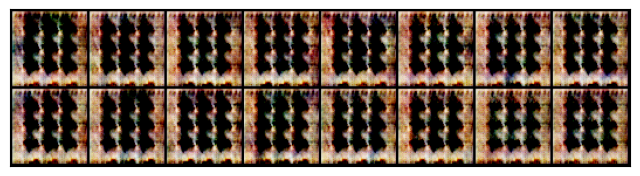

100%|██████████| 8/8 [00:02<00:00,  3.90it/s]


Epoch [32/100], loss_g: 0.0155, loss_d: 0.5900, real_score: 0.6747, fake_score: 0.8437


100%|██████████| 8/8 [00:02<00:00,  3.70it/s]


Epoch [33/100], loss_g: 0.0085, loss_d: 0.5664, real_score: 0.6706, fake_score: 0.8335


100%|██████████| 8/8 [00:02<00:00,  3.66it/s]


Epoch [34/100], loss_g: 0.0158, loss_d: 0.5664, real_score: 0.6702, fake_score: 0.8470


100%|██████████| 8/8 [00:02<00:00,  3.66it/s]


Epoch [35/100], loss_g: 0.0248, loss_d: 0.5323, real_score: 0.6648, fake_score: 0.8303


100%|██████████| 8/8 [00:02<00:00,  3.90it/s]


Epoch [36/100], loss_g: 0.0276, loss_d: 0.5680, real_score: 0.6735, fake_score: 0.8436


100%|██████████| 8/8 [00:02<00:00,  3.84it/s]


Epoch [37/100], loss_g: 0.0112, loss_d: 0.5699, real_score: 0.6648, fake_score: 0.8548


100%|██████████| 8/8 [00:02<00:00,  3.88it/s]


Epoch [38/100], loss_g: 0.0703, loss_d: 0.5529, real_score: 0.6650, fake_score: 0.8165


100%|██████████| 8/8 [00:02<00:00,  3.91it/s]


Epoch [39/100], loss_g: 0.0290, loss_d: 0.5444, real_score: 0.6764, fake_score: 0.8501


100%|██████████| 8/8 [00:02<00:00,  3.69it/s]


Epoch [40/100], loss_g: 0.0178, loss_d: 0.4831, real_score: 0.6681, fake_score: 0.8327


100%|██████████| 8/8 [00:02<00:00,  3.73it/s]


Epoch [41/100], loss_g: 0.0098, loss_d: 0.5788, real_score: 0.6675, fake_score: 0.8312
Saving generated-images-0041.png


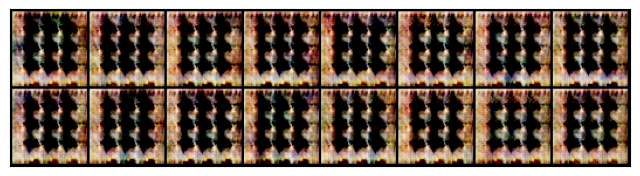

100%|██████████| 8/8 [00:02<00:00,  3.82it/s]


Epoch [42/100], loss_g: 0.0186, loss_d: 0.4220, real_score: 0.6686, fake_score: 0.8133


100%|██████████| 8/8 [00:02<00:00,  3.94it/s]


Epoch [43/100], loss_g: 0.0187, loss_d: 0.4899, real_score: 0.6733, fake_score: 0.8388


100%|██████████| 8/8 [00:02<00:00,  3.80it/s]


Epoch [44/100], loss_g: 0.0137, loss_d: 0.6116, real_score: 0.6723, fake_score: 0.8393


100%|██████████| 8/8 [00:02<00:00,  3.86it/s]


Epoch [45/100], loss_g: 0.0140, loss_d: 0.5409, real_score: 0.6676, fake_score: 0.8350


100%|██████████| 8/8 [00:02<00:00,  3.73it/s]


Epoch [46/100], loss_g: 0.0149, loss_d: 0.4453, real_score: 0.6635, fake_score: 0.8209


100%|██████████| 8/8 [00:02<00:00,  3.61it/s]


Epoch [47/100], loss_g: 0.0154, loss_d: 0.6042, real_score: 0.6643, fake_score: 0.8430


100%|██████████| 8/8 [00:02<00:00,  3.57it/s]


Epoch [48/100], loss_g: 0.0166, loss_d: 0.5176, real_score: 0.6768, fake_score: 0.8394


100%|██████████| 8/8 [00:02<00:00,  3.85it/s]


Epoch [49/100], loss_g: 0.0113, loss_d: 0.5608, real_score: 0.6656, fake_score: 0.8473


100%|██████████| 8/8 [00:02<00:00,  3.86it/s]


Epoch [50/100], loss_g: 0.0156, loss_d: 0.5748, real_score: 0.6671, fake_score: 0.8270


100%|██████████| 8/8 [00:02<00:00,  3.73it/s]


Epoch [51/100], loss_g: 0.0133, loss_d: 0.5598, real_score: 0.6731, fake_score: 0.8454
Saving generated-images-0051.png


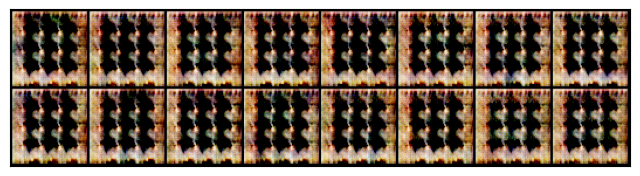

100%|██████████| 8/8 [00:02<00:00,  3.79it/s]


Epoch [52/100], loss_g: 0.0214, loss_d: 0.5058, real_score: 0.6726, fake_score: 0.8320


100%|██████████| 8/8 [00:02<00:00,  3.56it/s]


Epoch [53/100], loss_g: 0.0113, loss_d: 0.5283, real_score: 0.6681, fake_score: 0.8271


100%|██████████| 8/8 [00:02<00:00,  3.75it/s]


Epoch [54/100], loss_g: 0.0201, loss_d: 0.5476, real_score: 0.6708, fake_score: 0.8040


100%|██████████| 8/8 [00:02<00:00,  3.78it/s]


Epoch [55/100], loss_g: 0.0287, loss_d: 0.5337, real_score: 0.6733, fake_score: 0.8339


100%|██████████| 8/8 [00:02<00:00,  3.82it/s]


Epoch [56/100], loss_g: 0.0216, loss_d: 0.6349, real_score: 0.6765, fake_score: 0.8467


100%|██████████| 8/8 [00:02<00:00,  3.88it/s]


Epoch [57/100], loss_g: 0.0164, loss_d: 0.4966, real_score: 0.6698, fake_score: 0.8205


100%|██████████| 8/8 [00:02<00:00,  3.30it/s]


Epoch [58/100], loss_g: 0.0174, loss_d: 0.5851, real_score: 0.6608, fake_score: 0.8242


100%|██████████| 8/8 [00:02<00:00,  3.70it/s]


Epoch [59/100], loss_g: 0.0148, loss_d: 0.5301, real_score: 0.6674, fake_score: 0.8413


100%|██████████| 8/8 [00:02<00:00,  3.68it/s]


Epoch [60/100], loss_g: 0.0141, loss_d: 0.5362, real_score: 0.6631, fake_score: 0.8406


100%|██████████| 8/8 [00:02<00:00,  3.81it/s]


Epoch [61/100], loss_g: 0.0210, loss_d: 0.6094, real_score: 0.6669, fake_score: 0.8586
Saving generated-images-0061.png


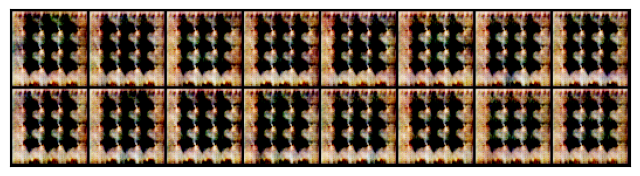

100%|██████████| 8/8 [00:02<00:00,  3.85it/s]


Epoch [62/100], loss_g: 0.0133, loss_d: 0.5210, real_score: 0.6709, fake_score: 0.8427


100%|██████████| 8/8 [00:02<00:00,  3.49it/s]


Epoch [63/100], loss_g: 0.0351, loss_d: 0.4806, real_score: 0.6676, fake_score: 0.8001


100%|██████████| 8/8 [00:02<00:00,  3.41it/s]


Epoch [64/100], loss_g: 0.0270, loss_d: 0.4750, real_score: 0.6647, fake_score: 0.8082


100%|██████████| 8/8 [00:02<00:00,  3.36it/s]


Epoch [65/100], loss_g: 0.0443, loss_d: 0.4701, real_score: 0.6651, fake_score: 0.8264


100%|██████████| 8/8 [00:02<00:00,  3.69it/s]


Epoch [66/100], loss_g: 0.0133, loss_d: 0.5536, real_score: 0.6659, fake_score: 0.8536


100%|██████████| 8/8 [00:02<00:00,  3.84it/s]


Epoch [67/100], loss_g: 0.0161, loss_d: 0.5706, real_score: 0.6653, fake_score: 0.8375


100%|██████████| 8/8 [00:02<00:00,  3.96it/s]


Epoch [68/100], loss_g: 0.0148, loss_d: 0.4999, real_score: 0.6629, fake_score: 0.8241


100%|██████████| 8/8 [00:02<00:00,  3.85it/s]


Epoch [69/100], loss_g: 0.0223, loss_d: 0.5025, real_score: 0.6745, fake_score: 0.8339


100%|██████████| 8/8 [00:02<00:00,  3.89it/s]


Epoch [70/100], loss_g: 0.0275, loss_d: 0.6035, real_score: 0.6641, fake_score: 0.8336


100%|██████████| 8/8 [00:02<00:00,  3.74it/s]


Epoch [71/100], loss_g: 0.0128, loss_d: 0.6531, real_score: 0.6622, fake_score: 0.8329
Saving generated-images-0071.png


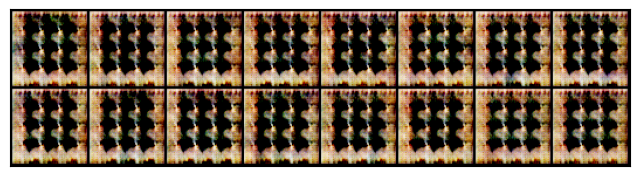

100%|██████████| 8/8 [00:02<00:00,  3.71it/s]


Epoch [72/100], loss_g: 0.0092, loss_d: 0.5297, real_score: 0.6727, fake_score: 0.8568


100%|██████████| 8/8 [00:02<00:00,  3.88it/s]


Epoch [73/100], loss_g: 0.0131, loss_d: 0.5729, real_score: 0.6679, fake_score: 0.8331


100%|██████████| 8/8 [00:02<00:00,  3.91it/s]


Epoch [74/100], loss_g: 0.0138, loss_d: 0.5579, real_score: 0.6616, fake_score: 0.8323


100%|██████████| 8/8 [00:02<00:00,  3.90it/s]


Epoch [75/100], loss_g: 0.0101, loss_d: 0.5944, real_score: 0.6677, fake_score: 0.8470


100%|██████████| 8/8 [00:02<00:00,  3.87it/s]


Epoch [76/100], loss_g: 0.0220, loss_d: 0.5830, real_score: 0.6705, fake_score: 0.8567


100%|██████████| 8/8 [00:02<00:00,  3.82it/s]


Epoch [77/100], loss_g: 0.0158, loss_d: 0.5864, real_score: 0.6671, fake_score: 0.8262


100%|██████████| 8/8 [00:02<00:00,  3.62it/s]


Epoch [78/100], loss_g: 0.0167, loss_d: 0.5826, real_score: 0.6749, fake_score: 0.8572


100%|██████████| 8/8 [00:02<00:00,  3.67it/s]


Epoch [79/100], loss_g: 0.0111, loss_d: 0.5871, real_score: 0.6741, fake_score: 0.8347


100%|██████████| 8/8 [00:02<00:00,  3.89it/s]


Epoch [80/100], loss_g: 0.0179, loss_d: 0.5448, real_score: 0.6689, fake_score: 0.8475


100%|██████████| 8/8 [00:02<00:00,  3.83it/s]


Epoch [81/100], loss_g: 0.0090, loss_d: 0.5444, real_score: 0.6763, fake_score: 0.8102
Saving generated-images-0081.png


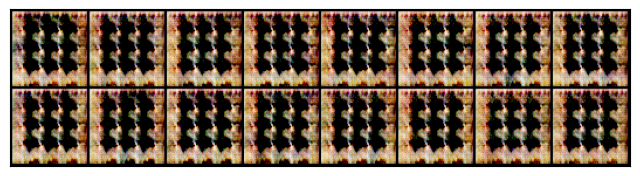

100%|██████████| 8/8 [00:02<00:00,  3.85it/s]


Epoch [82/100], loss_g: 0.0056, loss_d: 0.6031, real_score: 0.6692, fake_score: 0.8516


100%|██████████| 8/8 [00:02<00:00,  3.92it/s]


Epoch [83/100], loss_g: 0.0057, loss_d: 0.5865, real_score: 0.6692, fake_score: 0.8487


100%|██████████| 8/8 [00:02<00:00,  3.75it/s]


Epoch [84/100], loss_g: 0.0170, loss_d: 0.5548, real_score: 0.6705, fake_score: 0.8398


100%|██████████| 8/8 [00:02<00:00,  3.72it/s]


Epoch [85/100], loss_g: 0.0208, loss_d: 0.5512, real_score: 0.6728, fake_score: 0.8526


100%|██████████| 8/8 [00:02<00:00,  3.86it/s]


Epoch [86/100], loss_g: 0.0286, loss_d: 0.5853, real_score: 0.6704, fake_score: 0.8439


100%|██████████| 8/8 [00:02<00:00,  3.92it/s]


Epoch [87/100], loss_g: 0.0233, loss_d: 0.4992, real_score: 0.6725, fake_score: 0.8248


100%|██████████| 8/8 [00:02<00:00,  3.84it/s]


Epoch [88/100], loss_g: 0.0261, loss_d: 0.5153, real_score: 0.6723, fake_score: 0.8195


100%|██████████| 8/8 [00:02<00:00,  3.80it/s]


Epoch [89/100], loss_g: 0.0245, loss_d: 0.5282, real_score: 0.6692, fake_score: 0.8199


100%|██████████| 8/8 [00:02<00:00,  3.74it/s]


Epoch [90/100], loss_g: 0.0176, loss_d: 0.4684, real_score: 0.6675, fake_score: 0.8435


100%|██████████| 8/8 [00:02<00:00,  3.67it/s]


Epoch [91/100], loss_g: 0.0209, loss_d: 0.5861, real_score: 0.6697, fake_score: 0.8359
Saving generated-images-0091.png


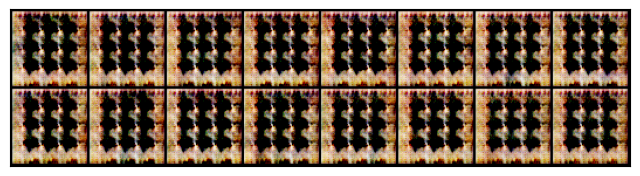

100%|██████████| 8/8 [00:02<00:00,  3.74it/s]


Epoch [92/100], loss_g: 0.0244, loss_d: 0.5223, real_score: 0.6651, fake_score: 0.8551


100%|██████████| 8/8 [00:02<00:00,  3.79it/s]


Epoch [93/100], loss_g: 0.0170, loss_d: 0.5086, real_score: 0.6728, fake_score: 0.8165


100%|██████████| 8/8 [00:02<00:00,  3.68it/s]


Epoch [94/100], loss_g: 0.0168, loss_d: 0.5691, real_score: 0.6739, fake_score: 0.8306


100%|██████████| 8/8 [00:02<00:00,  3.55it/s]


Epoch [95/100], loss_g: 0.0148, loss_d: 0.4782, real_score: 0.6743, fake_score: 0.8296


100%|██████████| 8/8 [00:02<00:00,  3.12it/s]


Epoch [96/100], loss_g: 0.0208, loss_d: 0.6265, real_score: 0.6768, fake_score: 0.8332


100%|██████████| 8/8 [00:02<00:00,  3.10it/s]


Epoch [97/100], loss_g: 0.0454, loss_d: 0.5637, real_score: 0.6761, fake_score: 0.8404


100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


Epoch [98/100], loss_g: 0.0107, loss_d: 0.5790, real_score: 0.6720, fake_score: 0.8450


100%|██████████| 8/8 [00:02<00:00,  3.67it/s]


Epoch [99/100], loss_g: 0.0168, loss_d: 0.5214, real_score: 0.6710, fake_score: 0.8239


100%|██████████| 8/8 [00:02<00:00,  3.81it/s]

Epoch [100/100], loss_g: 0.0179, loss_d: 0.5285, real_score: 0.6708, fake_score: 0.8044


In [ ]:
# Complete the training function

losses_g = []
losses_d = []
real_scores = []
fake_scores = []
# Freeze all parameters in the models
for param in generator.parameters():
    param.requires_grad = True
for param in discriminator.parameters():
    param.requires_grad = False


# Unfreeze LoRA parameters in the generator
generator.A_matrix.requires_grad = True
generator.B_matrix.requires_grad = True
fixed_latent = torch.randn(16, 128, 1, 1, device=device)
# Move models to the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)

optimizer_g = torch.optim.Adam(filter(lambda p: p.requires_grad, generator.parameters()), lr=0.0002, betas=(0.5, 0.999))
# optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
def train(D, G, d_optimizer, g_optimizer, epochs=1):
    iter_count = 0
    start_idx=1
    for epoch in range(epochs):
        for real_images in tqdm(dataloader):
            real_images=real_images.to(device)
            # Pass real images through discriminator
            D_out_real = D(real_images)
            label_real = torch.full(D_out_real.shape, 1.0).to(torch.device(device))
            real_loss = Real_loss(label_real,D_out_real)
            real_score = torch.mean(D_out_real).item()

            # Generate fake images
            noise = torch.randn(16, latent_size, 1, 1).to(torch.device(device))
            fake_images =  G(noise)

            # Pass fake images through discriminator
            D_out_fake = D(fake_images)
            label_fake =  torch.full(D_out_fake.shape, 0).to(torch.device(device))
            fake_loss = Fake_loss(label_fake, D_out_fake)
            fake_score = torch.mean(D_out_fake).item()

            # Update discriminator weights
            loss_d = real_loss + fake_loss

            d_optimizer.zero_grad()
            # loss_d.backward(retain_graph = True)
            d_optimizer.step()

            # Generate fake images
            noise2 = torch.randn(16, latent_size, 1, 1).to(torch.device(device))
            fake_images2 =  G(noise2)

            gen_steps = 1
            for i in range(0, gen_steps ):
            # Try to fool the discriminator
                D_out_fake2 = D(fake_images2)

                # The label is set to 1(real-like) to fool the discriminator
                label_real1 = torch.full(D_out_fake2.shape, 1.0).to(torch.device(device))
                loss_g = Real_loss(label_real1, D_out_fake2)

                # Update generator weights
                g_optimizer.zero_grad()
                loss_g.backward(retain_graph = (i<gen_steps -1 ))
                g_optimizer.step()


        losses_g.append(loss_g.item())
        losses_d.append(loss_d.item())
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
        epoch+1, epochs, loss_g, loss_d, real_score, fake_score))

        # Save generated images
        if epoch % 10 == 0:
          save_samples(epoch+start_idx, fixed_latent,G, show=True)

          state_dis = {'dis_model': D.state_dict(), 'epoch': epoch}
          state_gen = {'gen_model': G.state_dict(), 'epoch': epoch}
          if not os.path.isdir('checkpoint'):
              os.mkdir('checkpoint')
          torch.save(state_dis, 'checkpoint/'+'D__'+str(epoch+1)) #each epoch
        torch.save(state_gen, 'checkpoint/'+'G__'+str(epoch+1)) #each epoch
#Train the GAN
train(discriminator,generator,optimizer_d ,optimizer_g,epochs=100)

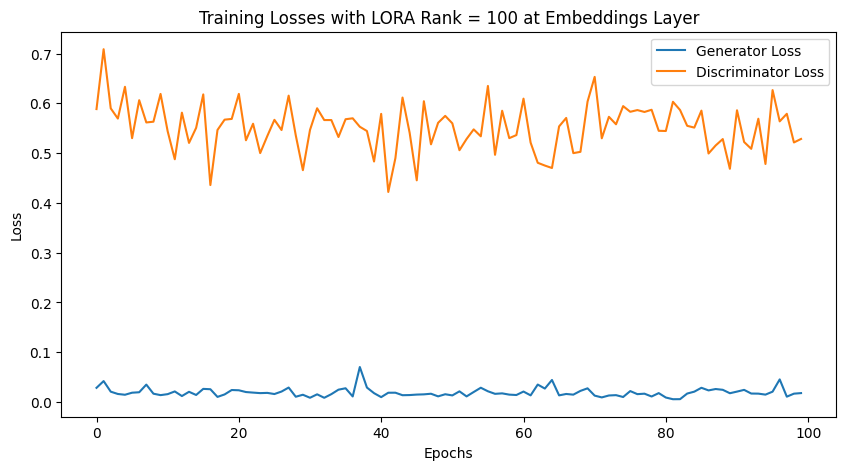

In [ ]:
import matplotlib.pyplot as plt

# Assuming losses_g and losses_d are populated with loss values from each epoch
plt.figure(figsize=(10, 5))

# Plotting Generator loss
plt.plot(losses_g, label='Generator Loss')

# Plotting Discriminator loss
plt.plot(losses_d, label='Discriminator Loss')

# Adding titles and labels
plt.title('Training Losses with LORA Rank = 100 at Embeddings Layer')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Displaying the plot
plt.show()


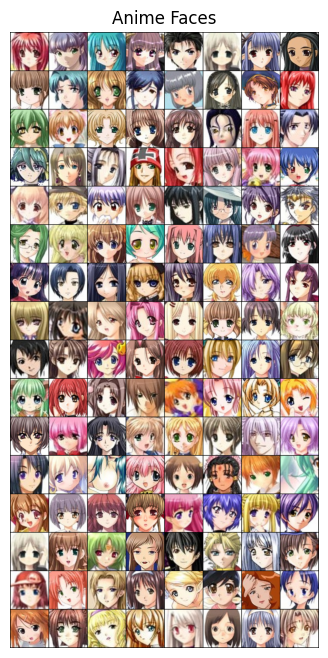

In [ ]:
# Function to show a batch of images
def show_images(dataloader):
    # Get a batch of images
    images = next(iter(dataloader))

    # Make a grid from batch
    plt.figure(figsize=(8,8))
    plt.axis("off")
    plt.title("Anime Faces")
    grid = vutils.make_grid(images, padding=2, normalize=True)
    plt.imshow(grid.permute(1, 2, 0).numpy())

# Show images
show_images(dataloader)

In [ ]:
generator_with_lora = GeneratorWithLoRA(latent_size=128, lora_rank=100)

current_state_dict = generator_with_lora.state_dict()
for name, param in checkpoint.items():
    if name in current_state_dict:
        current_state_dict[name].copy_(param)
generator_with_lora.load_state_dict(current_state_dict)
generator = generator_with_lora

In [ ]:
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import os
batch_size = 128
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)
transform = transforms.Compose([
                                transforms.CenterCrop(64),
                                transforms.Resize(64, interpolation=2),
                                transforms.ToTensor(),
                                transforms.Normalize(*stats)])
class AnimeFaceDataset(Dataset):
    def __init__(self, directory, num_images=None, transform=None):
        self.directory = directory
        self.transform = transform
        self.images = os.listdir(directory)
        if num_images is not None:
            self.images = self.images[:num_images]

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_name = os.path.join(self.directory, self.images[idx])
        image = Image.open(img_name)
        if self.transform:
            image = self.transform(image)
        return image


# Load only 10000 images
num_images_to_load = 100
dataset = AnimeFaceDataset(directory='/content/drive/MyDrive/CS182-Research/images', num_images=num_images_to_load, transform=transform)
dataloader = DataLoader(dataset, batch_size=128, shuffle=True)


OSError: ignored

100%|██████████| 1/1 [00:00<00:00,  3.68it/s]


Epoch [1/15], loss_g: 0.2481, loss_d: 0.1339, real_score: 0.7256, fake_score: 0.4303
Saving generated-images-0001.png


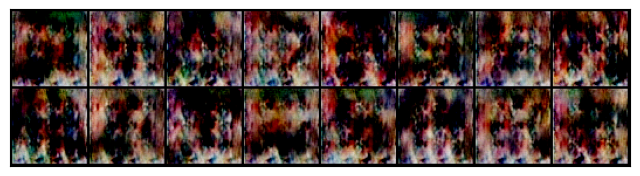

100%|██████████| 1/1 [00:00<00:00,  4.44it/s]


Epoch [2/15], loss_g: 0.1149, loss_d: 0.2786, real_score: 0.7256, fake_score: 0.5615


100%|██████████| 1/1 [00:00<00:00,  4.45it/s]


Epoch [3/15], loss_g: 0.0325, loss_d: 0.3655, real_score: 0.7256, fake_score: 0.7316


100%|██████████| 1/1 [00:00<00:00,  4.74it/s]


Epoch [4/15], loss_g: 0.0466, loss_d: 0.4668, real_score: 0.7256, fake_score: 0.7911


100%|██████████| 1/1 [00:00<00:00,  4.69it/s]


Epoch [5/15], loss_g: 0.0619, loss_d: 0.5054, real_score: 0.7256, fake_score: 0.8487


100%|██████████| 1/1 [00:00<00:00,  4.89it/s]


Epoch [6/15], loss_g: 0.0458, loss_d: 0.5774, real_score: 0.7256, fake_score: 0.8927


100%|██████████| 1/1 [00:00<00:00,  4.59it/s]


Epoch [7/15], loss_g: 0.0226, loss_d: 0.5501, real_score: 0.7256, fake_score: 0.8815


100%|██████████| 1/1 [00:00<00:00,  5.23it/s]


Epoch [8/15], loss_g: 0.0210, loss_d: 0.6050, real_score: 0.7256, fake_score: 0.8694


100%|██████████| 1/1 [00:00<00:00,  5.50it/s]


Epoch [9/15], loss_g: 0.0284, loss_d: 0.5480, real_score: 0.7256, fake_score: 0.9109


100%|██████████| 1/1 [00:00<00:00,  5.46it/s]


Epoch [10/15], loss_g: 0.0235, loss_d: 0.5515, real_score: 0.7256, fake_score: 0.8846


100%|██████████| 1/1 [00:00<00:00,  5.40it/s]


Epoch [11/15], loss_g: 0.0103, loss_d: 0.6006, real_score: 0.7256, fake_score: 0.8944
Saving generated-images-0011.png


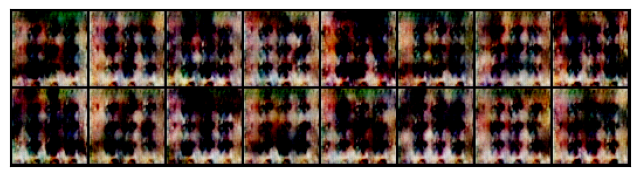

100%|██████████| 1/1 [00:00<00:00,  5.34it/s]


Epoch [12/15], loss_g: 0.0151, loss_d: 0.5363, real_score: 0.7256, fake_score: 0.8691


100%|██████████| 1/1 [00:00<00:00,  5.50it/s]


Epoch [13/15], loss_g: 0.0217, loss_d: 0.6699, real_score: 0.7256, fake_score: 0.8853


100%|██████████| 1/1 [00:00<00:00,  5.11it/s]


Epoch [14/15], loss_g: 0.0343, loss_d: 0.5749, real_score: 0.7256, fake_score: 0.8897


100%|██████████| 1/1 [00:00<00:00,  5.19it/s]


Epoch [15/15], loss_g: 0.0248, loss_d: 0.5618, real_score: 0.7256, fake_score: 0.8693


In [ ]:
# Complete the training function

losses_g = []
losses_d = []
real_scores = []
fake_scores = []
# Freeze all parameters in the models
for param in generator.parameters():
    param.requires_grad = True
for param in discriminator.parameters():
    param.requires_grad = False
#Define your learning rate
lr=0.0002
opt_g = optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))

# Unfreeze LoRA parameters in the generator
generator.A_matrix.requires_grad = True
generator.B_matrix.requires_grad = True
fixed_latent = torch.randn(16, 128, 1, 1, device=device)
# Move models to the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)

optimizer_g = torch.optim.Adam(filter(lambda p: p.requires_grad, generator.parameters()), lr=0.0002, betas=(0.5, 0.999))
# optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
def train(D, G, d_optimizer, g_optimizer, epochs=1):
    iter_count = 0
    start_idx=1
    for epoch in range(epochs):
        for real_images in tqdm(dataloader):
            real_images=real_images.to(device)
            # Pass real images through discriminator
            D_out_real = D(real_images)
            label_real = torch.full(D_out_real.shape, 1.0).to(torch.device(device))
            real_loss = Real_loss(label_real,D_out_real)
            real_score = torch.mean(D_out_real).item()

            # Generate fake images
            noise = torch.randn(16, latent_size, 1, 1).to(torch.device(device))
            fake_images =  G(noise)

            # Pass fake images through discriminator
            D_out_fake = D(fake_images)
            label_fake =  torch.full(D_out_fake.shape, 0).to(torch.device(device))
            fake_loss = Fake_loss(label_fake, D_out_fake)
            fake_score = torch.mean(D_out_fake).item()

            # Update discriminator weights
            loss_d = real_loss + fake_loss

            d_optimizer.zero_grad()
            # loss_d.backward(retain_graph = True)
            d_optimizer.step()

            # Generate fake images
            noise2 = torch.randn(16, latent_size, 1, 1).to(torch.device(device))
            fake_images2 =  G(noise2)

            gen_steps = 1
            for i in range(0, gen_steps ):
            # Try to fool the discriminator
                D_out_fake2 = D(fake_images2)

                # The label is set to 1(real-like) to fool the discriminator
                label_real1 = torch.full(D_out_fake2.shape, 1.0).to(torch.device(device))
                loss_g = Real_loss(label_real1, D_out_fake2)

                # Update generator weights
                g_optimizer.zero_grad()
                loss_g.backward(retain_graph = (i<gen_steps -1 ))
                g_optimizer.step()


        losses_g.append(loss_g.item())
        losses_d.append(loss_d.item())
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
        epoch+1, epochs, loss_g, loss_d, real_score, fake_score))

        # Save generated images
        if epoch % 10 == 0:
          save_samples(epoch+start_idx, fixed_latent,G, show=True)

          state_dis = {'dis_model': D.state_dict(), 'epoch': epoch}
          state_gen = {'gen_model': G.state_dict(), 'epoch': epoch}
          if not os.path.isdir('checkpoint'):
              os.mkdir('checkpoint')
          torch.save(state_dis, 'checkpoint/'+'D__'+str(epoch+1)) #each epoch
        torch.save(state_gen, 'checkpoint/'+'G__'+str(epoch+1)) #each epoch
#Train the GAN
train(discriminator,generator,optimizer_d ,opt_g,epochs=15)

In [ ]:
generator = Generator(latent_size).to(device)
current_state_dict = generator.state_dict()
for name, param in checkpoint.items():
    if name in current_state_dict:
        current_state_dict[name].copy_(param)
generator.load_state_dict(current_state_dict)


<All keys matched successfully>

100%|██████████| 1/1 [00:00<00:00,  4.71it/s]


Epoch [1/15], loss_g: 0.4816, loss_d: 0.0445, real_score: 0.8172, fake_score: 0.1478
Saving generated-images-0001.png


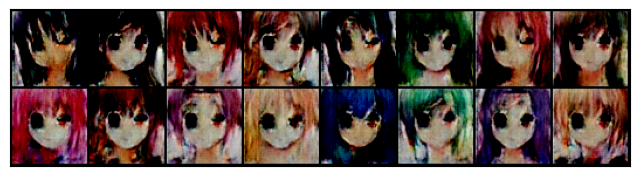

100%|██████████| 1/1 [00:00<00:00,  4.92it/s]


Epoch [2/15], loss_g: 0.3941, loss_d: 0.0390, real_score: 0.8172, fake_score: 0.1971


100%|██████████| 1/1 [00:00<00:00,  5.35it/s]


Epoch [3/15], loss_g: 0.2176, loss_d: 0.0589, real_score: 0.8172, fake_score: 0.3121


100%|██████████| 1/1 [00:00<00:00,  5.55it/s]


Epoch [4/15], loss_g: 0.1856, loss_d: 0.0993, real_score: 0.8172, fake_score: 0.4200


100%|██████████| 1/1 [00:00<00:00,  5.25it/s]


Epoch [5/15], loss_g: 0.1468, loss_d: 0.1746, real_score: 0.8172, fake_score: 0.5381


100%|██████████| 1/1 [00:00<00:00,  5.39it/s]


Epoch [6/15], loss_g: 0.0554, loss_d: 0.3044, real_score: 0.8172, fake_score: 0.6368


100%|██████████| 1/1 [00:00<00:00,  5.65it/s]


Epoch [7/15], loss_g: 0.0397, loss_d: 0.3674, real_score: 0.8172, fake_score: 0.7215


100%|██████████| 1/1 [00:00<00:00,  5.43it/s]


Epoch [8/15], loss_g: 0.0352, loss_d: 0.3784, real_score: 0.8172, fake_score: 0.7570


100%|██████████| 1/1 [00:00<00:00,  5.45it/s]


Epoch [9/15], loss_g: 0.0161, loss_d: 0.3939, real_score: 0.8172, fake_score: 0.7735


100%|██████████| 1/1 [00:00<00:00,  5.65it/s]


Epoch [10/15], loss_g: 0.0376, loss_d: 0.4158, real_score: 0.8172, fake_score: 0.8035


100%|██████████| 1/1 [00:00<00:00,  5.38it/s]


Epoch [11/15], loss_g: 0.0200, loss_d: 0.4688, real_score: 0.8172, fake_score: 0.8054
Saving generated-images-0011.png


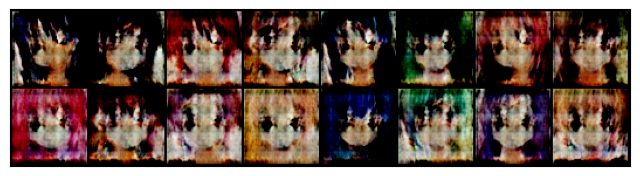

100%|██████████| 1/1 [00:00<00:00,  5.82it/s]


Epoch [12/15], loss_g: 0.0322, loss_d: 0.5401, real_score: 0.8172, fake_score: 0.8329


100%|██████████| 1/1 [00:00<00:00,  5.28it/s]


Epoch [13/15], loss_g: 0.0150, loss_d: 0.4623, real_score: 0.8172, fake_score: 0.8251


100%|██████████| 1/1 [00:00<00:00,  5.49it/s]


Epoch [14/15], loss_g: 0.0099, loss_d: 0.4908, real_score: 0.8172, fake_score: 0.8362


100%|██████████| 1/1 [00:00<00:00,  5.00it/s]

Epoch [15/15], loss_g: 0.0222, loss_d: 0.4891, real_score: 0.8172, fake_score: 0.8269


In [ ]:
# Complete the training function

losses_g = []
losses_d = []
real_scores = []
fake_scores = []
# Freeze all parameters in the models
for param in generator.parameters():
    param.requires_grad = True
for param in discriminator.parameters():
    param.requires_grad = False
#Define your learning rate
lr=0.0002
opt_g = optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))

fixed_latent = torch.randn(16, 128, 1, 1, device=device)
# Move models to the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)

optimizer_g = torch.optim.Adam(filter(lambda p: p.requires_grad, generator.parameters()), lr=0.0002, betas=(0.5, 0.999))
# optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
def train(D, G, d_optimizer, g_optimizer, epochs=1):
    iter_count = 0
    start_idx=1
    for epoch in range(epochs):
        for real_images in tqdm(dataloader):
            real_images=real_images.to(device)
            # Pass real images through discriminator
            D_out_real = D(real_images)
            label_real = torch.full(D_out_real.shape, 1.0).to(torch.device(device))
            real_loss = Real_loss(label_real,D_out_real)
            real_score = torch.mean(D_out_real).item()

            # Generate fake images
            noise = torch.randn(16, latent_size, 1, 1).to(torch.device(device))
            fake_images =  G(noise)

            # Pass fake images through discriminator
            D_out_fake = D(fake_images)
            label_fake =  torch.full(D_out_fake.shape, 0).to(torch.device(device))
            fake_loss = Fake_loss(label_fake, D_out_fake)
            fake_score = torch.mean(D_out_fake).item()

            # Update discriminator weights
            loss_d = real_loss + fake_loss

            d_optimizer.zero_grad()
            # loss_d.backward(retain_graph = True)
            d_optimizer.step()

            # Generate fake images
            noise2 = torch.randn(16, latent_size, 1, 1).to(torch.device(device))
            fake_images2 =  G(noise2)

            gen_steps = 1
            for i in range(0, gen_steps ):
                D_out_fake2 = D(fake_images2)

                label_real1 = torch.full(D_out_fake2.shape, 1.0).to(torch.device(device))
                loss_g = Real_loss(label_real1, D_out_fake2)

                g_optimizer.zero_grad()
                loss_g.backward(retain_graph = (i<gen_steps -1 ))
                g_optimizer.step()


        losses_g.append(loss_g.item())
        losses_d.append(loss_d.item())
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
        epoch+1, epochs, loss_g, loss_d, real_score, fake_score))

        # Save generated images
        if epoch % 10 == 0:
          save_samples(epoch+start_idx, fixed_latent,G, show=True)

          state_dis = {'dis_model': D.state_dict(), 'epoch': epoch}
          state_gen = {'gen_model': G.state_dict(), 'epoch': epoch}
          if not os.path.isdir('checkpoint'):
              os.mkdir('checkpoint')
          torch.save(state_dis, 'checkpoint/'+'D__'+str(epoch+1)) #each epoch
        torch.save(state_gen, 'checkpoint/'+'G__'+str(epoch+1)) #each epoch
#Train the GAN
train(discriminator,generator,optimizer_d ,opt_g,epochs=15)

100%|██████████| 1/1 [00:00<00:00,  2.39it/s]


Epoch [1/15], loss_g: 0.3546, loss_d: 0.0645, real_score: 0.7256, fake_score: 0.1286
Saving generated-images-0001.png


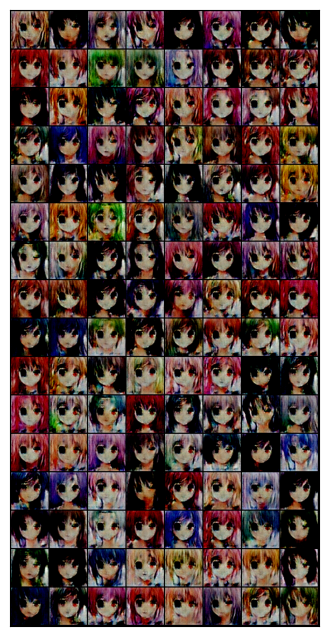

100%|██████████| 1/1 [00:00<00:00,  3.13it/s]


Epoch [2/15], loss_g: 0.4730, loss_d: 0.0603, real_score: 0.8838, fake_score: 0.2407
Saving generated-images-0002.png


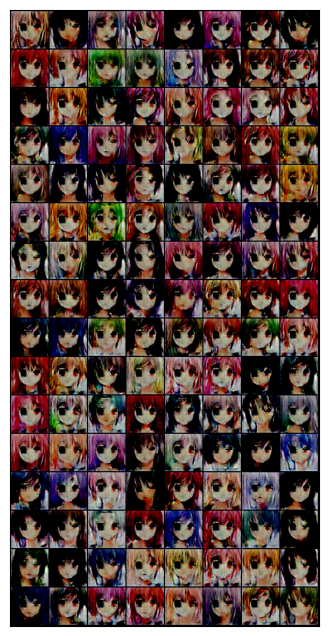

100%|██████████| 1/1 [00:00<00:00,  2.99it/s]


Epoch [3/15], loss_g: 0.5411, loss_d: 0.0482, real_score: 0.8789, fake_score: 0.1471
Saving generated-images-0003.png


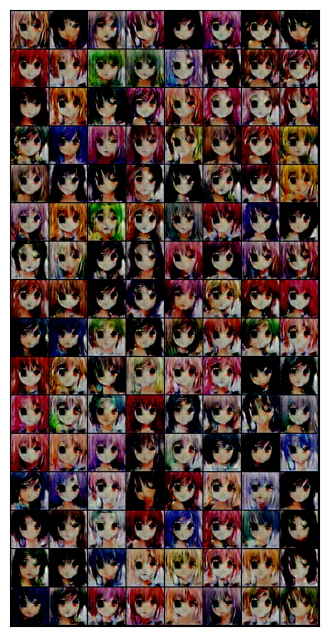

100%|██████████| 1/1 [00:00<00:00,  3.19it/s]


Epoch [4/15], loss_g: 0.5390, loss_d: 0.0446, real_score: 0.8592, fake_score: 0.1070
Saving generated-images-0004.png


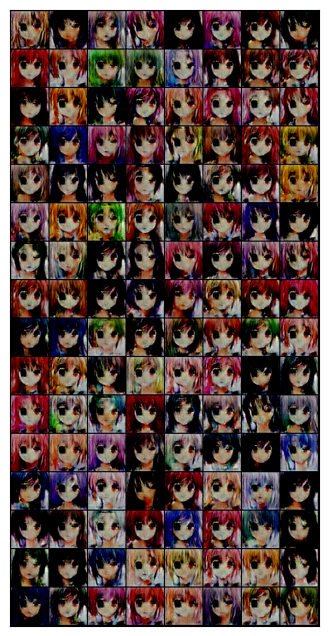

100%|██████████| 1/1 [00:00<00:00,  2.91it/s]


Epoch [5/15], loss_g: 0.5144, loss_d: 0.0510, real_score: 0.8407, fake_score: 0.1106


Saving generated-images-0005.png


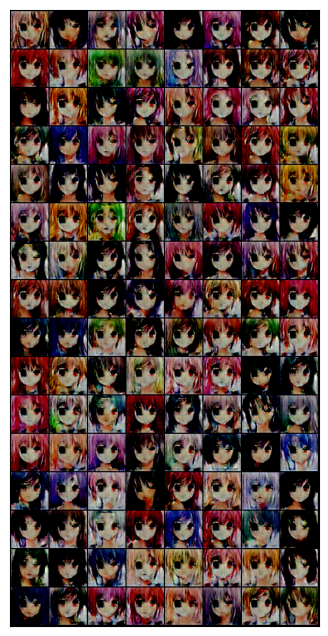

100%|██████████| 1/1 [00:00<00:00,  2.94it/s]


Epoch [6/15], loss_g: 0.4598, loss_d: 0.0426, real_score: 0.8276, fake_score: 0.1367


Saving generated-images-0006.png


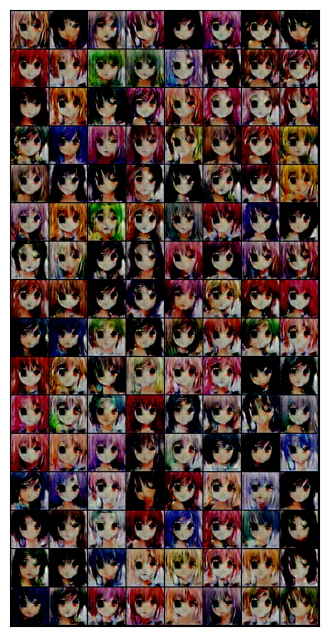

100%|██████████| 1/1 [00:00<00:00,  3.20it/s]


Epoch [7/15], loss_g: 0.4526, loss_d: 0.0409, real_score: 0.8286, fake_score: 0.1561
Saving generated-images-0007.png


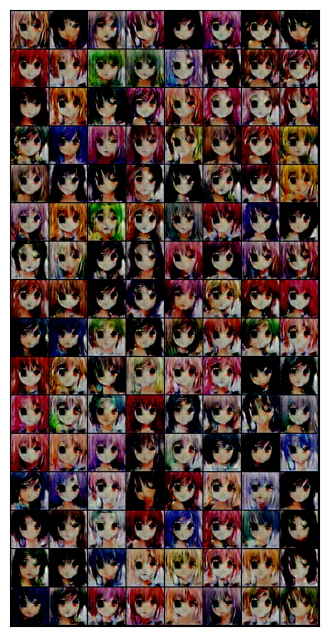

100%|██████████| 1/1 [00:00<00:00,  3.23it/s]


Epoch [8/15], loss_g: 0.4689, loss_d: 0.0432, real_score: 0.8352, fake_score: 0.1822
Saving generated-images-0008.png


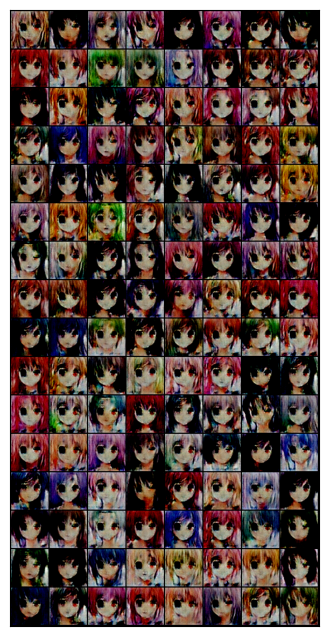

100%|██████████| 1/1 [00:00<00:00,  3.22it/s]


Epoch [9/15], loss_g: 0.4581, loss_d: 0.0517, real_score: 0.8233, fake_score: 0.1719
Saving generated-images-0009.png


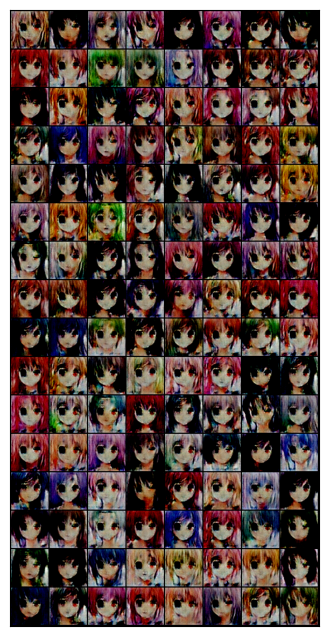

100%|██████████| 1/1 [00:00<00:00,  3.21it/s]


Epoch [10/15], loss_g: 0.4607, loss_d: 0.0414, real_score: 0.7927, fake_score: 0.1500
Saving generated-images-0010.png


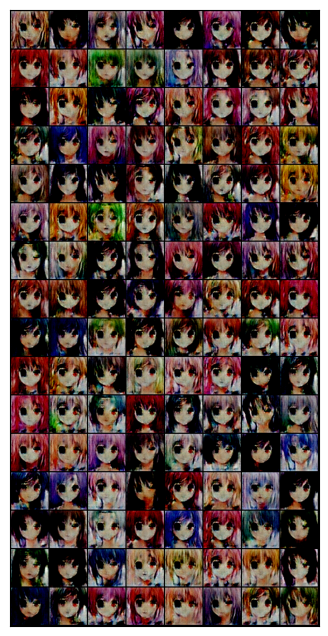

100%|██████████| 1/1 [00:00<00:00,  3.17it/s]


Epoch [11/15], loss_g: 0.4538, loss_d: 0.0380, real_score: 0.8416, fake_score: 0.1695
Saving generated-images-0011.png


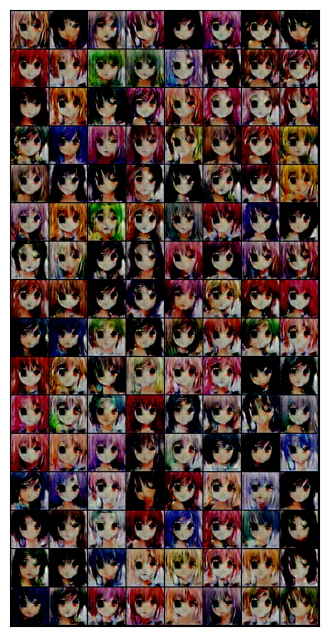

100%|██████████| 1/1 [00:00<00:00,  3.17it/s]


Epoch [12/15], loss_g: 0.4855, loss_d: 0.0353, real_score: 0.8647, fake_score: 0.1866


Saving generated-images-0012.png


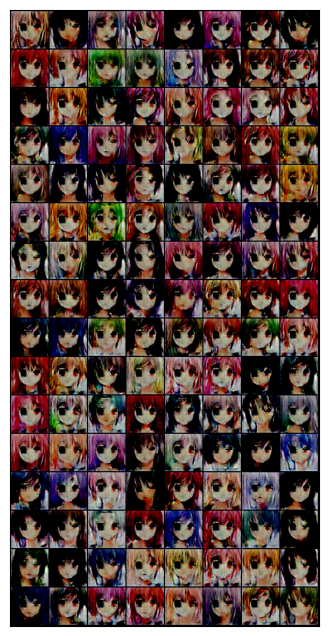

100%|██████████| 1/1 [00:00<00:00,  3.18it/s]


Epoch [13/15], loss_g: 0.4831, loss_d: 0.0372, real_score: 0.8562, fake_score: 0.1523
Saving generated-images-0013.png


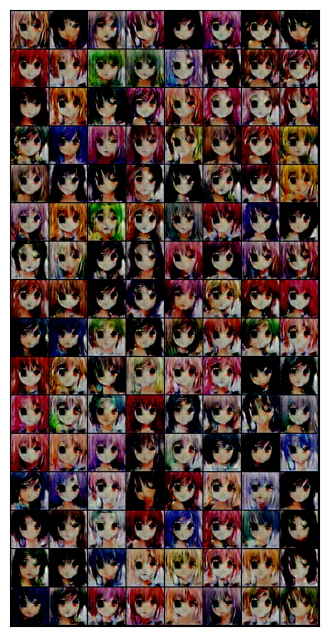

100%|██████████| 1/1 [00:00<00:00,  3.27it/s]


Epoch [14/15], loss_g: 0.4458, loss_d: 0.0449, real_score: 0.8356, fake_score: 0.1362
Saving generated-images-0014.png


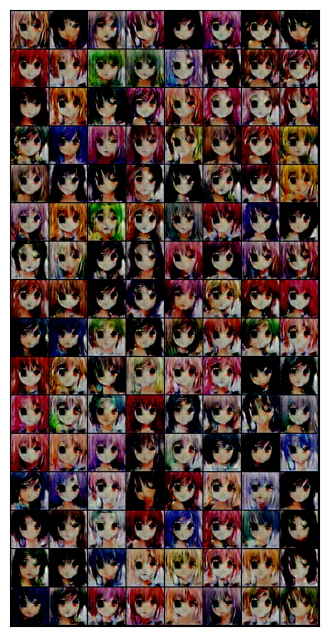

100%|██████████| 1/1 [00:00<00:00,  3.14it/s]


Epoch [15/15], loss_g: 0.4911, loss_d: 0.0435, real_score: 0.8350, fake_score: 0.1950
Saving generated-images-0015.png


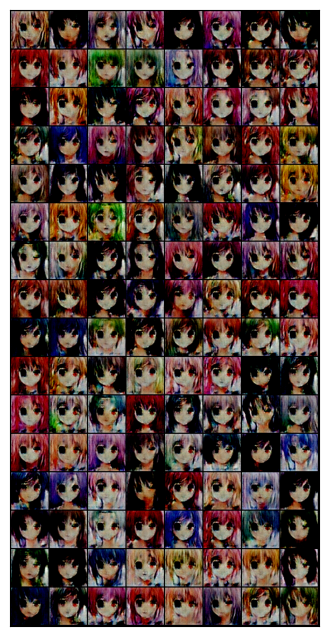

In [ ]:
# Complete the training function
losses_g = []
losses_d = []
real_scores = []
fake_scores = []
fixed_latent = torch.randn(batch_size, latent_size, 1, 1).to(device)
opt_d = optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))
# Freeze all parameters in the models
for param in generator.parameters():
    param.requires_grad = True
for param in discriminator.parameters():
    param.requires_grad = True

def train(D, G, d_optimizer, g_optimizer, epochs=1):
    iter_count = 0
    start_idx=1
    for epoch in range(epochs):
        for real_images in tqdm(dataloader):
            real_images=real_images.to(device)
            # Pass real images through discriminator
            D_out_real = D(real_images)
            label_real = torch.full(D_out_real.shape, 1.0).to(torch.device(device))
            real_loss = Real_loss(label_real,D_out_real)
            real_score = torch.mean(D_out_real).item()

            # Generate fake images
            noise = torch.randn(batch_size, latent_size, 1, 1).to(torch.device(device))
            fake_images =  G(noise)

            # Pass fake images through discriminator
            D_out_fake = D(fake_images)
            label_fake =  torch.full(D_out_fake.shape, 0).to(torch.device(device))
            fake_loss = Fake_loss(label_fake, D_out_fake)
            fake_score = torch.mean(D_out_fake).item()

            # Update discriminator weights
            loss_d = real_loss + fake_loss

            d_optimizer.zero_grad()
            loss_d.backward(retain_graph = True)
            d_optimizer.step()

            # Generate fake images
            noise2 = torch.randn(batch_size, latent_size, 1, 1).to(torch.device(device))
            fake_images2 =  G(noise2)

            gen_steps = 1
            for i in range(0, gen_steps ):
            # Try to fool the discriminator
                D_out_fake2 = D(fake_images2)

                # The label is set to 1(real-like) to fool the discriminator
                label_real1 = torch.full(D_out_fake2.shape, 1.0).to(torch.device(device))
                loss_g = Real_loss(label_real1, D_out_fake2)

                # Update generator weights
                g_optimizer.zero_grad()
                loss_g.backward(retain_graph = (i<gen_steps -1 ))
                g_optimizer.step()


        losses_g.append(loss_g.item())
        losses_d.append(loss_d.item())
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
        epoch+1, epochs, loss_g, loss_d, real_score, fake_score))

        # Save generated images
        save_samples(epoch + start_idx, fixed_latent, G, show=True)

torch.save(generator.state_dict(), '/content/drive/MyDrive/CS182-Research/generator-toy-naive.pth')
torch.save(discriminator.state_dict(), '/content/drive/MyDrive/CS182-Research/discriminator-toy-naive.pth')
#Train the GAN
train(discriminator,generator,opt_d,opt_g,epochs=15)

In [ ]:
generator_with_lora = GeneratorWithLoRA(latent_size=128, lora_rank=256)

current_state_dict = generator_with_lora.state_dict()
for name, param in checkpoint.items():
    if name in current_state_dict:
        current_state_dict[name].copy_(param)
generator_with_lora.load_state_dict(current_state_dict)
generator = generator_with_lora

100%|██████████| 1/1 [00:00<00:00,  5.98it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [1/100], loss_g: 0.2399, loss_d: 0.0839, real_score: 0.8172, fake_score: 0.3533
torch.Size([16, 64, 32, 32])
Saving generated-images-0001.png


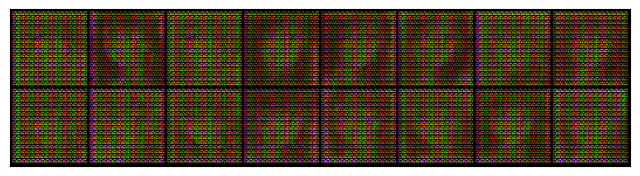

100%|██████████| 1/1 [00:00<00:00,  5.54it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [2/100], loss_g: 0.2389, loss_d: 0.0978, real_score: 0.8172, fake_score: 0.3620


100%|██████████| 1/1 [00:00<00:00,  5.67it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [3/100], loss_g: 0.1833, loss_d: 0.0931, real_score: 0.8172, fake_score: 0.3534


100%|██████████| 1/1 [00:00<00:00,  6.07it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [4/100], loss_g: 0.2460, loss_d: 0.0939, real_score: 0.8172, fake_score: 0.3788


100%|██████████| 1/1 [00:00<00:00,  5.81it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [5/100], loss_g: 0.2389, loss_d: 0.0694, real_score: 0.8172, fake_score: 0.3682


100%|██████████| 1/1 [00:00<00:00,  5.78it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [6/100], loss_g: 0.2784, loss_d: 0.0956, real_score: 0.8172, fake_score: 0.3509


100%|██████████| 1/1 [00:00<00:00,  6.05it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [7/100], loss_g: 0.2742, loss_d: 0.0815, real_score: 0.8172, fake_score: 0.3431


100%|██████████| 1/1 [00:00<00:00,  5.33it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [8/100], loss_g: 0.2745, loss_d: 0.0732, real_score: 0.8172, fake_score: 0.3596


100%|██████████| 1/1 [00:00<00:00,  5.45it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [9/100], loss_g: 0.2604, loss_d: 0.0986, real_score: 0.8172, fake_score: 0.3740


100%|██████████| 1/1 [00:00<00:00,  5.48it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [10/100], loss_g: 0.2359, loss_d: 0.1033, real_score: 0.8172, fake_score: 0.3606


100%|██████████| 1/1 [00:00<00:00,  5.75it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [11/100], loss_g: 0.2597, loss_d: 0.0920, real_score: 0.8172, fake_score: 0.3489
torch.Size([16, 64, 32, 32])
Saving generated-images-0011.png


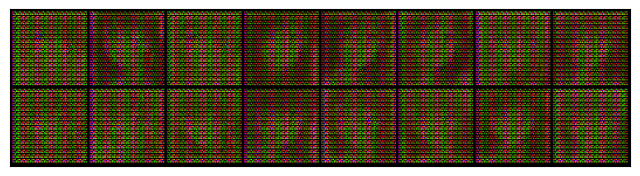

100%|██████████| 1/1 [00:00<00:00,  5.15it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [12/100], loss_g: 0.2431, loss_d: 0.0823, real_score: 0.8172, fake_score: 0.3437


100%|██████████| 1/1 [00:00<00:00,  2.23it/s]

torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [13/100], loss_g: 0.2773, loss_d: 0.1061, real_score: 0.8172, fake_score: 0.3541



100%|██████████| 1/1 [00:00<00:00,  5.40it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [14/100], loss_g: 0.2556, loss_d: 0.0987, real_score: 0.8172, fake_score: 0.3620


100%|██████████| 1/1 [00:00<00:00,  5.74it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [15/100], loss_g: 0.2234, loss_d: 0.0647, real_score: 0.8172, fake_score: 0.3514


100%|██████████| 1/1 [00:00<00:00,  4.79it/s]

torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [16/100], loss_g: 0.1983, loss_d: 0.0787, real_score: 0.8172, fake_score: 0.3607



100%|██████████| 1/1 [00:00<00:00,  5.79it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [17/100], loss_g: 0.2303, loss_d: 0.0757, real_score: 0.8172, fake_score: 0.3520


100%|██████████| 1/1 [00:00<00:00,  5.35it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [18/100], loss_g: 0.2676, loss_d: 0.0743, real_score: 0.8172, fake_score: 0.3452


100%|██████████| 1/1 [00:00<00:00,  5.21it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [19/100], loss_g: 0.2766, loss_d: 0.1067, real_score: 0.8172, fake_score: 0.3641


100%|██████████| 1/1 [00:00<00:00,  5.13it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [20/100], loss_g: 0.2914, loss_d: 0.0915, real_score: 0.8172, fake_score: 0.3724


100%|██████████| 1/1 [00:00<00:00,  5.57it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [21/100], loss_g: 0.2741, loss_d: 0.1085, real_score: 0.8172, fake_score: 0.3609
torch.Size([16, 64, 32, 32])


Saving generated-images-0021.png


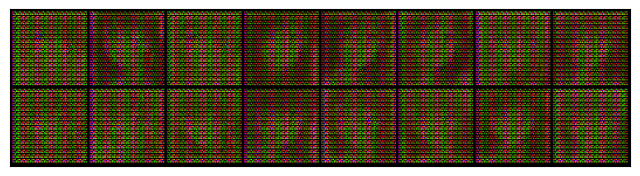

100%|██████████| 1/1 [00:00<00:00,  5.79it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [22/100], loss_g: 0.2692, loss_d: 0.0862, real_score: 0.8172, fake_score: 0.3348


100%|██████████| 1/1 [00:00<00:00,  6.24it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [23/100], loss_g: 0.2775, loss_d: 0.0873, real_score: 0.8172, fake_score: 0.3359


100%|██████████| 1/1 [00:00<00:00,  5.52it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [24/100], loss_g: 0.2607, loss_d: 0.0931, real_score: 0.8172, fake_score: 0.3519


100%|██████████| 1/1 [00:00<00:00,  5.99it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [25/100], loss_g: 0.2767, loss_d: 0.0993, real_score: 0.8172, fake_score: 0.3735


100%|██████████| 1/1 [00:00<00:00,  5.75it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [26/100], loss_g: 0.2921, loss_d: 0.0689, real_score: 0.8172, fake_score: 0.3505


100%|██████████| 1/1 [00:00<00:00,  5.61it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [27/100], loss_g: 0.2436, loss_d: 0.0994, real_score: 0.8172, fake_score: 0.3583


100%|██████████| 1/1 [00:00<00:00,  5.51it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [28/100], loss_g: 0.2176, loss_d: 0.0893, real_score: 0.8172, fake_score: 0.3614


100%|██████████| 1/1 [00:00<00:00,  5.35it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [29/100], loss_g: 0.2324, loss_d: 0.0851, real_score: 0.8172, fake_score: 0.3526


100%|██████████| 1/1 [00:00<00:00,  5.59it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [30/100], loss_g: 0.3224, loss_d: 0.0682, real_score: 0.8172, fake_score: 0.3490


100%|██████████| 1/1 [00:00<00:00,  4.81it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [31/100], loss_g: 0.1753, loss_d: 0.0958, real_score: 0.8172, fake_score: 0.3658
torch.Size([16, 64, 32, 32])
Saving generated-images-0031.png


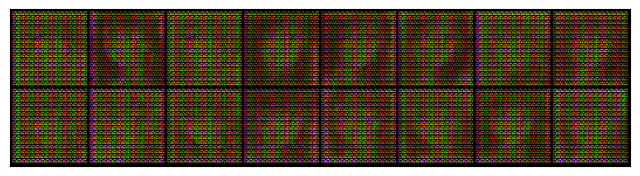

100%|██████████| 1/1 [00:00<00:00,  5.52it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [32/100], loss_g: 0.1855, loss_d: 0.0897, real_score: 0.8172, fake_score: 0.3744


100%|██████████| 1/1 [00:00<00:00,  4.64it/s]

torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [33/100], loss_g: 0.2696, loss_d: 0.0597, real_score: 0.8172, fake_score: 0.3581



100%|██████████| 1/1 [00:00<00:00,  5.51it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [34/100], loss_g: 0.2623, loss_d: 0.0907, real_score: 0.8172, fake_score: 0.3696


100%|██████████| 1/1 [00:00<00:00,  5.89it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [35/100], loss_g: 0.2343, loss_d: 0.1101, real_score: 0.8172, fake_score: 0.3575


100%|██████████| 1/1 [00:00<00:00,  5.33it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [36/100], loss_g: 0.2827, loss_d: 0.0908, real_score: 0.8172, fake_score: 0.3578


100%|██████████| 1/1 [00:00<00:00,  5.21it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [37/100], loss_g: 0.2574, loss_d: 0.0909, real_score: 0.8172, fake_score: 0.3518


100%|██████████| 1/1 [00:00<00:00,  5.01it/s]

torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [38/100], loss_g: 0.1822, loss_d: 0.0787, real_score: 0.8172, fake_score: 0.3406



100%|██████████| 1/1 [00:00<00:00,  5.48it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [39/100], loss_g: 0.2866, loss_d: 0.0848, real_score: 0.8172, fake_score: 0.3556


100%|██████████| 1/1 [00:00<00:00,  5.84it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [40/100], loss_g: 0.2305, loss_d: 0.0670, real_score: 0.8172, fake_score: 0.3484


100%|██████████| 1/1 [00:00<00:00,  5.31it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [41/100], loss_g: 0.2984, loss_d: 0.0835, real_score: 0.8172, fake_score: 0.3597
torch.Size([16, 64, 32, 32])
Saving generated-images-0041.png


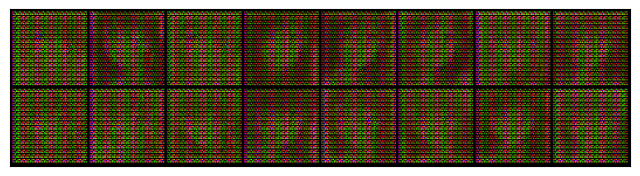

100%|██████████| 1/1 [00:00<00:00,  5.38it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [42/100], loss_g: 0.1939, loss_d: 0.0892, real_score: 0.8172, fake_score: 0.3536


100%|██████████| 1/1 [00:00<00:00,  5.60it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [43/100], loss_g: 0.2426, loss_d: 0.0911, real_score: 0.8172, fake_score: 0.3826


100%|██████████| 1/1 [00:00<00:00,  5.89it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [44/100], loss_g: 0.3253, loss_d: 0.0965, real_score: 0.8172, fake_score: 0.3751


100%|██████████| 1/1 [00:00<00:00,  5.79it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [45/100], loss_g: 0.2558, loss_d: 0.0782, real_score: 0.8172, fake_score: 0.3390


100%|██████████| 1/1 [00:00<00:00,  5.36it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [46/100], loss_g: 0.2526, loss_d: 0.0852, real_score: 0.8172, fake_score: 0.3495


100%|██████████| 1/1 [00:00<00:00,  6.17it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [47/100], loss_g: 0.2961, loss_d: 0.0730, real_score: 0.8172, fake_score: 0.3509


100%|██████████| 1/1 [00:00<00:00,  5.06it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [48/100], loss_g: 0.2829, loss_d: 0.0714, real_score: 0.8172, fake_score: 0.3577


100%|██████████| 1/1 [00:00<00:00,  6.09it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [49/100], loss_g: 0.2801, loss_d: 0.0761, real_score: 0.8172, fake_score: 0.3567


100%|██████████| 1/1 [00:00<00:00,  6.05it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [50/100], loss_g: 0.2867, loss_d: 0.1011, real_score: 0.8172, fake_score: 0.3653


100%|██████████| 1/1 [00:00<00:00,  5.09it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [51/100], loss_g: 0.2573, loss_d: 0.0700, real_score: 0.8172, fake_score: 0.3470
torch.Size([16, 64, 32, 32])
Saving generated-images-0051.png


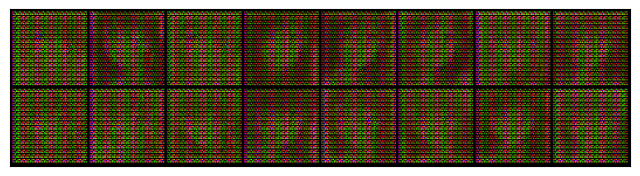

100%|██████████| 1/1 [00:00<00:00,  6.08it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [52/100], loss_g: 0.2923, loss_d: 0.0813, real_score: 0.8172, fake_score: 0.3545


100%|██████████| 1/1 [00:00<00:00,  5.57it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [53/100], loss_g: 0.2861, loss_d: 0.0821, real_score: 0.8172, fake_score: 0.3513


100%|██████████| 1/1 [00:00<00:00,  5.67it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [54/100], loss_g: 0.2916, loss_d: 0.0973, real_score: 0.8172, fake_score: 0.3783


100%|██████████| 1/1 [00:00<00:00,  6.09it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [55/100], loss_g: 0.2148, loss_d: 0.0924, real_score: 0.8172, fake_score: 0.3689


100%|██████████| 1/1 [00:00<00:00,  5.69it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [56/100], loss_g: 0.2721, loss_d: 0.0985, real_score: 0.8172, fake_score: 0.3698


100%|██████████| 1/1 [00:00<00:00,  5.92it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [57/100], loss_g: 0.2962, loss_d: 0.0821, real_score: 0.8172, fake_score: 0.3578


100%|██████████| 1/1 [00:00<00:00,  5.84it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [58/100], loss_g: 0.2278, loss_d: 0.0841, real_score: 0.8172, fake_score: 0.3707


100%|██████████| 1/1 [00:00<00:00,  5.90it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [59/100], loss_g: 0.2655, loss_d: 0.1018, real_score: 0.8172, fake_score: 0.3838


100%|██████████| 1/1 [00:00<00:00,  6.00it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [60/100], loss_g: 0.2457, loss_d: 0.0759, real_score: 0.8172, fake_score: 0.3640


100%|██████████| 1/1 [00:00<00:00,  5.54it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [61/100], loss_g: 0.2067, loss_d: 0.1089, real_score: 0.8172, fake_score: 0.3718
torch.Size([16, 64, 32, 32])
Saving generated-images-0061.png


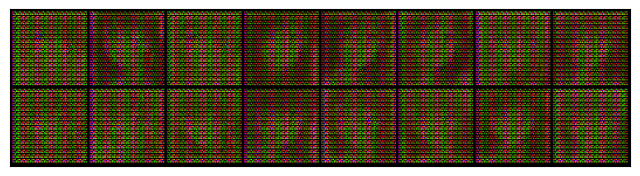

100%|██████████| 1/1 [00:00<00:00,  5.10it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [62/100], loss_g: 0.2498, loss_d: 0.0753, real_score: 0.8172, fake_score: 0.3560


100%|██████████| 1/1 [00:00<00:00,  5.64it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [63/100], loss_g: 0.2565, loss_d: 0.0858, real_score: 0.8172, fake_score: 0.3601


100%|██████████| 1/1 [00:00<00:00,  5.70it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [64/100], loss_g: 0.2948, loss_d: 0.0816, real_score: 0.8172, fake_score: 0.3793


100%|██████████| 1/1 [00:00<00:00,  5.66it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [65/100], loss_g: 0.2290, loss_d: 0.0903, real_score: 0.8172, fake_score: 0.3545


100%|██████████| 1/1 [00:00<00:00,  5.61it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [66/100], loss_g: 0.2731, loss_d: 0.1000, real_score: 0.8172, fake_score: 0.3713


100%|██████████| 1/1 [00:00<00:00,  5.81it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [67/100], loss_g: 0.2615, loss_d: 0.0753, real_score: 0.8172, fake_score: 0.3605


100%|██████████| 1/1 [00:00<00:00,  5.16it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [68/100], loss_g: 0.2477, loss_d: 0.0788, real_score: 0.8172, fake_score: 0.3741


100%|██████████| 1/1 [00:00<00:00,  5.57it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [69/100], loss_g: 0.2313, loss_d: 0.0610, real_score: 0.8172, fake_score: 0.3636


100%|██████████| 1/1 [00:00<00:00,  5.30it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [70/100], loss_g: 0.2740, loss_d: 0.0832, real_score: 0.8172, fake_score: 0.3661


100%|██████████| 1/1 [00:00<00:00,  5.73it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [71/100], loss_g: 0.2406, loss_d: 0.0762, real_score: 0.8172, fake_score: 0.3529
torch.Size([16, 64, 32, 32])
Saving generated-images-0071.png


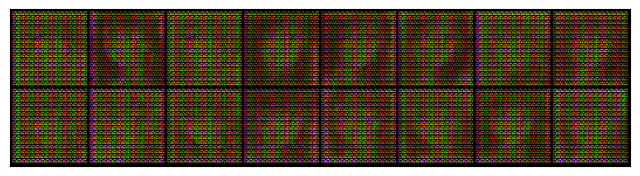

100%|██████████| 1/1 [00:00<00:00,  5.90it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [72/100], loss_g: 0.2550, loss_d: 0.0895, real_score: 0.8172, fake_score: 0.3642


100%|██████████| 1/1 [00:00<00:00,  5.57it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [73/100], loss_g: 0.2654, loss_d: 0.0815, real_score: 0.8172, fake_score: 0.3813


100%|██████████| 1/1 [00:00<00:00,  5.22it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [74/100], loss_g: 0.2007, loss_d: 0.0873, real_score: 0.8172, fake_score: 0.3451


100%|██████████| 1/1 [00:00<00:00,  5.76it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [75/100], loss_g: 0.2503, loss_d: 0.0974, real_score: 0.8172, fake_score: 0.3467


100%|██████████| 1/1 [00:00<00:00,  5.74it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [76/100], loss_g: 0.2584, loss_d: 0.0831, real_score: 0.8172, fake_score: 0.3460


100%|██████████| 1/1 [00:00<00:00,  5.66it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [77/100], loss_g: 0.3002, loss_d: 0.0696, real_score: 0.8172, fake_score: 0.3354


100%|██████████| 1/1 [00:00<00:00,  5.73it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [78/100], loss_g: 0.2731, loss_d: 0.0629, real_score: 0.8172, fake_score: 0.3673


100%|██████████| 1/1 [00:00<00:00,  5.80it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [79/100], loss_g: 0.2914, loss_d: 0.0699, real_score: 0.8172, fake_score: 0.3679


100%|██████████| 1/1 [00:00<00:00,  5.76it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [80/100], loss_g: 0.2433, loss_d: 0.1088, real_score: 0.8172, fake_score: 0.3684


100%|██████████| 1/1 [00:00<00:00,  4.94it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [81/100], loss_g: 0.2730, loss_d: 0.0821, real_score: 0.8172, fake_score: 0.3728
torch.Size([16, 64, 32, 32])
Saving generated-images-0081.png


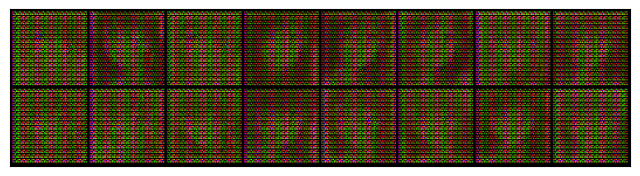

100%|██████████| 1/1 [00:00<00:00,  6.11it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [82/100], loss_g: 0.2403, loss_d: 0.0949, real_score: 0.8172, fake_score: 0.3720


100%|██████████| 1/1 [00:00<00:00,  5.60it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [83/100], loss_g: 0.2665, loss_d: 0.0585, real_score: 0.8172, fake_score: 0.3321


100%|██████████| 1/1 [00:00<00:00,  5.34it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [84/100], loss_g: 0.1837, loss_d: 0.0768, real_score: 0.8172, fake_score: 0.3495


100%|██████████| 1/1 [00:00<00:00,  5.81it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [85/100], loss_g: 0.2735, loss_d: 0.0894, real_score: 0.8172, fake_score: 0.3473


100%|██████████| 1/1 [00:00<00:00,  5.72it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [86/100], loss_g: 0.2697, loss_d: 0.0630, real_score: 0.8172, fake_score: 0.3586


100%|██████████| 1/1 [00:00<00:00,  5.22it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [87/100], loss_g: 0.2835, loss_d: 0.1024, real_score: 0.8172, fake_score: 0.3615


100%|██████████| 1/1 [00:00<00:00,  5.85it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [88/100], loss_g: 0.2396, loss_d: 0.0730, real_score: 0.8172, fake_score: 0.3478


100%|██████████| 1/1 [00:00<00:00,  6.03it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [89/100], loss_g: 0.2142, loss_d: 0.1128, real_score: 0.8172, fake_score: 0.3627


100%|██████████| 1/1 [00:00<00:00,  5.55it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [90/100], loss_g: 0.2741, loss_d: 0.0873, real_score: 0.8172, fake_score: 0.3561


100%|██████████| 1/1 [00:00<00:00,  6.10it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [91/100], loss_g: 0.2841, loss_d: 0.0984, real_score: 0.8172, fake_score: 0.3512
torch.Size([16, 64, 32, 32])
Saving generated-images-0091.png


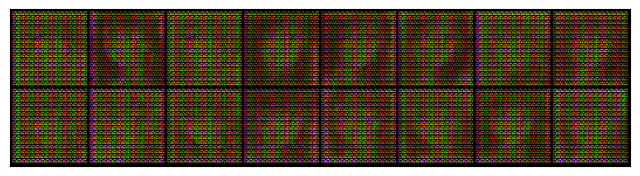

100%|██████████| 1/1 [00:00<00:00,  5.03it/s]

torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [92/100], loss_g: 0.2493, loss_d: 0.0692, real_score: 0.8172, fake_score: 0.3578



100%|██████████| 1/1 [00:00<00:00,  5.65it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [93/100], loss_g: 0.2857, loss_d: 0.0899, real_score: 0.8172, fake_score: 0.3726


100%|██████████| 1/1 [00:00<00:00,  6.01it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [94/100], loss_g: 0.2161, loss_d: 0.0889, real_score: 0.8172, fake_score: 0.3536


100%|██████████| 1/1 [00:00<00:00,  5.65it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [95/100], loss_g: 0.1868, loss_d: 0.0873, real_score: 0.8172, fake_score: 0.3370


100%|██████████| 1/1 [00:00<00:00,  5.53it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [96/100], loss_g: 0.2695, loss_d: 0.0716, real_score: 0.8172, fake_score: 0.3700


100%|██████████| 1/1 [00:00<00:00,  5.81it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [97/100], loss_g: 0.2497, loss_d: 0.0940, real_score: 0.8172, fake_score: 0.3355


100%|██████████| 1/1 [00:00<00:00,  5.39it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [98/100], loss_g: 0.2932, loss_d: 0.0694, real_score: 0.8172, fake_score: 0.3518


100%|██████████| 1/1 [00:00<00:00,  5.62it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [99/100], loss_g: 0.2408, loss_d: 0.0781, real_score: 0.8172, fake_score: 0.3490


100%|██████████| 1/1 [00:00<00:00,  5.86it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [100/100], loss_g: 0.2870, loss_d: 0.1109, real_score: 0.8172, fake_score: 0.3854


In [ ]:
# Complete the training function

losses_g = []
losses_d = []
real_scores = []
fake_scores = []
# Freeze all parameters in the models
for param in generator.parameters():
    param.requires_grad = False
for param in discriminator.parameters():
    param.requires_grad = False
#Define your learning rate
lr=0.0002
opt_g = optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))

# Unfreeze LoRA parameters in the generator
generator.A_matrix.requires_grad = True
generator.B_matrix.requires_grad = True
fixed_latent = torch.randn(16, 128, 1, 1, device=device)
# Move models to the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)

optimizer_g = torch.optim.Adam(filter(lambda p: p.requires_grad, generator.parameters()), lr=0.0002, betas=(0.5, 0.999))
# optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
def train(D, G, d_optimizer, g_optimizer, epochs=1):
    iter_count = 0
    start_idx=1
    for epoch in range(epochs):
        for real_images in tqdm(dataloader):
            real_images=real_images.to(device)
            # Pass real images through discriminator
            D_out_real = D(real_images)
            label_real = torch.full(D_out_real.shape, 1.0).to(torch.device(device))
            real_loss = Real_loss(label_real,D_out_real)
            real_score = torch.mean(D_out_real).item()

            # Generate fake images
            noise = torch.randn(16, latent_size, 1, 1).to(torch.device(device))
            fake_images =  G(noise)

            # Pass fake images through discriminator
            D_out_fake = D(fake_images)
            label_fake =  torch.full(D_out_fake.shape, 0).to(torch.device(device))
            fake_loss = Fake_loss(label_fake, D_out_fake)
            fake_score = torch.mean(D_out_fake).item()

            # Update discriminator weights
            loss_d = real_loss + fake_loss

            d_optimizer.zero_grad()
            # loss_d.backward(retain_graph = True)
            d_optimizer.step()

            # Generate fake images
            noise2 = torch.randn(16, latent_size, 1, 1).to(torch.device(device))
            fake_images2 =  G(noise2)

            gen_steps = 1
            for i in range(0, gen_steps ):
            # Try to fool the discriminator
                D_out_fake2 = D(fake_images2)

                # The label is set to 1(real-like) to fool the discriminator
                label_real1 = torch.full(D_out_fake2.shape, 1.0).to(torch.device(device))
                loss_g = Real_loss(label_real1, D_out_fake2)

                # Update generator weights
                g_optimizer.zero_grad()
                #loss_g.backward(retain_graph = (i<gen_steps -1 ))
                g_optimizer.step()


        losses_g.append(loss_g.item())
        losses_d.append(loss_d.item())
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
        epoch+1, epochs, loss_g, loss_d, real_score, fake_score))

        # Save generated images
        if epoch % 10 == 0:
          save_samples(epoch+start_idx, fixed_latent,G, show=True)

          state_dis = {'dis_model': D.state_dict(), 'epoch': epoch}
          state_gen = {'gen_model': G.state_dict(), 'epoch': epoch}
          if not os.path.isdir('checkpoint'):
              os.mkdir('checkpoint')
          torch.save(state_dis, 'checkpoint/'+'D__'+str(epoch+1)) #each epoch
        torch.save(state_gen, 'checkpoint/'+'G__'+str(epoch+1)) #each epoch
#Train the GAN
train(discriminator,generator,optimizer_d ,optimizer_g,epochs=100)

In [ ]:
class GeneratorWithLoRA(nn.Module):
    def __init__(self, latent_size, lora_rank=100):
        super(GeneratorWithLoRA, self).__init__()
        self.latent_size = latent_size

        self.conv_block1 = nn.Sequential(
            nn.ConvTranspose2d(latent_size, 512, 4, 1, 0),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.ConvTranspose2d(512, 256, 4, 2, 1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, 4, 2, 1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, 4, 2, 1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            # Last layer is now removed from here
        )
        self.final_layer = nn.Sequential(
            nn.ConvTranspose2d(64, 3, 4, 2, 1),
            nn.Tanh()
        )

        # LoRA matrices
        self.A_matrix = nn.Parameter(torch.randn(65536, lora_rank))
        self.B_matrix = nn.Parameter(torch.randn(lora_rank, 12288))

    def apply_lora_projection(self, input, A_matrix, B_matrix):
        flattened_input = input.view(input.size(0), -1)
        lora_transformed = torch.matmul(torch.matmul(flattened_input, A_matrix), B_matrix)
        return lora_transformed

    def forward(self, x):
        # Pass through all layers of conv_block1 except the final layer
        for layer in self.conv_block1:
            x = layer(x)
        print(x.shape)
        # Apply LoRA to the input and add it to the output of the last conv layer
        lora_output = self.apply_lora_projection(x, self.A_matrix, self.B_matrix)

        # Pass through the final layer
        x = self.final_layer(x)
        combined_output = x.view(x.size(0), -1) + lora_output

        # Reshape combined_output to match the shape of the input to the final layer
        combined_output_reshaped = combined_output.view_as(x)

        return x

generator_with_lora = GeneratorWithLoRA(latent_size=128)


In [ ]:
generator_with_lora = GeneratorWithLoRA(latent_size=128, lora_rank=256)

current_state_dict = generator_with_lora.state_dict()
for name, param in checkpoint.items():
    if name in current_state_dict:
        current_state_dict[name].copy_(param)
generator_with_lora.load_state_dict(current_state_dict)
generator = generator_with_lora

In [ ]:
generator.A_matrix

Parameter containing:
tensor([[-0.9692,  1.0098,  0.3317,  ..., -1.5478,  1.3933, -1.1406],
        [-0.6577, -0.1260, -0.6374,  ..., -0.6721,  1.4050, -0.2453],
        [-0.1644, -0.0370, -0.4955,  ..., -1.9374, -1.3275,  0.5519],
        ...,
        [ 0.9430, -0.5998, -0.6543,  ..., -0.2490, -1.6989, -1.0057],
        [ 1.0853, -0.3178,  1.5212,  ..., -1.7350,  0.5518, -2.7756],
        [-0.0699,  0.4115, -0.7000,  ..., -0.3383,  0.1027, -0.2660]],
       device='cuda:0', requires_grad=True)

100%|██████████| 1/1 [00:00<00:00,  5.30it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [1/100], loss_g: 0.0084, loss_d: 0.4654, real_score: 0.8172, fake_score: 0.8499
torch.Size([16, 64, 32, 32])
Saving generated-images-0001.png


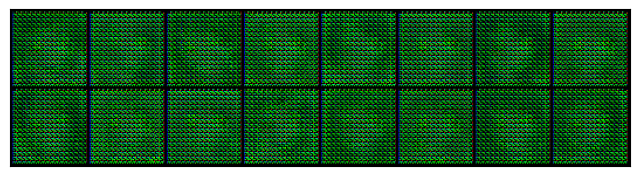

100%|██████████| 1/1 [00:00<00:00,  5.67it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [2/100], loss_g: 0.0138, loss_d: 0.5166, real_score: 0.8172, fake_score: 0.8545


100%|██████████| 1/1 [00:00<00:00,  5.57it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [3/100], loss_g: 0.0158, loss_d: 0.5199, real_score: 0.8172, fake_score: 0.8485


100%|██████████| 1/1 [00:00<00:00,  5.99it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [4/100], loss_g: 0.0140, loss_d: 0.5303, real_score: 0.8172, fake_score: 0.8499


100%|██████████| 1/1 [00:00<00:00,  5.22it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [5/100], loss_g: 0.0208, loss_d: 0.5442, real_score: 0.8172, fake_score: 0.8425


100%|██████████| 1/1 [00:00<00:00,  5.70it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [6/100], loss_g: 0.0279, loss_d: 0.5159, real_score: 0.8172, fake_score: 0.8445


100%|██████████| 1/1 [00:00<00:00,  5.41it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [7/100], loss_g: 0.0295, loss_d: 0.5287, real_score: 0.8172, fake_score: 0.8520


100%|██████████| 1/1 [00:00<00:00,  5.57it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [8/100], loss_g: 0.0277, loss_d: 0.4134, real_score: 0.8172, fake_score: 0.8464


100%|██████████| 1/1 [00:00<00:00,  5.77it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [9/100], loss_g: 0.0167, loss_d: 0.4384, real_score: 0.8172, fake_score: 0.8495


100%|██████████| 1/1 [00:00<00:00,  5.96it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [10/100], loss_g: 0.0151, loss_d: 0.5320, real_score: 0.8172, fake_score: 0.8511


100%|██████████| 1/1 [00:00<00:00,  5.78it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [11/100], loss_g: 0.0200, loss_d: 0.5635, real_score: 0.8172, fake_score: 0.8553
torch.Size([16, 64, 32, 32])


Saving generated-images-0011.png


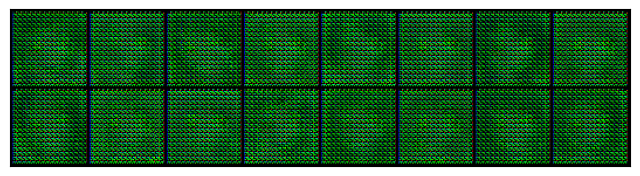

100%|██████████| 1/1 [00:00<00:00,  5.23it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [12/100], loss_g: 0.0297, loss_d: 0.5603, real_score: 0.8172, fake_score: 0.8554


100%|██████████| 1/1 [00:00<00:00,  5.58it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [13/100], loss_g: 0.0182, loss_d: 0.4928, real_score: 0.8172, fake_score: 0.8488


100%|██████████| 1/1 [00:00<00:00,  5.41it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [14/100], loss_g: 0.0228, loss_d: 0.4635, real_score: 0.8172, fake_score: 0.8522


100%|██████████| 1/1 [00:00<00:00,  5.86it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [15/100], loss_g: 0.0123, loss_d: 0.5071, real_score: 0.8172, fake_score: 0.8552


100%|██████████| 1/1 [00:00<00:00,  5.29it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [16/100], loss_g: 0.0068, loss_d: 0.4959, real_score: 0.8172, fake_score: 0.8538


100%|██████████| 1/1 [00:00<00:00,  5.24it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [17/100], loss_g: 0.0146, loss_d: 0.5290, real_score: 0.8172, fake_score: 0.8527


100%|██████████| 1/1 [00:00<00:00,  4.95it/s]

torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [18/100], loss_g: 0.0323, loss_d: 0.4747, real_score: 0.8172, fake_score: 0.8438



100%|██████████| 1/1 [00:00<00:00,  5.75it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [19/100], loss_g: 0.0290, loss_d: 0.4745, real_score: 0.8172, fake_score: 0.8450


100%|██████████| 1/1 [00:00<00:00,  5.13it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [20/100], loss_g: 0.0086, loss_d: 0.5148, real_score: 0.8172, fake_score: 0.8429


100%|██████████| 1/1 [00:00<00:00,  5.43it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [21/100], loss_g: 0.0295, loss_d: 0.5384, real_score: 0.8172, fake_score: 0.8603
torch.Size([16, 64, 32, 32])
Saving generated-images-0021.png


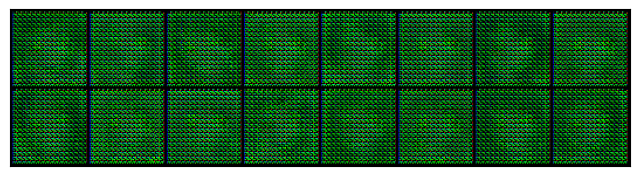

100%|██████████| 1/1 [00:00<00:00,  5.57it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [22/100], loss_g: 0.0540, loss_d: 0.4842, real_score: 0.8172, fake_score: 0.8470


100%|██████████| 1/1 [00:00<00:00,  5.37it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [23/100], loss_g: 0.0278, loss_d: 0.4361, real_score: 0.8172, fake_score: 0.8548


100%|██████████| 1/1 [00:00<00:00,  5.24it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [24/100], loss_g: 0.0104, loss_d: 0.4577, real_score: 0.8172, fake_score: 0.8448


100%|██████████| 1/1 [00:00<00:00,  5.85it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [25/100], loss_g: 0.0076, loss_d: 0.4900, real_score: 0.8172, fake_score: 0.8426


100%|██████████| 1/1 [00:00<00:00,  5.19it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [26/100], loss_g: 0.0067, loss_d: 0.4561, real_score: 0.8172, fake_score: 0.8506


100%|██████████| 1/1 [00:00<00:00,  5.30it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [27/100], loss_g: 0.0436, loss_d: 0.5166, real_score: 0.8172, fake_score: 0.8492


100%|██████████| 1/1 [00:00<00:00,  5.20it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [28/100], loss_g: 0.0247, loss_d: 0.5456, real_score: 0.8172, fake_score: 0.8544


100%|██████████| 1/1 [00:00<00:00,  5.01it/s]

torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [29/100], loss_g: 0.0125, loss_d: 0.5124, real_score: 0.8172, fake_score: 0.8495



100%|██████████| 1/1 [00:00<00:00,  5.15it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [30/100], loss_g: 0.0068, loss_d: 0.5467, real_score: 0.8172, fake_score: 0.8499


100%|██████████| 1/1 [00:00<00:00,  5.51it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [31/100], loss_g: 0.0122, loss_d: 0.4375, real_score: 0.8172, fake_score: 0.8456
torch.Size([16, 64, 32, 32])
Saving generated-images-0031.png


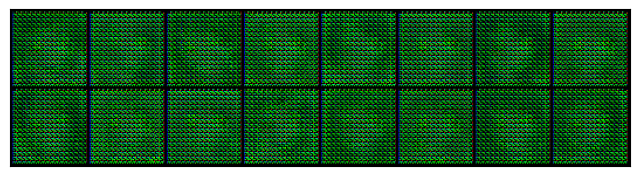

100%|██████████| 1/1 [00:00<00:00,  4.90it/s]

torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [32/100], loss_g: 0.0181, loss_d: 0.4526, real_score: 0.8172, fake_score: 0.8453



100%|██████████| 1/1 [00:00<00:00,  5.70it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [33/100], loss_g: 0.0120, loss_d: 0.5181, real_score: 0.8172, fake_score: 0.8462


100%|██████████| 1/1 [00:00<00:00,  5.64it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [34/100], loss_g: 0.0202, loss_d: 0.4642, real_score: 0.8172, fake_score: 0.8492


100%|██████████| 1/1 [00:00<00:00,  5.62it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [35/100], loss_g: 0.0238, loss_d: 0.4672, real_score: 0.8172, fake_score: 0.8507


100%|██████████| 1/1 [00:00<00:00,  5.71it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [36/100], loss_g: 0.0206, loss_d: 0.5395, real_score: 0.8172, fake_score: 0.8531


100%|██████████| 1/1 [00:00<00:00,  5.54it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [37/100], loss_g: 0.0509, loss_d: 0.4526, real_score: 0.8172, fake_score: 0.8462


100%|██████████| 1/1 [00:00<00:00,  5.27it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [38/100], loss_g: 0.0104, loss_d: 0.5936, real_score: 0.8172, fake_score: 0.8524


100%|██████████| 1/1 [00:00<00:00,  5.57it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [39/100], loss_g: 0.0350, loss_d: 0.5207, real_score: 0.8172, fake_score: 0.8492


100%|██████████| 1/1 [00:00<00:00,  5.43it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [40/100], loss_g: 0.0138, loss_d: 0.4806, real_score: 0.8172, fake_score: 0.8507


100%|██████████| 1/1 [00:00<00:00,  5.47it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [41/100], loss_g: 0.0280, loss_d: 0.4994, real_score: 0.8172, fake_score: 0.8502
torch.Size([16, 64, 32, 32])
Saving generated-images-0041.png


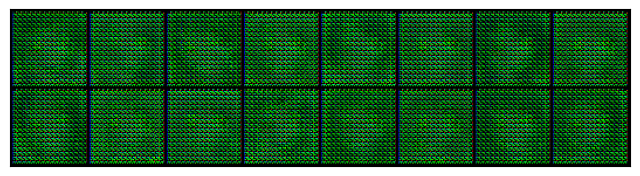

100%|██████████| 1/1 [00:00<00:00,  5.73it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [42/100], loss_g: 0.0138, loss_d: 0.4984, real_score: 0.8172, fake_score: 0.8429


100%|██████████| 1/1 [00:00<00:00,  5.55it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [43/100], loss_g: 0.0098, loss_d: 0.5304, real_score: 0.8172, fake_score: 0.8527


100%|██████████| 1/1 [00:00<00:00,  5.67it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [44/100], loss_g: 0.0229, loss_d: 0.5930, real_score: 0.8172, fake_score: 0.8531


100%|██████████| 1/1 [00:00<00:00,  5.85it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [45/100], loss_g: 0.0097, loss_d: 0.5114, real_score: 0.8172, fake_score: 0.8469


100%|██████████| 1/1 [00:00<00:00,  4.96it/s]

torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [46/100], loss_g: 0.0290, loss_d: 0.5200, real_score: 0.8172, fake_score: 0.8505



100%|██████████| 1/1 [00:00<00:00,  5.70it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [47/100], loss_g: 0.0129, loss_d: 0.5170, real_score: 0.8172, fake_score: 0.8471


100%|██████████| 1/1 [00:00<00:00,  5.81it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [48/100], loss_g: 0.0290, loss_d: 0.3951, real_score: 0.8172, fake_score: 0.8511


100%|██████████| 1/1 [00:00<00:00,  5.80it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [49/100], loss_g: 0.0150, loss_d: 0.5874, real_score: 0.8172, fake_score: 0.8483


100%|██████████| 1/1 [00:00<00:00,  5.89it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [50/100], loss_g: 0.0260, loss_d: 0.4706, real_score: 0.8172, fake_score: 0.8575


100%|██████████| 1/1 [00:00<00:00,  4.93it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [51/100], loss_g: 0.0166, loss_d: 0.5276, real_score: 0.8172, fake_score: 0.8531
torch.Size([16, 64, 32, 32])
Saving generated-images-0051.png


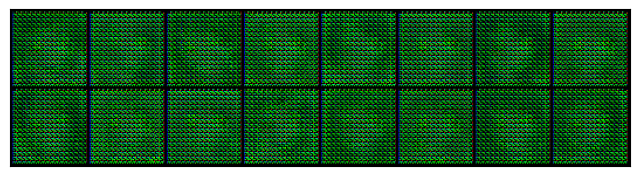

100%|██████████| 1/1 [00:00<00:00,  5.22it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [52/100], loss_g: 0.0168, loss_d: 0.5158, real_score: 0.8172, fake_score: 0.8445


100%|██████████| 1/1 [00:00<00:00,  5.84it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [53/100], loss_g: 0.0108, loss_d: 0.4762, real_score: 0.8172, fake_score: 0.8533


100%|██████████| 1/1 [00:00<00:00,  5.22it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [54/100], loss_g: 0.0116, loss_d: 0.5683, real_score: 0.8172, fake_score: 0.8519


100%|██████████| 1/1 [00:00<00:00,  5.90it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [55/100], loss_g: 0.0081, loss_d: 0.5776, real_score: 0.8172, fake_score: 0.8533


100%|██████████| 1/1 [00:00<00:00,  5.11it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [56/100], loss_g: 0.0257, loss_d: 0.5524, real_score: 0.8172, fake_score: 0.8526


100%|██████████| 1/1 [00:00<00:00,  5.29it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [57/100], loss_g: 0.0254, loss_d: 0.5605, real_score: 0.8172, fake_score: 0.8567


100%|██████████| 1/1 [00:00<00:00,  6.06it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [58/100], loss_g: 0.0164, loss_d: 0.5139, real_score: 0.8172, fake_score: 0.8380


100%|██████████| 1/1 [00:00<00:00,  5.13it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [59/100], loss_g: 0.0344, loss_d: 0.5049, real_score: 0.8172, fake_score: 0.8618


100%|██████████| 1/1 [00:00<00:00,  5.95it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [60/100], loss_g: 0.0189, loss_d: 0.4389, real_score: 0.8172, fake_score: 0.8449


100%|██████████| 1/1 [00:00<00:00,  5.86it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [61/100], loss_g: 0.0268, loss_d: 0.5236, real_score: 0.8172, fake_score: 0.8489
torch.Size([16, 64, 32, 32])
Saving generated-images-0061.png


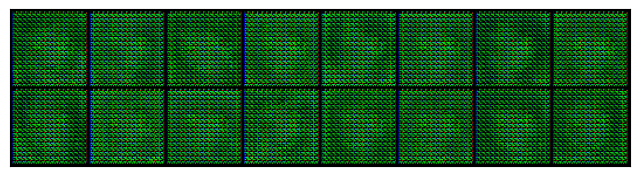

100%|██████████| 1/1 [00:00<00:00,  5.87it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [62/100], loss_g: 0.0466, loss_d: 0.5215, real_score: 0.8172, fake_score: 0.8435


100%|██████████| 1/1 [00:00<00:00,  5.66it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [63/100], loss_g: 0.0311, loss_d: 0.4649, real_score: 0.8172, fake_score: 0.8561


100%|██████████| 1/1 [00:00<00:00,  5.80it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [64/100], loss_g: 0.0248, loss_d: 0.4825, real_score: 0.8172, fake_score: 0.8456


100%|██████████| 1/1 [00:00<00:00,  5.58it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [65/100], loss_g: 0.0139, loss_d: 0.5237, real_score: 0.8172, fake_score: 0.8574


100%|██████████| 1/1 [00:00<00:00,  5.52it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [66/100], loss_g: 0.0050, loss_d: 0.3933, real_score: 0.8172, fake_score: 0.8501


100%|██████████| 1/1 [00:00<00:00,  5.71it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [67/100], loss_g: 0.0289, loss_d: 0.4965, real_score: 0.8172, fake_score: 0.8467


100%|██████████| 1/1 [00:00<00:00,  5.85it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [68/100], loss_g: 0.0545, loss_d: 0.4680, real_score: 0.8172, fake_score: 0.8504


100%|██████████| 1/1 [00:00<00:00,  5.66it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [69/100], loss_g: 0.0417, loss_d: 0.4391, real_score: 0.8172, fake_score: 0.8460


100%|██████████| 1/1 [00:00<00:00,  5.69it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [70/100], loss_g: 0.0299, loss_d: 0.4692, real_score: 0.8172, fake_score: 0.8544


100%|██████████| 1/1 [00:00<00:00,  5.60it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [71/100], loss_g: 0.0148, loss_d: 0.4603, real_score: 0.8172, fake_score: 0.8450
torch.Size([16, 64, 32, 32])
Saving generated-images-0071.png


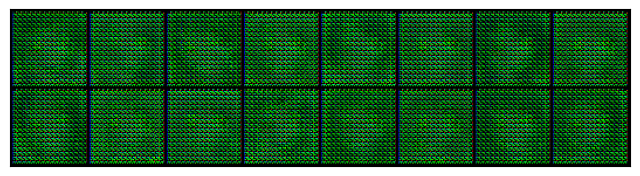

100%|██████████| 1/1 [00:00<00:00,  4.97it/s]

torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [72/100], loss_g: 0.0117, loss_d: 0.5399, real_score: 0.8172, fake_score: 0.8569



100%|██████████| 1/1 [00:00<00:00,  5.71it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [73/100], loss_g: 0.0342, loss_d: 0.5305, real_score: 0.8172, fake_score: 0.8527


100%|██████████| 1/1 [00:00<00:00,  5.75it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [74/100], loss_g: 0.0157, loss_d: 0.4991, real_score: 0.8172, fake_score: 0.8449


100%|██████████| 1/1 [00:00<00:00,  4.94it/s]

torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [75/100], loss_g: 0.0139, loss_d: 0.5587, real_score: 0.8172, fake_score: 0.8507



100%|██████████| 1/1 [00:00<00:00,  5.86it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [76/100], loss_g: 0.0162, loss_d: 0.4669, real_score: 0.8172, fake_score: 0.8472


100%|██████████| 1/1 [00:00<00:00,  5.89it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [77/100], loss_g: 0.0294, loss_d: 0.4880, real_score: 0.8172, fake_score: 0.8434


100%|██████████| 1/1 [00:00<00:00,  5.27it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [78/100], loss_g: 0.0187, loss_d: 0.5044, real_score: 0.8172, fake_score: 0.8506


100%|██████████| 1/1 [00:00<00:00,  5.27it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [79/100], loss_g: 0.0152, loss_d: 0.4888, real_score: 0.8172, fake_score: 0.8455


100%|██████████| 1/1 [00:00<00:00,  4.85it/s]

torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [80/100], loss_g: 0.0468, loss_d: 0.5329, real_score: 0.8172, fake_score: 0.8503



100%|██████████| 1/1 [00:00<00:00,  5.74it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [81/100], loss_g: 0.0076, loss_d: 0.4947, real_score: 0.8172, fake_score: 0.8472
torch.Size([16, 64, 32, 32])
Saving generated-images-0081.png


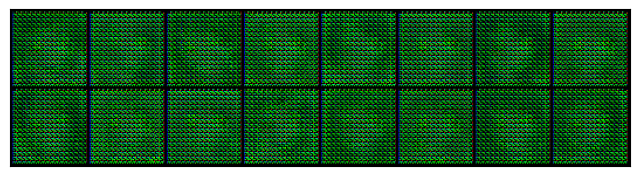

100%|██████████| 1/1 [00:00<00:00,  5.40it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [82/100], loss_g: 0.0295, loss_d: 0.5742, real_score: 0.8172, fake_score: 0.8475


100%|██████████| 1/1 [00:00<00:00,  4.72it/s]

torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [83/100], loss_g: 0.0249, loss_d: 0.4807, real_score: 0.8172, fake_score: 0.8542



100%|██████████| 1/1 [00:00<00:00,  5.02it/s]

torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [84/100], loss_g: 0.0303, loss_d: 0.4913, real_score: 0.8172, fake_score: 0.8460



100%|██████████| 1/1 [00:00<00:00,  5.39it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [85/100], loss_g: 0.0287, loss_d: 0.4728, real_score: 0.8172, fake_score: 0.8584


100%|██████████| 1/1 [00:00<00:00,  5.01it/s]

torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [86/100], loss_g: 0.0199, loss_d: 0.4921, real_score: 0.8172, fake_score: 0.8452



100%|██████████| 1/1 [00:00<00:00,  5.54it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [87/100], loss_g: 0.0281, loss_d: 0.5091, real_score: 0.8172, fake_score: 0.8525


100%|██████████| 1/1 [00:00<00:00,  5.60it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [88/100], loss_g: 0.0255, loss_d: 0.5649, real_score: 0.8172, fake_score: 0.8509


100%|██████████| 1/1 [00:00<00:00,  5.18it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [89/100], loss_g: 0.0127, loss_d: 0.5254, real_score: 0.8172, fake_score: 0.8542


100%|██████████| 1/1 [00:00<00:00,  5.75it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [90/100], loss_g: 0.0586, loss_d: 0.4459, real_score: 0.8172, fake_score: 0.8436


100%|██████████| 1/1 [00:00<00:00,  5.20it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [91/100], loss_g: 0.0461, loss_d: 0.4181, real_score: 0.8172, fake_score: 0.8559
torch.Size([16, 64, 32, 32])
Saving generated-images-0091.png


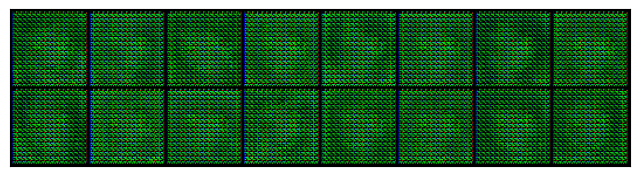

100%|██████████| 1/1 [00:00<00:00,  4.94it/s]

torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [92/100], loss_g: 0.0119, loss_d: 0.4723, real_score: 0.8172, fake_score: 0.8586



100%|██████████| 1/1 [00:00<00:00,  5.75it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [93/100], loss_g: 0.0193, loss_d: 0.5285, real_score: 0.8172, fake_score: 0.8431


100%|██████████| 1/1 [00:00<00:00,  5.95it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [94/100], loss_g: 0.0159, loss_d: 0.5126, real_score: 0.8172, fake_score: 0.8548


100%|██████████| 1/1 [00:00<00:00,  5.75it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [95/100], loss_g: 0.0160, loss_d: 0.5799, real_score: 0.8172, fake_score: 0.8436


100%|██████████| 1/1 [00:00<00:00,  5.14it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [96/100], loss_g: 0.0105, loss_d: 0.5591, real_score: 0.8172, fake_score: 0.8456


100%|██████████| 1/1 [00:00<00:00,  5.78it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [97/100], loss_g: 0.0375, loss_d: 0.6010, real_score: 0.8172, fake_score: 0.8543


100%|██████████| 1/1 [00:00<00:00,  6.00it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [98/100], loss_g: 0.0207, loss_d: 0.5213, real_score: 0.8172, fake_score: 0.8551


100%|██████████| 1/1 [00:00<00:00,  5.72it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [99/100], loss_g: 0.0152, loss_d: 0.4994, real_score: 0.8172, fake_score: 0.8472


100%|██████████| 1/1 [00:00<00:00,  5.39it/s]


torch.Size([16, 64, 32, 32])
torch.Size([16, 64, 32, 32])
Epoch [100/100], loss_g: 0.0070, loss_d: 0.6332, real_score: 0.8172, fake_score: 0.8572


In [ ]:
# Complete the training function

losses_g = []
losses_d = []
real_scores = []
fake_scores = []
# Freeze all parameters in the models
for param in generator.parameters():
    param.requires_grad = False
for param in discriminator.parameters():
    param.requires_grad = False
#Define your learning rate
lr=0.0002
opt_g = optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))

# Unfreeze LoRA parameters in the generator
generator.A_matrix.requires_grad = True
generator.B_matrix.requires_grad = True
fixed_latent = torch.randn(16, 128, 1, 1, device=device)
# Move models to the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)

optimizer_g = torch.optim.Adam(filter(lambda p: p.requires_grad, generator.parameters()), lr=0.0002, betas=(0.5, 0.999))
optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
def train(D, G, d_optimizer, g_optimizer, epochs=1):
    iter_count = 0
    start_idx=1
    for epoch in range(epochs):
        for real_images in tqdm(dataloader):
            real_images=real_images.to(device)
            # Pass real images through discriminator
            D_out_real = D(real_images)
            label_real = torch.full(D_out_real.shape, 1.0).to(torch.device(device))
            real_loss = Real_loss(label_real,D_out_real)
            real_score = torch.mean(D_out_real).item()

            # Generate fake images
            noise = torch.randn(16, latent_size, 1, 1).to(torch.device(device))
            fake_images =  G(noise)

            # Pass fake images through discriminator
            D_out_fake = D(fake_images)
            label_fake =  torch.full(D_out_fake.shape, 0).to(torch.device(device))
            fake_loss = Fake_loss(label_fake, D_out_fake)
            fake_score = torch.mean(D_out_fake).item()

            # Update discriminator weights
            loss_d = real_loss + fake_loss

            d_optimizer.zero_grad()
            #loss_d.backward(retain_graph = True)
            d_optimizer.step()

            # Generate fake images
            noise2 = torch.randn(16, latent_size, 1, 1).to(torch.device(device))
            fake_images2 =  G(noise2)

            gen_steps = 1
            for i in range(0, gen_steps ):
            # Try to fool the discriminator
                D_out_fake2 = D(fake_images2)

                # The label is set to 1(real-like) to fool the discriminator
                label_real1 = torch.full(D_out_fake2.shape, 1.0).to(torch.device(device))
                loss_g = Real_loss(label_real1, D_out_fake2)
                D_out_fake2.detach()

                # Update generator weights
                g_optimizer.zero_grad()
                loss_g.backward()
                g_optimizer.step()


        losses_g.append(loss_g.item())
        losses_d.append(loss_d.item())
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
        epoch+1, epochs, loss_g, loss_d, real_score, fake_score))

        # Save generated images
        if epoch % 10 == 0:
          save_samples(epoch+start_idx, fixed_latent,G, show=True)

          state_dis = {'dis_model': D.state_dict(), 'epoch': epoch}
          state_gen = {'gen_model': G.state_dict(), 'epoch': epoch}
          if not os.path.isdir('checkpoint'):
              os.mkdir('checkpoint')
          torch.save(state_dis, 'checkpoint/'+'D__'+str(epoch+1)) #each epoch
        torch.save(state_gen, 'checkpoint/'+'G__'+str(epoch+1)) #each epoch
#Train the GAN
train(discriminator,generator,optimizer_d ,optimizer_g,epochs=100)

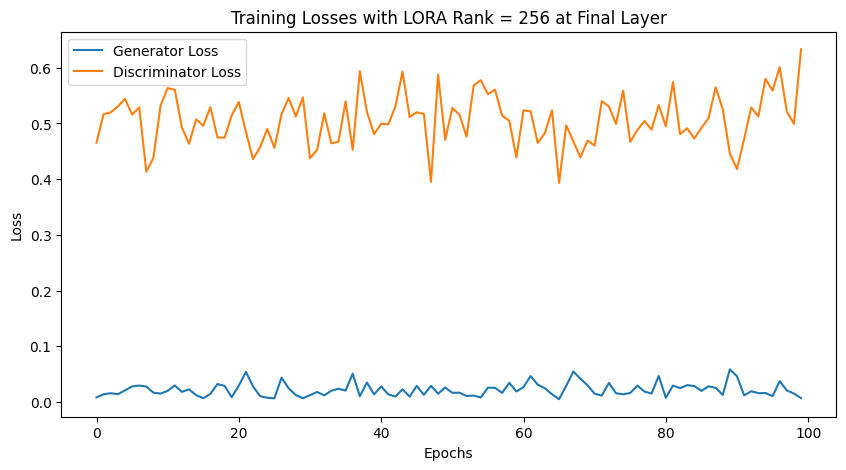

In [ ]:
import matplotlib.pyplot as plt

# Assuming losses_g and losses_d are populated with loss values from each epoch
plt.figure(figsize=(10, 5))

# Plotting Generator loss
plt.plot(losses_g, label='Generator Loss')

# Plotting Discriminator loss
plt.plot(losses_d, label='Discriminator Loss')

# Adding titles and labels
plt.title('Training Losses with LORA Rank = 256 at Final Layer')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Displaying the plot
plt.show()


In [ ]:
# inducing males anime pictures:
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import os

class AnimeFaceDataset(Dataset):
    def __init__(self, directory, num_images=None, transform=None):
        self.directory = directory
        self.transform = transform
        self.images = os.listdir(directory)
        if num_images is not None:
            self.images = self.images[:num_images]

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_name = os.path.join(self.directory, self.images[idx])
        image = Image.open(img_name)
        if self.transform:
            image = self.transform(image)
        return image

transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor(),
])

# Load only 50 images
num_images_to_load = 50
dataset = AnimeFaceDataset(directory='/content/drive/MyDrive/CS182-Research/MaleCharacterDALLE', num_images=num_images_to_load, transform=transform)
dataloader = DataLoader(dataset, batch_size=16, shuffle=True)


In [ ]:
generator_pretrained = Generator(latent_size=128)

current_state_dict = generator_pretrained.state_dict()
for name, param in checkpoint.items():
    if name in current_state_dict:
        current_state_dict[name].copy_(param)
generator_pretrained.load_state_dict(current_state_dict)
generator = generator_pretrained

100%|██████████| 4/4 [00:00<00:00, 20.37it/s]


Saving generated-images-0001.png


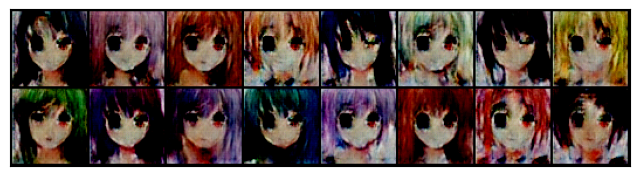

100%|██████████| 4/4 [00:00<00:00, 20.74it/s]


Saving generated-images-0011.png


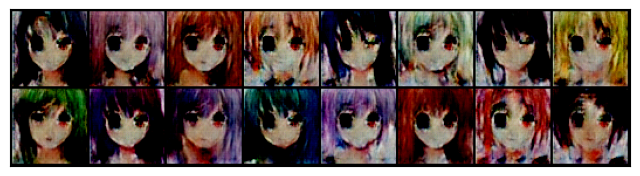

100%|██████████| 4/4 [00:00<00:00, 20.49it/s]


Saving generated-images-0021.png


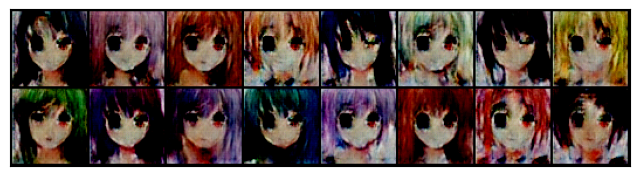

100%|██████████| 4/4 [00:00<00:00, 21.08it/s]


Saving generated-images-0031.png


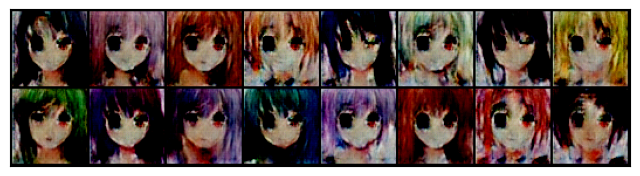

100%|██████████| 4/4 [00:00<00:00, 22.34it/s]


Saving generated-images-0041.png


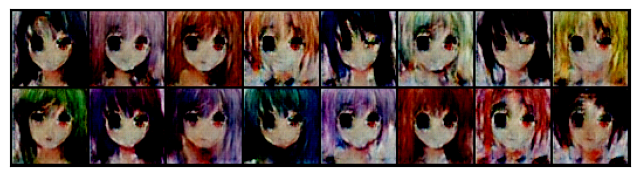

100%|██████████| 4/4 [00:00<00:00, 20.28it/s]


Saving generated-images-0051.png


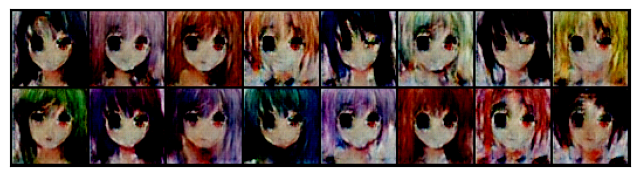

100%|██████████| 4/4 [00:00<00:00, 20.97it/s]


Saving generated-images-0061.png


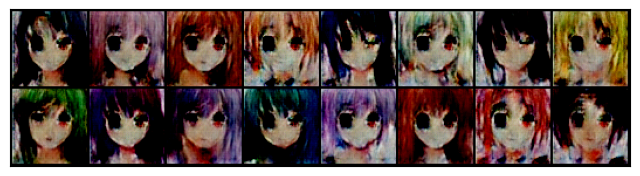

100%|██████████| 4/4 [00:00<00:00, 21.23it/s]


Saving generated-images-0071.png


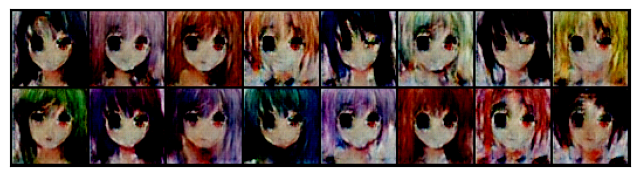

100%|██████████| 4/4 [00:00<00:00, 21.88it/s]


Saving generated-images-0081.png


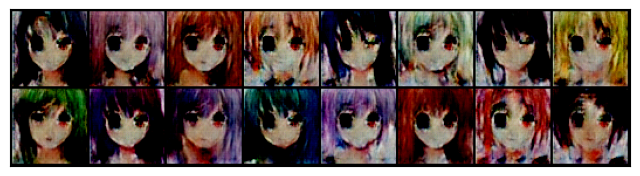

100%|██████████| 4/4 [00:00<00:00, 21.79it/s]


Saving generated-images-0091.png


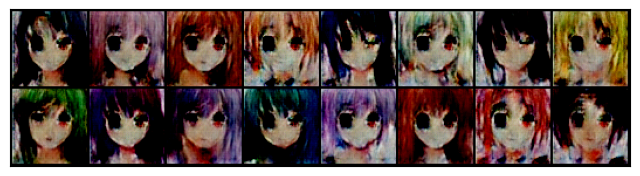

100%|██████████| 4/4 [00:00<00:00, 20.65it/s]


In [ ]:
# Complete the training function

losses_g = []
losses_d = []
real_scores = []
fake_scores = []
# Freeze all parameters in the models
for param in generator.parameters():
    param.requires_grad = False
for param in discriminator.parameters():
    param.requires_grad = False
#Define your learning rate
lr=0.0002
opt_g = optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))

fixed_latent = torch.randn(16, 128, 1, 1, device=device)
# Move models to the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)

optimizer_g = torch.optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
def train(D, G, d_optimizer, g_optimizer, epochs=1):
    iter_count = 0
    start_idx=1
    for epoch in range(epochs):
        for fake_images in tqdm(dataloader):
            fake_images=fake_images.to(device)

            # Pass fake images through discriminator
            D_out_fake = D(fake_images)
            label_fake =  torch.full(D_out_fake.shape, 0).to(torch.device(device))
            fake_loss = Fake_loss(label_fake, D_out_fake)
            fake_score = torch.mean(D_out_fake).item()

            # Update discriminator weights
            loss_d = fake_loss

            d_optimizer.zero_grad()
            #loss_d.backward(retain_graph = True)
            d_optimizer.step()

            # Generate fake images
            noise2 = torch.randn(16, latent_size, 1, 1).to(torch.device(device))
            fake_images2 =  G(noise2)

            gen_steps = 1
            for i in range(0, gen_steps ):
            # Try to fool the discriminator
                D_out_fake2 = D(fake_images2)

                # The label is set to 1(real-like) to fool the discriminator
                label_real1 = torch.full(D_out_fake2.shape, 1.0).to(torch.device(device))
                loss_g = Real_loss(label_real1, D_out_fake2)
                D_out_fake2.detach()

                # Update generator weights
                g_optimizer.zero_grad()
                loss_g.backward()
                g_optimizer.step()


        losses_g.append(loss_g.item())
        losses_d.append(loss_d.item())
        #real_scores.append(real_score)
        fake_scores.append(fake_score)
        # Log losses & scores (last batch)
        #print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
        #epoch+1, epochs, loss_g, loss_d, real_score, fake_score))

        # Save generated images
        if epoch % 10 == 0:
          save_samples(epoch+start_idx, fixed_latent,G, show=True)

          state_dis = {'dis_model': D.state_dict(), 'epoch': epoch}
          state_gen = {'gen_model': G.state_dict(), 'epoch': epoch}
          if not os.path.isdir('checkpoint'):
              os.mkdir('checkpoint')
          torch.save(state_dis, 'checkpoint/'+'D__'+str(epoch+1)) #each epoch
        torch.save(state_gen, 'checkpoint/'+'G__'+str(epoch+1)) #each epoch
#Train the GAN
train(discriminator,generator,optimizer_d ,optimizer_g,epochs=100)

bigGAN + toymodel

In [ ]:
model = BigGAN.from_pretrained('biggan-deep-128')


In [ ]:
noise = torch.randn(16, latent_size, 1, 1).to(torch.device(device))


In [ ]:
!pip install tqdm
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


In [ ]:
discriminator.train()

Discriminator(
  (conv_block1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2, inplace=True)
    (12): Conv2d(512, 1, kernel_size=(4, 4), stride=(2, 2))
    (13): Flatten(s

In [ ]:
generator.train()

Generator(
  (conv_block1): Sequential(
    (0): ConvTranspose2d(128, 512, kernel_size=(4, 4), stride=(1, 1))
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU()
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (13): Tanh()
  )
)

In [ ]:
!pip install tqdm
dataloader = DataLoader(dataset, batch_size=16, shuffle=True)


In [ ]:
# Complete the training function
import tqdm

losses_g = []
losses_d = []
real_scores = []
fake_scores = []
# Freeze all parameters in the models
for param in generator.parameters():
    param.requires_grad = False
for param in discriminator.parameters():
    param.requires_grad = False
#Define your learning rate
lr=0.0002
opt_g = optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))

fixed_latent = torch.randn(16, 128, 1, 1, device=device)
# Move models to the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)

optimizer_d = torch.optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
def train(D, G, d_optimizer, g_optimizer, epochs=1):
    iter_count = 0
    start_idx=1
    for epoch in range(epochs):
        for real_images in dataloader:
            real_images=real_images.to(device)
            # Pass real images through discriminator
            D_out_real = D(real_images)
            label_real = torch.full(D_out_real.shape, 1.0).to(torch.device(device))
            real_loss = Real_loss(label_real,D_out_real)
            real_score = torch.mean(D_out_real).item()

            # Generate fake images
            noise = torch.randn(16, latent_size, 1, 1).to(torch.device(device))
            fake_images =  G(noise)

            # Pass fake images through discriminator
            D_out_fake = D(fake_images)
            label_fake =  torch.full(D_out_fake.shape, 0).to(torch.device(device))
            fake_loss = Fake_loss(label_fake, D_out_fake)
            fake_score = torch.mean(D_out_fake).item()

            # Update discriminator weights
            loss_d = real_loss + fake_loss

            d_optimizer.zero_grad()
            #loss_d.backward(retain_graph = True)
            d_optimizer.step()

            # Generate fake images
            noise2 = torch.randn(16, latent_size, 1, 1).to(torch.device(device))
            fake_images2 =  G(noise2)

            gen_steps = 1
            for i in range(0, gen_steps ):
            # Try to fool the discriminator
                D_out_fake2 = D(fake_images2)

                # The label is set to 1(real-like) to fool the discriminator
                label_real1 = torch.full(D_out_fake2.shape, 1.0).to(torch.device(device))
                loss_g = Real_loss(label_real1, D_out_fake2)
                D_out_fake2.detach()

                # Update generator weights
                g_optimizer.zero_grad()
                loss_g.backward()
                g_optimizer.step()


        losses_g.append(loss_g.item())
        losses_d.append(loss_d.item())
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
        epoch+1, epochs, loss_g, loss_d, real_score, fake_score))

        # Save generated images
        if epoch % 10 == 0:
          save_samples(epoch+start_idx, fixed_latent,G, show=True)

          state_dis = {'dis_model': D.state_dict(), 'epoch': epoch}
          state_gen = {'gen_model': G.state_dict(), 'epoch': epoch}
          if not os.path.isdir('checkpoint'):
              os.mkdir('checkpoint')
          torch.save(state_dis, 'checkpoint/'+'D__'+str(epoch+1)) #each epoch
        torch.save(state_gen, 'checkpoint/'+'G__'+str(epoch+1)) #each epoch
#Train the GAN
train(discriminator,generator,optimizer_d ,optimizer_g,epochs=100)

KeyboardInterrupt: ignored

In [ ]:
# Example usage
original_model = model # Load your pre-trained BigGAN model
modified_model = ModifiedBigGAN(original_model)

# Generate noise
noise_dim = 256  # Adjust as needed
noise = torch.randn(1, noise_dim)

# Create class vector for "anime" class
# Assuming "anime" is the first new class added
anime_class_index = 1000 # Index for the new "anime" class
class_vector = torch.zeros(1, 1001)  # Adjust size for the number of classes
class_vector[0, anime_class_index] = 1  # Set "anime" class to 1

# Generate images for "anime" class
truncation = 0.4
# Generate an image
with torch.no_grad():
  fake_images = modified_model(noise, class_vector, truncation)

In [ ]:
noise = torch.randn(16, latent_size, 1, 1).to(torch.device(device))
generator(noise)

tensor([[[[ 0.5508,  0.5629,  0.5909,  ...,  0.7068,  0.7356,  0.6895],
          [ 0.5492,  0.5315,  0.6395,  ...,  0.7005,  0.7968,  0.7401],
          [ 0.6008,  0.5444,  0.6204,  ...,  0.6667,  0.7725,  0.7555],
          ...,
          [ 0.6761,  0.4970,  0.4632,  ...,  0.4271,  0.5457,  0.5561],
          [ 0.6462,  0.4784,  0.5310,  ...,  0.4080,  0.4648,  0.5847],
          [ 0.6443,  0.5543,  0.5242,  ...,  0.5147,  0.4711,  0.5849]],

         [[ 0.2945,  0.2934,  0.2211,  ...,  0.5466,  0.6276,  0.6398],
          [ 0.2639,  0.2165,  0.3456,  ...,  0.4967,  0.6563,  0.6349],
          [ 0.3664,  0.2306,  0.3470,  ...,  0.4928,  0.6111,  0.6193],
          ...,
          [ 0.7356,  0.5695,  0.5123,  ...,  0.3439,  0.4627,  0.5904],
          [ 0.7811,  0.6087,  0.5593,  ...,  0.3697,  0.4021,  0.5304],
          [ 0.6172,  0.6279,  0.5493,  ...,  0.4428,  0.4864,  0.4495]],

         [[ 0.2718,  0.1504,  0.1077,  ...,  0.4219,  0.5123,  0.5268],
          [ 0.2316,  0.1193,  

In [ ]:
noise.shape

torch.Size([16, 128, 1, 1])

torch.Size([1, 3, 128, 128])